<a href="https://colab.research.google.com/github/kaguya-hiko/MLL_automation/blob/main/auto_mation_MLL_program.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## import

0

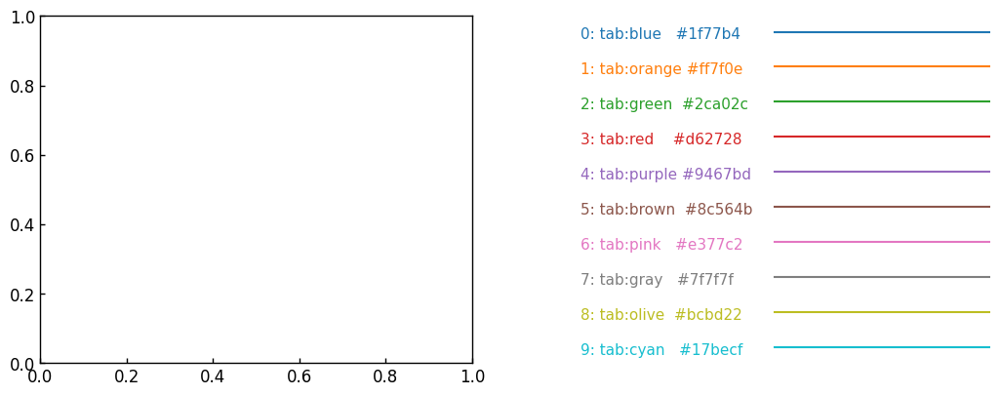

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import glob
import pandas as pd
import os

import time
import datetime

from matplotlib import colors as mcolors
from scipy.optimize import curve_fit

import nidaqmx
from tqdm import tqdm
import pyvisa

from PIL import Image
import io
import pathlib

from ctypes import windll

# graph std demo
plt.rcParams['font.family'] ='sans-serif'#使用するフォント
plt.rcParams['xtick.direction'] = 'in'#x軸の目盛線が内向き('in')か外向き('out')か双方向か('inout')
plt.rcParams['ytick.direction'] = 'in'#y軸の目盛線が内向き('in')か外向き('out')か双方向か('inout')
plt.rcParams['xtick.major.width'] = 1.0#x軸主目盛り線の線幅
plt.rcParams['ytick.major.width'] = 1.0#y軸主目盛り線の線幅
plt.rcParams['font.size'] = 12 #フォントの大きさ
plt.rcParams['axes.linewidth'] = 1.0# 軸の線幅edge linewidth。囲みの太さ
plt.rcParams['figure.dpi'] = 100

# plt.style.use('dark_background')

# plt.figure(figsize=(3.14*2,3.14*1.5))
fig, ax = plt.subplots(1,2,figsize=(np.pi*4,np.pi*1.5))
plt.gca().yaxis.set_major_formatter(plt.FormatStrFormatter('%.3f'))#y軸小数点以下3桁表示
plt.gca().xaxis.get_major_formatter().set_useOffset(False)
plt.gca().yaxis.set_major_locator(ticker.MaxNLocator(integer=True))
plt.locator_params(axis='y',nbins=6)#y軸，6個以内．
plt.gca().yaxis.set_tick_params(which='both', direction='in',bottom=True, top=True, left=True, right=True)
#plt.contour(cmap='viridis') # viridisの配色で等高線を描く

data = np.linspace(0, 2, 10)
for i, (cname, color) in enumerate(mcolors.TABLEAU_COLORS.items()):
    plot_data = np.ones(len(data)) * -0.2*i
    ax[1].plot(data, plot_data, color=color, label=color)
    ax[1].annotate("{:01d}: {:<10s} {:<10s}".format(i, cname, color), (-1.8, -0.2 * i-0.04 ), color=color, fontsize=11)
    ax[1].set_xlim(-2, 2)
    ax[1].axis("off")
    
windll.winmm.timeBeginPeriod(1)

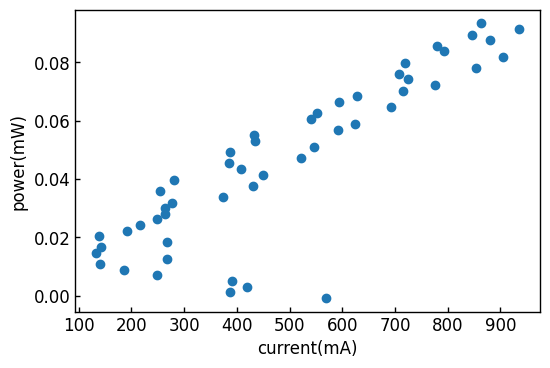

In [ ]:
### %%time
# NI Daq set-up
device = "Dev2/"
ld_cnt_current = device+"ai0"
photo_detector_v = device+"ai1"
ld_cnt_v = device+"ao0"

ld_power_data = []
with nidaqmx.Task() as ld_current_v, nidaqmx.Task() as photodetec_task, nidaqmx.Task() as out_ld_cnt_v:
    photodetec_task.ai_channels.add_ai_voltage_chan(photo_detector_v)
    ld_current_v.ai_channels.add_ai_voltage_chan(ld_cnt_current)
    out_ld_cnt_v.ao_channels.add_ao_voltage_chan(ld_cnt_v)
    
    out_ld_cnt_v.write(0)
    current_vol = np.arange(0,5,0.1)
    for current in current_vol:
        out_ld_cnt_v.write(current)
        time.sleep(0.1)
        ld_power_data.append([current/0.05,-1*ld_current_v.read()/0.005,-photodetec_task.read()*0.038/2])
#        print(current_vol[i],ai_task.read(),power_m.read())
        out_ld_cnt_v.write(0)
df_power_meas = pd.DataFrame(ld_power_data,columns=['Daq_voltage','from_current_volt','power_meter'])
df_power_meas.power_meter[df_power_meas.from_current_volt <= 0] = 0
plt.scatter(df_power_meas['from_current_volt'],df_power_meas['power_meter'])
plt.xlabel('current(mA)')
plt.ylabel('power(mW)')
plt.show()

In [ ]:
with nidaqmx.Task() as ld_current_v, nidaqmx.Task() as photodetec_task, nidaqmx.Task() as out_ld_cnt_v:
    out_ld_cnt_v.ao_channels.add_ao_voltage_chan(ld_cnt_v)
    out_ld_cnt_v.write(0)

## ROHDE oscilloscope

In [ ]:
# rohde oscilloscape
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst1 = rm.open_resource("USB0::0x0AAD::0x01D6::200515::INSTR",read_termination="\n")
inst1.query("*IDN?")

'Rohde&Schwarz,RTB2004,1333.1005k04/200515,02.300'

In [ ]:
# rohde data_reading
time_order = 8e-9
inst1.write("*RST")
inst1.write("CHAN:TYPE SAMP")#HRES or SAMP
inst1.write(f"TIM:SCAL {time_order}")
inst1.write("CHAN:scale 10e-3")

inst1.write("form:real")
inst1.write("form:bord lsbf")
inst1.write("chan:data:poin dmax")
inst1.write("acq:poin 20e6")
inst1.write("chan:offs 30e-3")
inst1.write("runc")##sing or runc
inst1.write("trig:a:lev 40e-3")

18

In [ ]:
inst1.write("acq:poin:aut OFF")
inst1.query("acq:poin:aut?")

'0'

In [ ]:
%%time
inst1.write("sing")
inst1.query("*opc?")
data_header = inst1.query("chan:data:head?")
rohde_data = inst1.query("chan:data?")
rohde_data = [float(i) for i in rohde_data.split(",")]

Wall time: 131 ms


In [ ]:
time_setting = [float(i) for i in data_header.split(",")]
time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))

1200

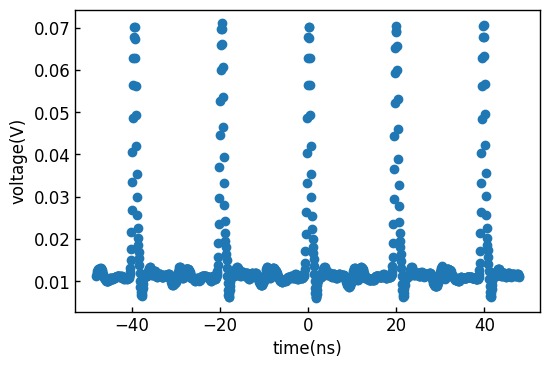

In [ ]:
plt.scatter(time_data/1e-9,rohde_data)
plt.xlabel("time(ns)")
plt.ylabel("voltage(V)")
len(rohde_data)

1200

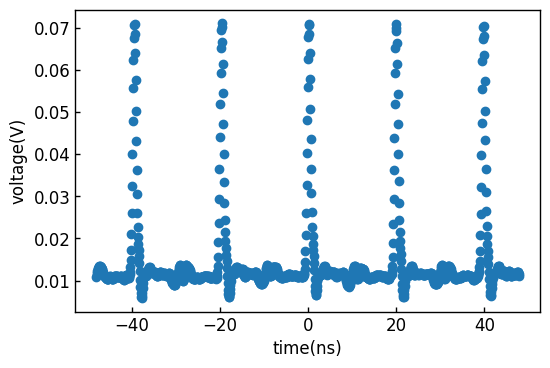

In [ ]:
plt.scatter(time_data/1e-9,rohde_data)
plt.xlabel("time(ns)")
plt.ylabel("voltage(V)")
len(rohde_data)

## optical spectrum

In [ ]:
# optical spectrum analyzer MS9710C
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst2 = rm.open_resource("GPIB1::8::INSTR",read_termination="\r\n")
inst2.query("*IDN?")

'ANRITSU,MS9710C,0,V3.13\r&V3.11'

In [ ]:
inst2.write("*RST")

6

In [ ]:
inst2.write("cnt 1560.0")
inst2.query("cnt?")
inst2.write("SPN 150")
inst2.query("SPN?")
inst2.write("MPT 501")
inst2.query("MPT?")
inst2.query("MSL?")
inst2.write("RLV -20")

9

In [ ]:
inst2.write("srt")# SSI single meas/SRT repeat
inst2.query("*opc?")

'1'

In [ ]:
inst2.query("LVS?")

'LOG'

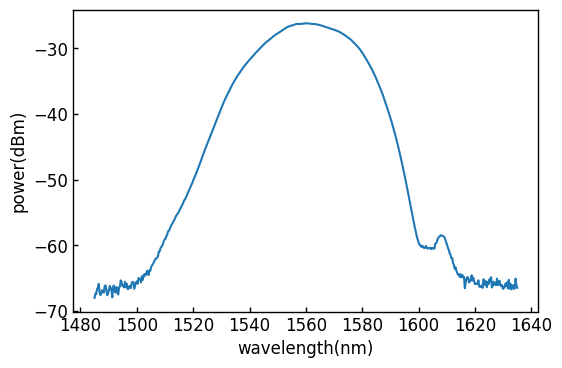

Wall time: 3.53 s


In [ ]:
%%time
inst2.write("ssi")
inst2.write("DMA?")
data = [float(inst2.read()) for i in range(501)]
wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
plt.plot(wl,data)
# plt.ylim(-90,-30)?
plt.xlabel("wavelength(nm)")
plt.ylabel("power(dBm)")
plt.show()

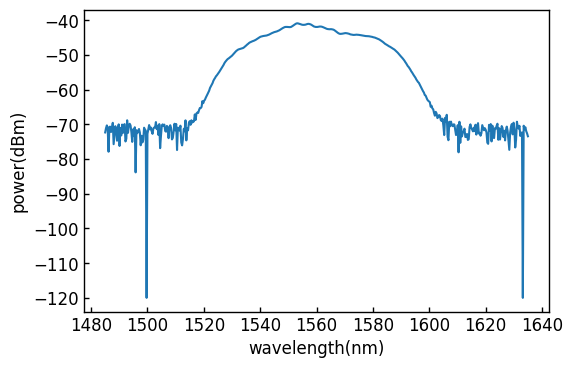

In [ ]:
inst2.write("DMA?")
data = [float(inst2.read()) for i in range(501)]
wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
plt.plot(wl,data)
plt.xlabel("wavelength(nm)")
plt.ylabel("power(dBm)")
plt.show()

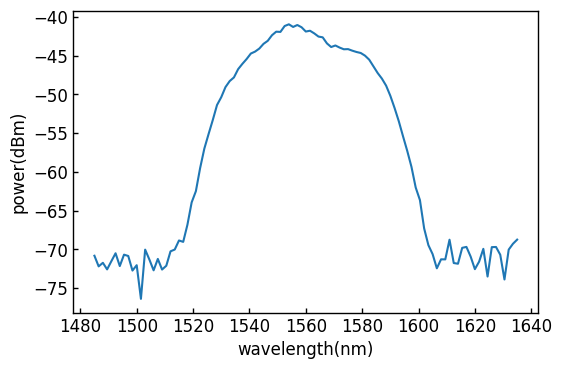

In [ ]:
inst2.write("DMA?")
data = [float(inst2.read()) for i in range(101)]
wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
plt.plot(wl,data)
plt.xlabel("wavelength(nm)")
plt.ylabel("power(dBm)")
plt.show()

In [ ]:
# instruments setup

# optical spectrum analyzer MS9710C
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst2 = rm.open_resource("GPIB0::8::INSTR",read_termination="\r\n")
inst2.query("*IDN?")

inst1 = rm.open_resource("USB0::0x0AAD::0x01D6::200515::INSTR",read_termination="\n")
inst1.query("*IDN?")

inst2.write("*RST")

inst2.write("cnt 1560.0")
inst2.query("cnt?")
inst2.write("SPN 200")
inst2.query("SPN?")
inst2.write("MPT 1001")
inst2.query("MPT?")
inst2.query("MSL?")


VisaIOError: VI_ERROR_TMO (-1073807339): Timeout expired before operation completed.

In [ ]:
%%time 
# Data aq

# spectrum 
## osci
inst1.write("SII")
inst1.query("*opc?")
data_header = inst1.query("chan:data:head?")
rohde_data = inst1.query("chan:data?")
rohde_data = [float(i) for i in rohde_data.split(",")]


Wall time: 5.5 ms


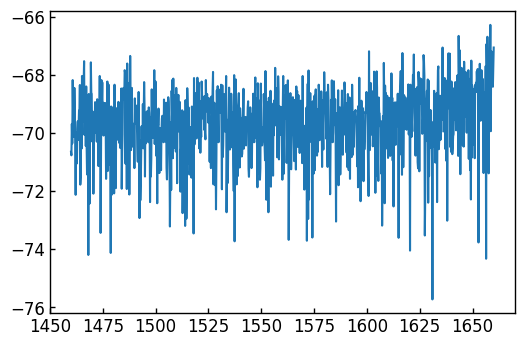

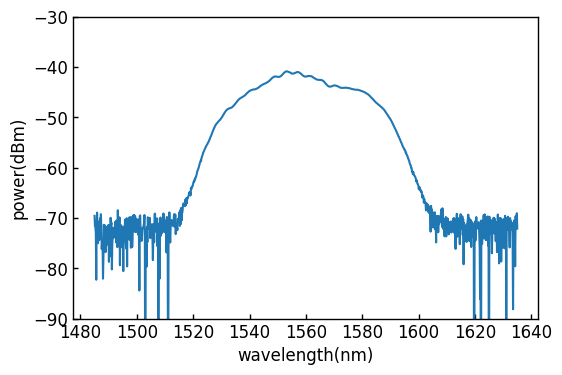

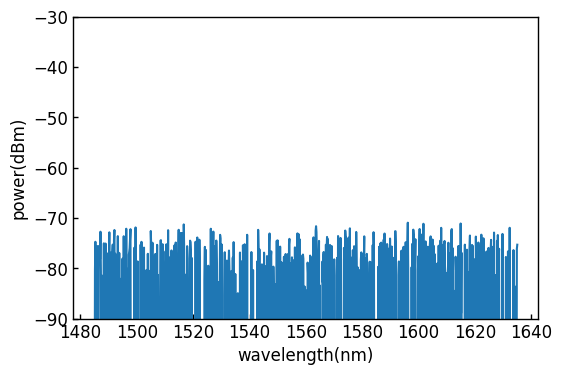

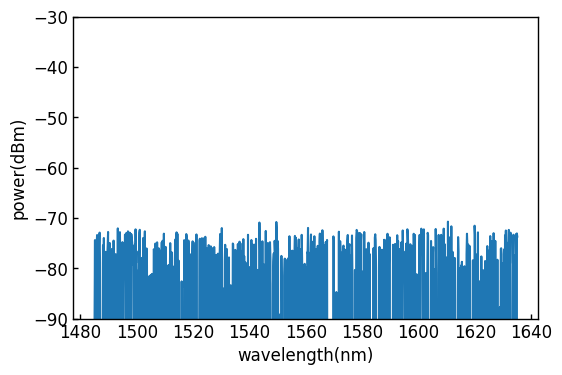

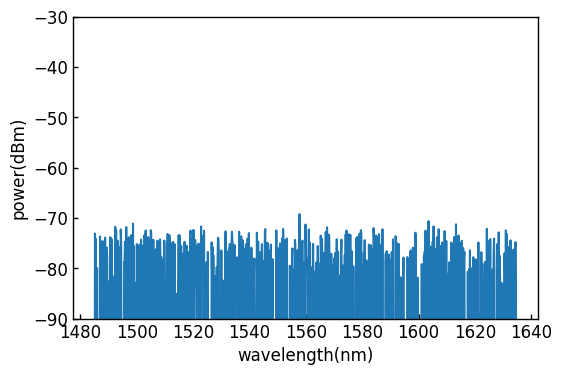

...

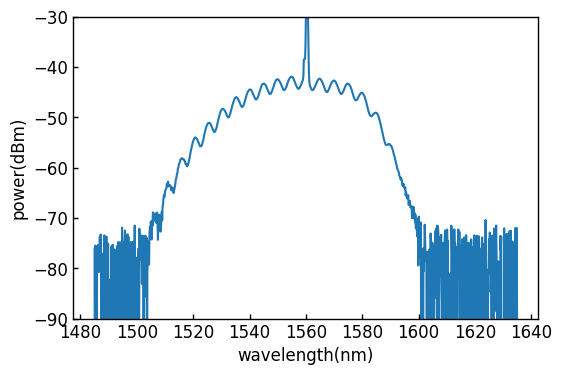

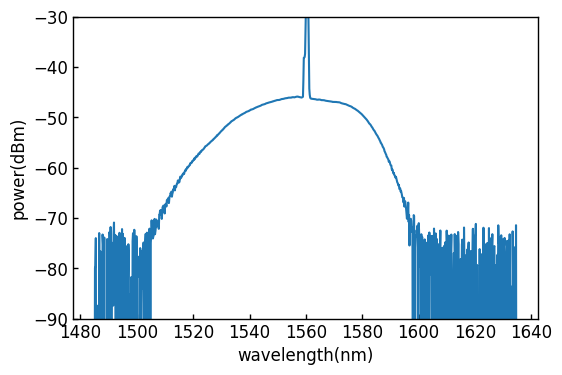

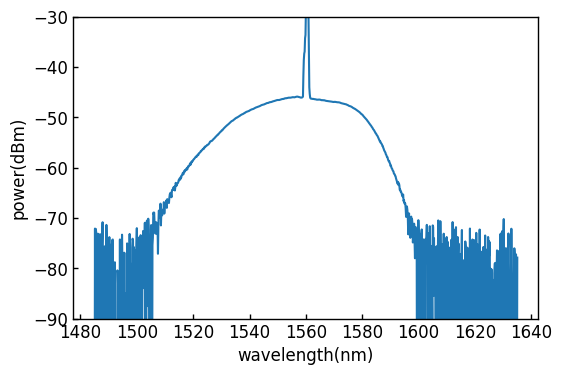

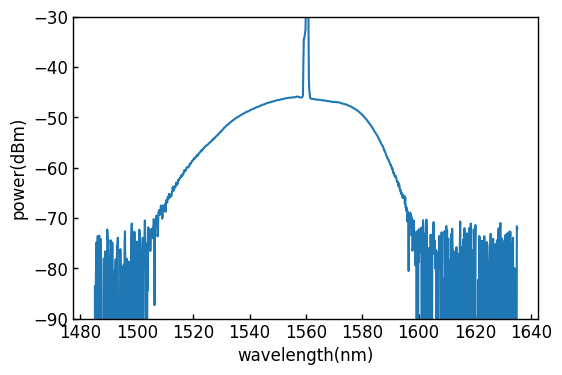

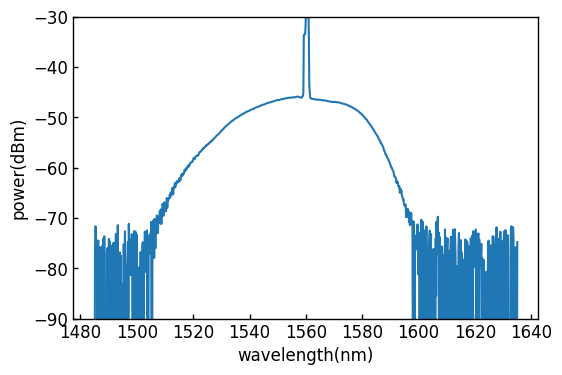

KeyboardInterrupt: 

In [ ]:
### %%time
# NI Daq set-up
device = "Dev2/"
ld_cnt_current = device+"ai0"
photo_detector_v = device+"ai1"
ld_cnt_v = device+"ao0"

ld_power_data = []
with nidaqmx.Task() as ld_current_v, nidaqmx.Task() as photodetec_task, nidaqmx.Task() as out_ld_cnt_v:
    photodetec_task.ai_channels.add_ai_voltage_chan(photo_detector_v)
    ld_current_v.ai_channels.add_ai_voltage_chan(ld_cnt_current)
    out_ld_cnt_v.ao_channels.add_ao_voltage_chan(ld_cnt_v)
    
    out_ld_cnt_v.write(0)
    current_vol = np.arange(0,5,0.1)
    for current in current_vol:
        out_ld_cnt_v.write(current)
        inst2.write("ssi")# SSI single meas/SRT repeat
        
        time.sleep(1)
        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(1001)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        plt.plot(wl,data)
        plt.ylim(-90,-30)
        plt.xlabel("wavelength(nm)")
        plt.ylabel("power(dBm)")
        plt.show()
        
        time.sleep(10)
        ld_power_data.append([current/0.05,-1*ld_current_v.read()/0.005,-photodetec_task.read()*0.038/2])
#        print(current_vol[i],ai_task.read(),power_m.read())
        out_ld_cnt_v.write(0)
df_power_meas = pd.DataFrame(ld_power_data,columns=['Daq_voltage','from_current_volt','power_meter'])
df_power_meas.power_meter[df_power_meas.from_current_volt <= 0] = 0
plt.scatter(df_power_meas['from_current_volt'],df_power_meas['power_meter'])
plt.xlabel('current(mA)')
plt.ylabel('power(mW)')
plt.show()

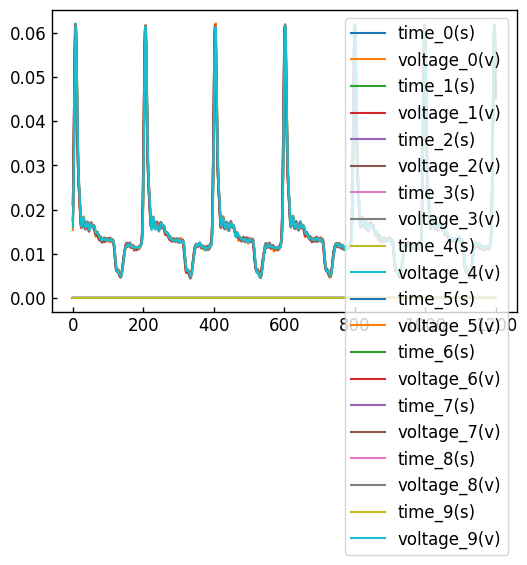

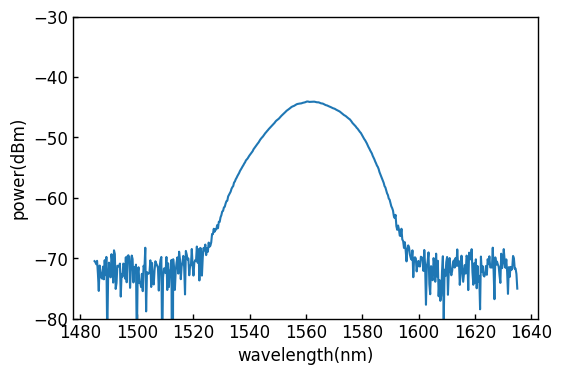

Wall time: 15.5 s


In [ ]:
%%time

data_df = pd.DataFrame()

hertz, nu = 3,0.02

for i in range(10):
    inst1.write("sing")
    inst1.query("*opc?")
    data_header = inst1.query("chan:data:head?")
    rohde_data = inst1.query("chan:data?")
    rohde_data = [float(i) for i in rohde_data.split(",")]
    time_setting = [float(i) for i in data_header.split(",")]
    time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
    #plt.plot(time_data/1e-9,rohde_data)
    #plt.xlabel("time(ns)")
    #plt.ylabel("voltage(V)")
    df_dammy = pd.DataFrame({f"time_{i}(s)":time_data,f"voltage_{i}(v)":rohde_data})
    data_df = pd.concat([data_df,df_dammy],axis=1)
    #print(data_df)
    time.sleep(1)
data_df.to_csv(f"measure_pulse_data_{nu}_{hertz}_vibration_test.csv")
data_df.plot()
plt.show()

inst2.write("ssi")# SSI single meas/SRT repeat
inst2.query("*opc?")
inst2.write("DMA?")
data = [float(inst2.read()) for i in range(501)]
wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
df_spectrum.index = df_spectrum["wavelength(nm)"]
df_spectrum.to_csv(f"spectumr_data_{nu}_{hertz}.csv")
plt.plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"])
plt.xlabel("wavelength(nm)")
plt.ylabel("power(dBm)")
plt.ylim(-80,-30)
plt.show()

In [ ]:
inst1.write("runc")
inst1.write("trig:a:lev 50e-3")

18

<AxesSubplot:>

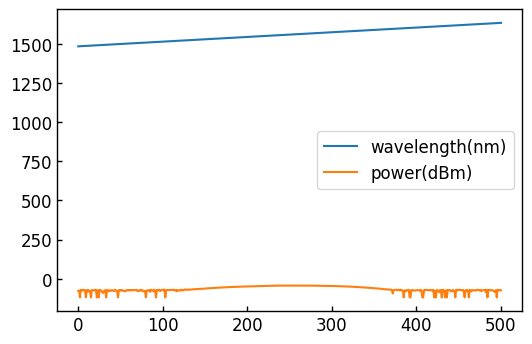

## LD_automation

[0.    0.03  0.06  0.09  0.12  0.15  0.18  0.21  0.24  0.27  0.3   0.33
 0.36  0.39  0.42  0.45  0.48  0.51  0.54  0.57  0.6   0.63  0.66  0.69
 0.72  0.75  0.78  0.81  0.84  0.87  0.9   0.93  0.96  0.99  1.02  1.05
 1.08  1.11  1.14  1.17  1.2   1.23  1.26  1.29  1.32  1.35  1.38  1.41
 1.44  1.47  1.5   1.53  1.56  1.59  1.62  1.65  1.68  1.71  1.74  1.77
 1.8   1.83  1.86  1.89  1.92  1.95  1.98  2.01  2.04  2.07  2.1   2.13
 2.16  2.19  2.22  2.25  2.28  2.31  2.34  2.37  2.4   2.43  2.46  2.49
 2.52  2.55  2.58  2.61  2.64  2.67  2.7   2.73  2.76  2.79  2.82  2.85
 2.88  2.91  2.94  2.97  3.    3.03  3.06  3.09  3.12  3.15  3.18  3.21
 3.24  3.27  3.3   3.33  3.36  3.39  3.42  3.45  3.48  3.51  3.54  3.57
 3.6   3.63  3.66  3.69  3.72  3.75  3.75  3.75  3.75  3.75  3.75  3.75
 3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75
 3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.75  3.74
 3.73  3.72  3.71  3.7   3.69  3.68  3.67  3.66  3.65  3.64  3.6

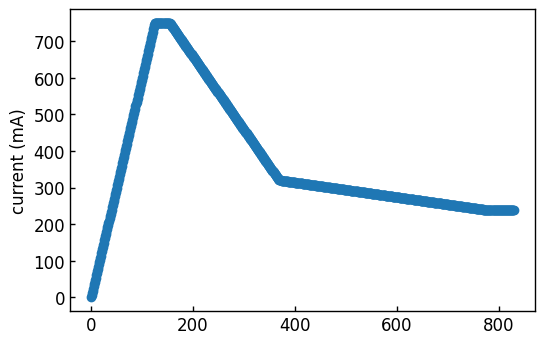

In [ ]:
# 10ms 間隔

max_current = 750
wait_time = 30

LD_voltage_up = np.arange(0,max_current*0.005,0.03)
LD_voltage_down = np.arange(320*0.005,max_current*0.005,0.01)
LD_voltage_down2 = np.arange(1.2,320*0.005,0.001)
LD_voltage_down = LD_voltage_down[::-1]
LD_voltage_down2 = LD_voltage_down2[::-1]

LD_const = [max_current*0.005]*wait_time

LD_last = [1.2]*wait_time*2

LD_voltage = np.append(LD_voltage_up,LD_const)
LD_voltage = np.append(LD_voltage,LD_voltage_down)
LD_voltage = np.append(LD_voltage,LD_voltage_down2)
LD_voltage = np.append(LD_voltage,LD_last)
plt.scatter(np.arange(len(LD_voltage)),LD_voltage/0.005)
LD_voltage[-1]/0.005

# plt.xlabel("time(ms)")
plt.ylabel("current (mA)")
print(LD_voltage)

In [ ]:
def mode_locked_automation(LD_voltage):
    with nidaqmx.Task() as out_ld_cnt_v:
        out_ld_cnt_v.ao_channels.add_ao_voltage_chan("Dev1/ao0")
        current_vol = LD_voltage
        for current in current_vol:
            time.sleep(0.01)
            out_ld_cnt_v.write(current)

In [ ]:
%%time

for i in range(10):
    with nidaqmx.Task() as out_ld_cnt_v:
        out_ld_cnt_v.ao_channels.add_ao_voltage_chan("Dev1/ao0")
        current_vol = LD_voltage
        for current in current_vol:
            time.sleep(0.01)
            out_ld_cnt_v.write(current)

Wall time: 1min 41s


In [ ]:
with nidaqmx.Task() as out_ld_cnt_v:
    out_ld_cnt_v.ao_channels.add_ao_voltage_chan("Dev2/ao0")
    out_ld_cnt_v.write(0)

In [ ]:
%%time
for i in range(1000):
    with nidaqmx.Task() as temp_v:
        temp_v.ai_channels.add_ai_voltage_chan("Dev1/ai0")
        data = temp_v.read()

5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.542984252019907
5.54298425

KeyboardInterrupt: 

In [ ]:
%%time

for num in range(160):
    data_folder = f"Z:\measurements_data\mode_locked_automation_data/20211202/test_number_{num}"
    os.makedirs(data_folder,exist_ok=True)

    temp_data = []

    for i in range(100):
        mode_locked_automation(LD_voltage)
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        df_LD_auto.index = df_LD_auto[f"time_{i}"]
        df_LD_auto.to_csv(os.path.join(data_folder,f"automation_pulse_{i}.csv"))

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
        df_spectrum.index = df_spectrum["wavelength(nm)"]
        df_spectrum.to_csv(os.path.join(data_folder,f"automation_spectrum_{i}.csv"))
        time.sleep(1)
        rf_data = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
        time.sleep(1)
        rf_frequency = np.linspace(10000,1000000000,len(rf_data))
        rf_df = pd.DataFrame({"freq":rf_frequency,"power":rf_data})
        rf_df.to_csv(os.path.join(data_folder,f"automation_rf_spectrum_{i}.csv"))
        time.sleep(0.5)

#         fig, ax = plt.subplots(1,3,figsize=(18,4))
#         ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])


#         ax[1].plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"],label=f"number = {i}")
#         ax[1].set_xlabel("wavelength(nm)")
#         ax[1].set_ylabel("power(dBm)")
#         ax[1].set_xlim(1485,1635)
#         ax[1].set_ylim(-80,-10)

#         ax[2].plot(rf_frequency,rf_data)
#         plt.tight_layout()
#         # plt.savefig(os.path.join(data_folder,f"repetability_mode_locked_automation_{i}.png"),dpi=300)
#         plt.show()

        with nidaqmx.Task() as temp_v:
            temp_v.ai_channels.add_ai_voltage_chan("Dev1/ai0")
            temp_data = np.append(temp_data,np.mean(temp_v.read(number_of_samples_per_channel=100)))

    np.savetxt(os.path.join(data_folder,"temp_test.csv"), temp_data, delimiter =",",fmt ='% s')

VisaIOError: VI_ERROR_TMO (-1073807339): Timeout expired before operation completed.

In [ ]:
%%time

for num in range(160):
    data_folder = f"Z:\measurements_data\mode_locked_automation_data/20211202/test_number_{num}"
    os.makedirs(data_folder,exist_ok=True)

    temp_data = []

    for i in range(100):
        mode_locked_automation(LD_voltage)
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        df_LD_auto.index = df_LD_auto[f"time_{i}"]
        df_LD_auto.to_csv(os.path.join(data_folder,f"automation_pulse_{i}.csv"))

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
        df_spectrum.index = df_spectrum["wavelength(nm)"]
        df_spectrum.to_csv(os.path.join(data_folder,f"automation_spectrum_{i}.csv"))
        time.sleep(1)
        rf_data = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
        time.sleep(1)
        rf_frequency = np.linspace(10000,1000000000,len(rf_data))
        rf_df = pd.DataFrame({"freq":rf_frequency,"power":rf_data})
        rf_df.to_csv(os.path.join(data_folder,f"automation_rf_spectrum_{i}.csv"))
        time.sleep(0.5)

#         fig, ax = plt.subplots(1,3,figsize=(18,4))
#         ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])


#         ax[1].plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"],label=f"number = {i}")
#         ax[1].set_xlabel("wavelength(nm)")
#         ax[1].set_ylabel("power(dBm)")
#         ax[1].set_xlim(1485,1635)
#         ax[1].set_ylim(-80,-10)

#         ax[2].plot(rf_frequency,rf_data)
#         plt.tight_layout()
#         # plt.savefig(os.path.join(data_folder,f"repetability_mode_locked_automation_{i}.png"),dpi=300)
#         plt.show()

        with nidaqmx.Task() as temp_v:
            temp_v.ai_channels.add_ai_voltage_chan("Dev1/ai0")
            temp_data = np.append(temp_data,np.mean(temp_v.read(number_of_samples_per_channel=100)))

    np.savetxt(os.path.join(data_folder,"temp_test.csv"), temp_data, delimiter =",",fmt ='% s')

VisaIOError: VI_ERROR_TMO (-1073807339): Timeout expired before operation completed.

In [ ]:
mode_locked_automation(LD_voltage)

## mode locked laser rep tability

In [ ]:
%%time
rf_freq = [1000,1e9,10001]
rf_frequency = np.linspace(*rf_freq)

for num in range(160):
    data_folder = f"Z:\measurements_data\mode_locked_automation_data/20211204/test_number_{num}"
    os.makedirs(data_folder,exist_ok=True)

    temp_data = []

    for i in range(100):
        mode_locked_automation(LD_voltage)
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        inst5.write("init:mode:sing")
        time.sleep(0.1)
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        df_LD_auto.index = df_LD_auto[f"time_{i}"]
        df_LD_auto.to_csv(os.path.join(data_folder,f"automation_pulse_{i}.csv"))

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        time.sleep(0.1)
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wavelength[2] = int(wavelength[2])
        wl = np.linspace(*wavelength)
        df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
        df_spectrum.index = df_spectrum["wavelength(nm)"]
        df_spectrum.to_csv(os.path.join(data_folder,f"automation_spectrum_{i}.csv"))
        time.sleep(0.1)
        rf_data = [float(i) for i in inst5.query("trac? trac1").split(",")]
        rf_df = pd.DataFrame({"freq":rf_frequency,"power":rf_data})
        rf_df.to_csv(os.path.join(data_folder,f"automation_rf_spectrum_{i}.csv"))

#         fig, ax = plt.subplots(1,3,figsize=(18,4))
#         ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])


#         ax[1].plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"],label=f"number = {i}")
#         ax[1].set_xlabel("wavelength(nm)")
#         ax[1].set_ylabel("power(dBm)")
#         ax[1].set_xlim(1485,1635)
#         ax[1].set_ylim(-80,-10)

#         ax[2].plot(rf_frequency,rf_data)
#         plt.tight_layout()
#         # plt.savefig(os.path.join(data_folder,f"repetability_mode_locked_automation_{i}.png"),dpi=300)
#         plt.show()

        with nidaqmx.Task() as temp_v:
            temp_v.ai_channels.add_ai_voltage_chan("Dev1/ai0")
            temp_data = np.append(temp_data,np.mean(temp_v.read(number_of_samples_per_channel=100)))

    np.savetxt(os.path.join(data_folder,"temp_test.csv"), temp_data, delimiter =",",fmt ='% s')

VisaIOError: VI_ERROR_BERR (-1073807304): Bus error occurred during transfer.

In [ ]:
temp_data = []
for i in range(100):
    with nidaqmx.Task() as temp_v:
        temp_v.ai_channels.add_ai_voltage_chan("Dev1/ai0")
        temp_data = np.append(temp_data,np.mean(temp_v.read(number_of_samples_per_channel=100)))

np.savetxt("temp_test.csv", temp_data, delimiter =",",fmt ='% s')

0.37 170


  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

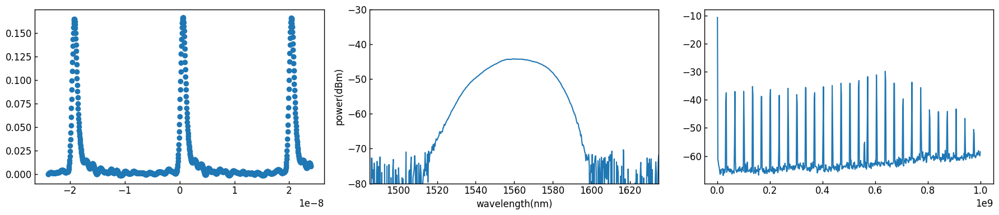

  5%|████▏                                                                              | 1/20 [00:19<06:13, 19.67s/it]

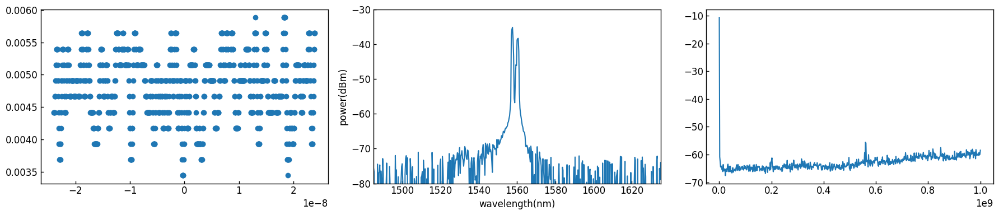

 10%|████████▎                                                                          | 2/20 [00:40<06:03, 20.21s/it]

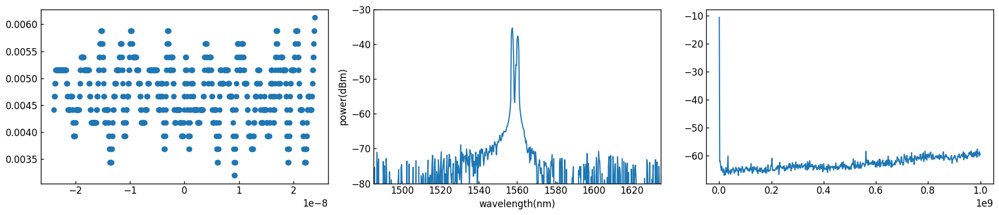

 15%|████████████▍                                                                      | 3/20 [01:00<05:46, 20.40s/it]

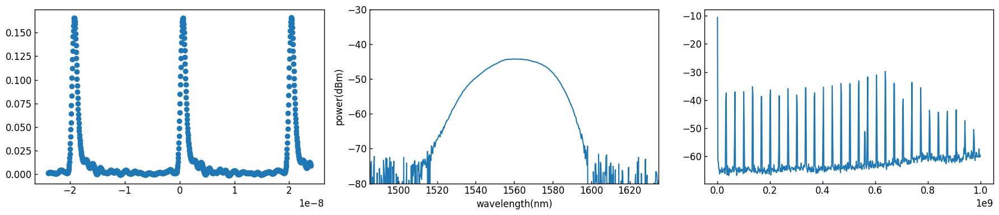

 20%|████████████████▌                                                                  | 4/20 [01:21<05:25, 20.33s/it]

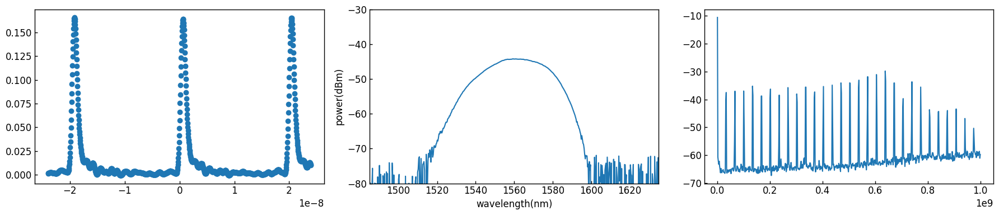

 25%|████████████████████▊                                                              | 5/20 [01:41<05:03, 20.24s/it]

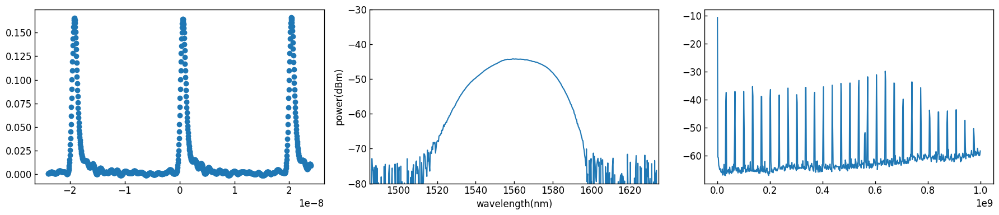

 30%|████████████████████████▉                                                          | 6/20 [02:01<04:42, 20.19s/it]

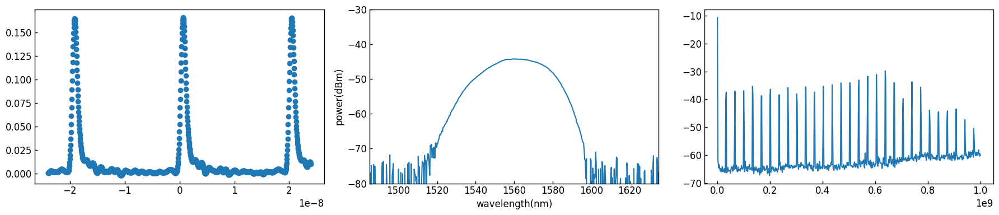

 35%|█████████████████████████████                                                      | 7/20 [02:21<04:22, 20.21s/it]

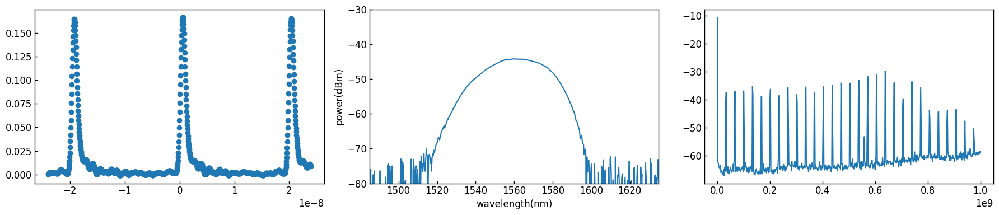

 40%|█████████████████████████████████▏                                                 | 8/20 [02:41<04:02, 20.19s/it]

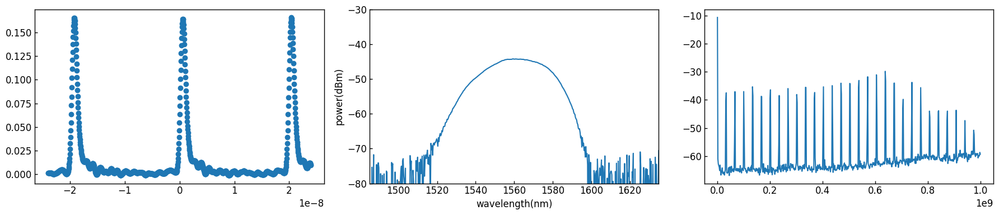

 45%|█████████████████████████████████████▎                                             | 9/20 [03:01<03:42, 20.19s/it]

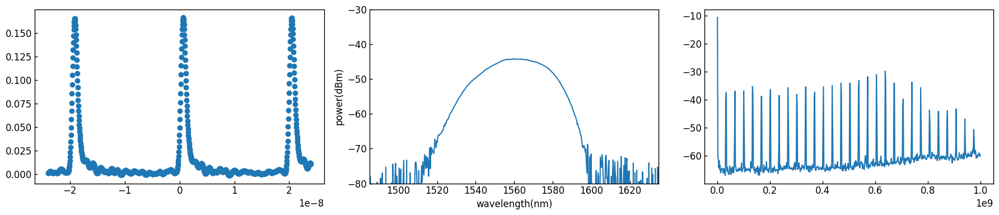

 50%|█████████████████████████████████████████                                         | 10/20 [03:22<03:23, 20.32s/it]

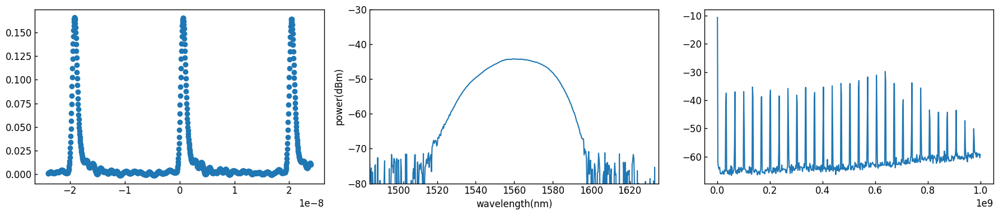

 55%|█████████████████████████████████████████████                                     | 11/20 [03:42<03:02, 20.32s/it]

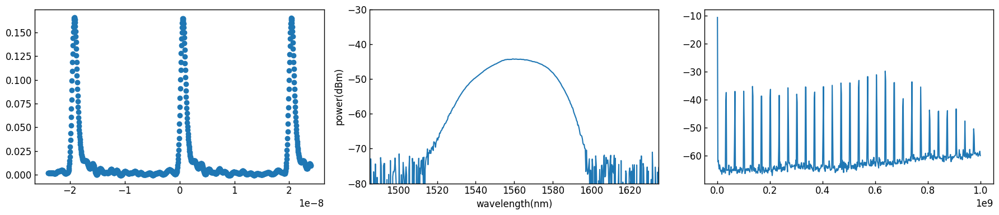

 60%|█████████████████████████████████████████████████▏                                | 12/20 [04:02<02:41, 20.24s/it]

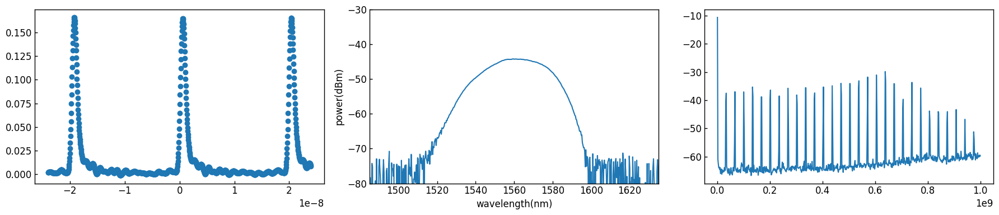

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [04:23<02:21, 20.25s/it]

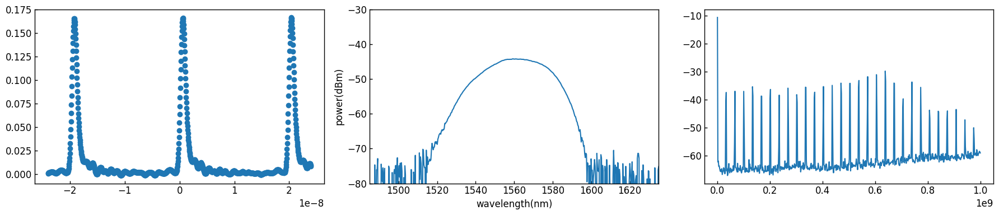

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [04:43<02:01, 20.26s/it]

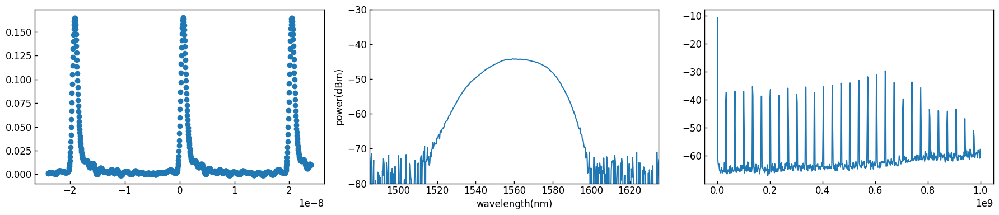

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [05:03<01:40, 20.13s/it]

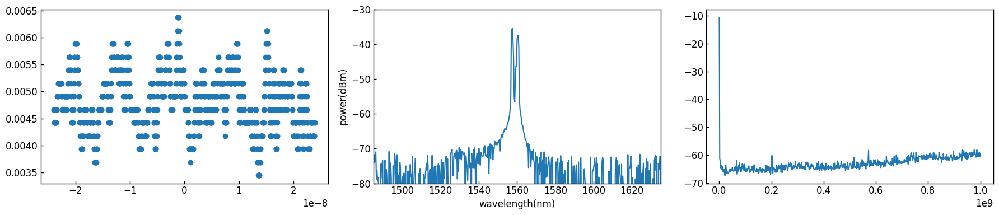

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [05:23<01:20, 20.19s/it]

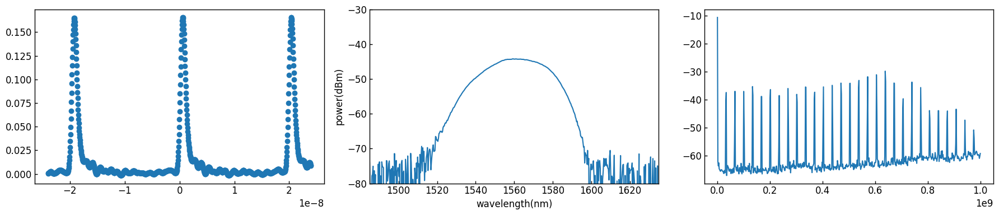

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [05:43<01:00, 20.02s/it]

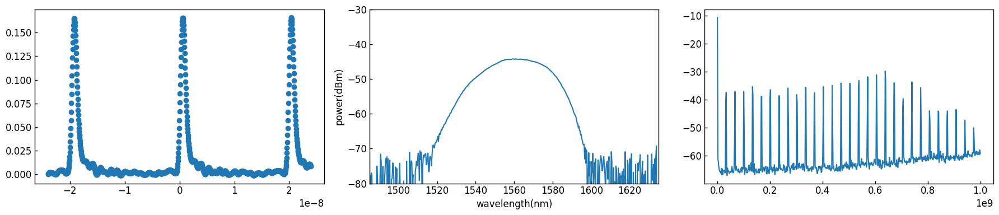

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [06:03<00:39, 19.98s/it]

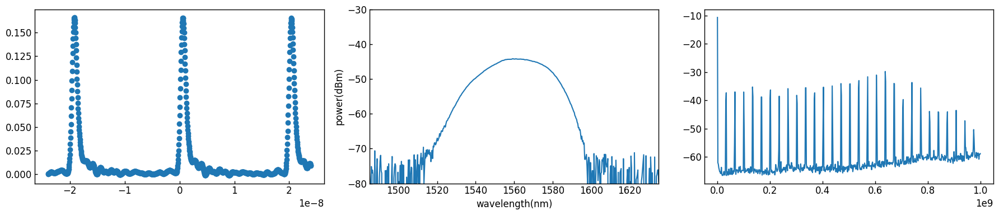

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [06:23<00:20, 20.06s/it]

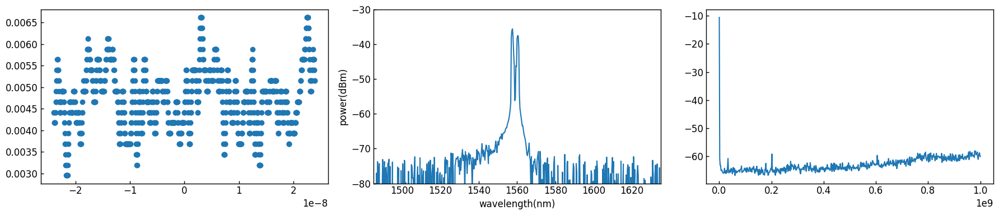

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [06:44<00:00, 20.21s/it]


0.375 175


  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

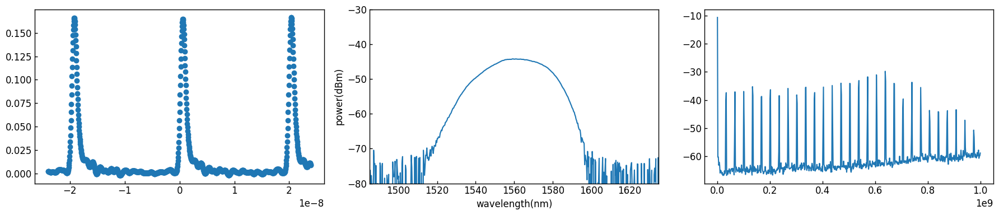

  5%|████▏                                                                              | 1/20 [00:19<06:19, 19.99s/it]

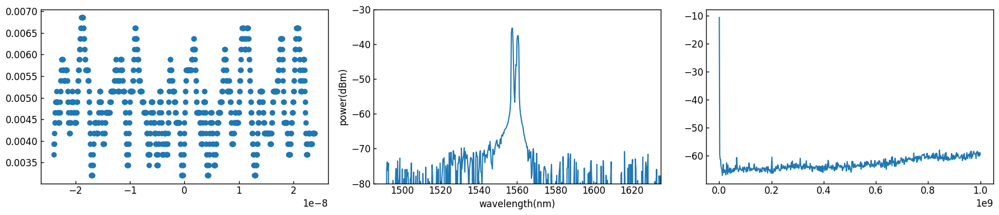

 10%|████████▎                                                                          | 2/20 [00:40<06:07, 20.43s/it]

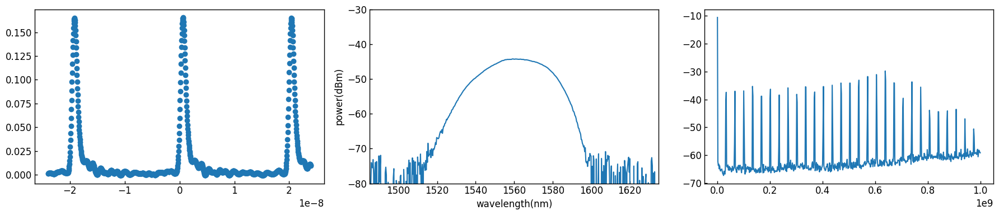

 15%|████████████▍                                                                      | 3/20 [01:00<05:45, 20.30s/it]

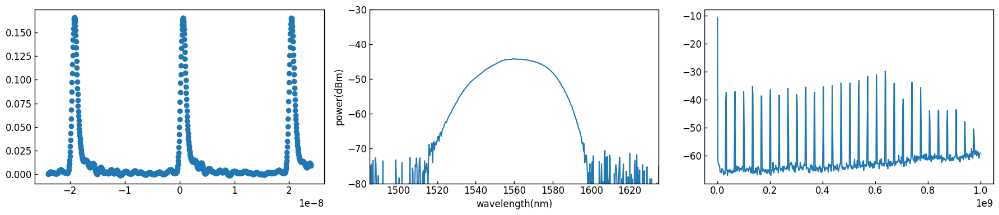

 20%|████████████████▌                                                                  | 4/20 [01:20<05:23, 20.20s/it]

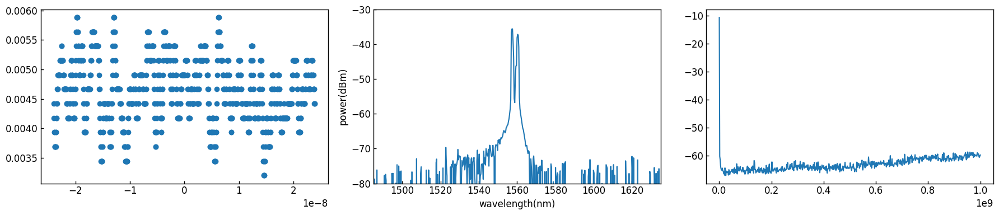

 25%|████████████████████▊                                                              | 5/20 [01:41<05:05, 20.37s/it]

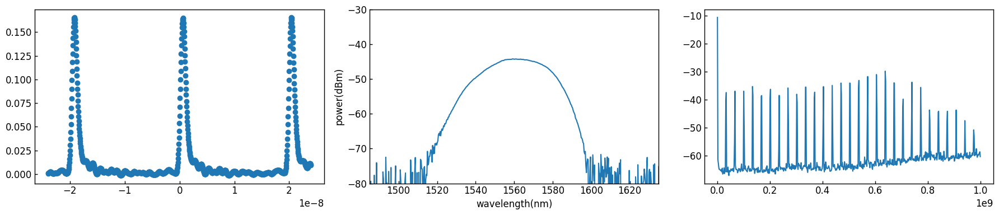

 30%|████████████████████████▉                                                          | 6/20 [02:01<04:45, 20.36s/it]

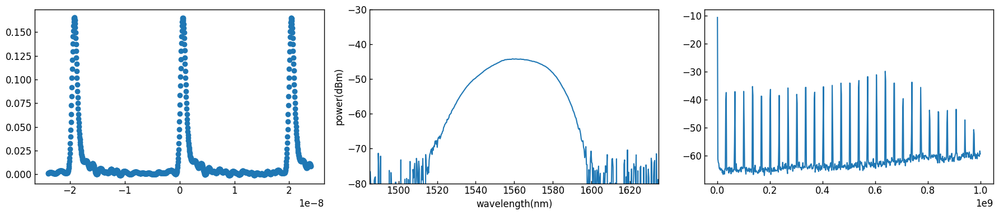

 35%|█████████████████████████████                                                      | 7/20 [02:22<04:25, 20.42s/it]

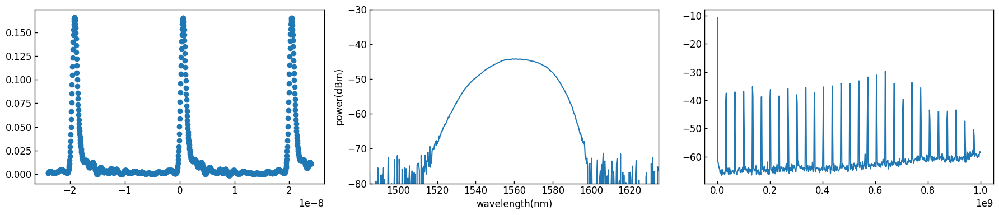

 40%|█████████████████████████████████▏                                                 | 8/20 [02:42<04:03, 20.32s/it]

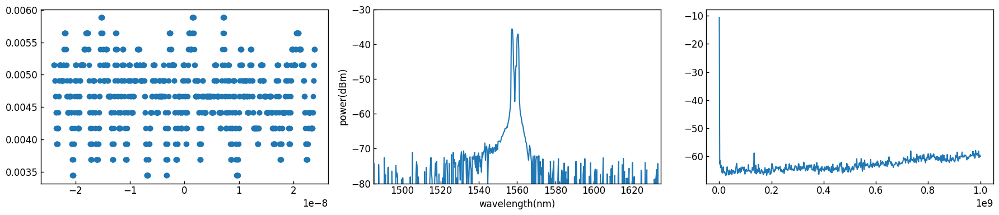

 45%|█████████████████████████████████████▎                                             | 9/20 [03:03<03:44, 20.44s/it]

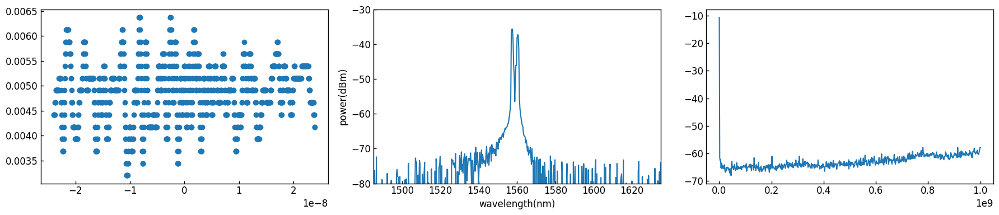

 50%|█████████████████████████████████████████                                         | 10/20 [03:23<03:25, 20.51s/it]

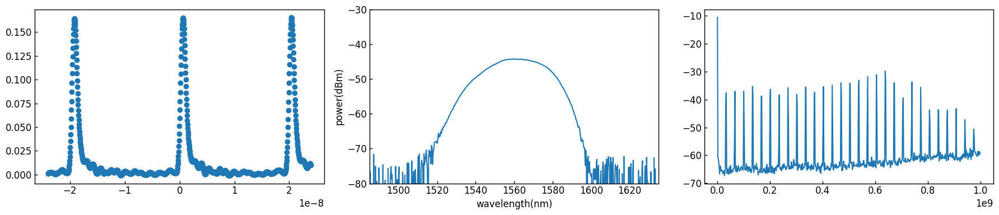

 55%|█████████████████████████████████████████████                                     | 11/20 [03:44<03:03, 20.40s/it]

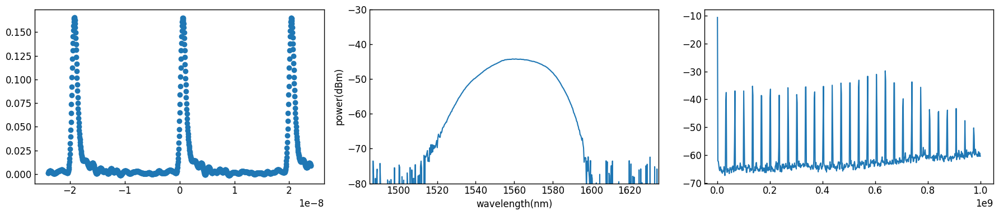

 60%|█████████████████████████████████████████████████▏                                | 12/20 [04:04<02:42, 20.30s/it]

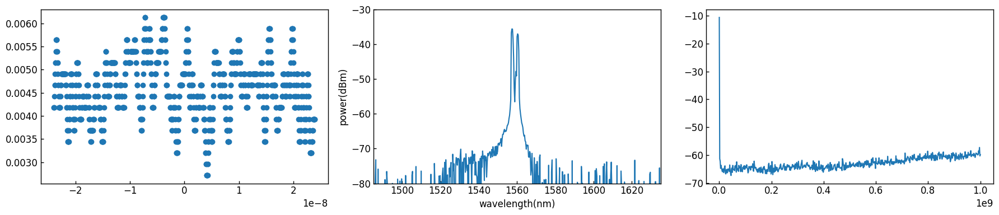

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [04:24<02:22, 20.38s/it]

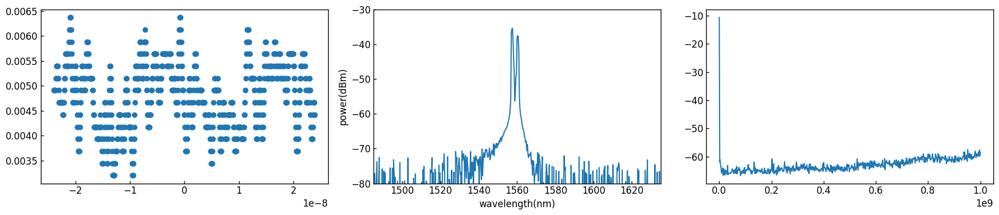

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [04:45<02:02, 20.47s/it]

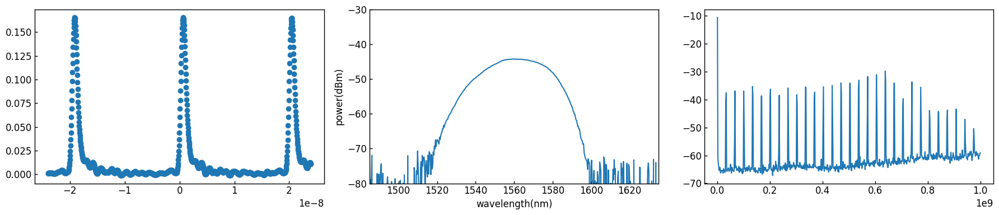

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [05:05<01:41, 20.37s/it]

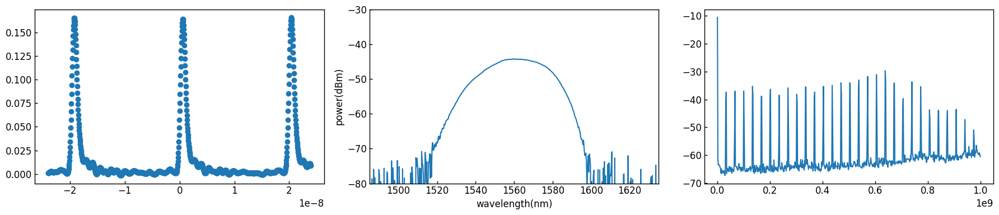

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [05:25<01:21, 20.33s/it]

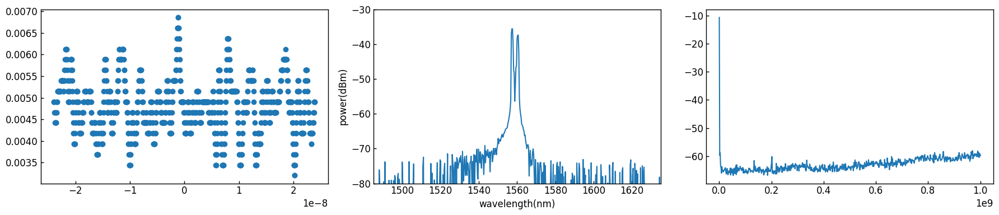

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [05:46<01:01, 20.42s/it]

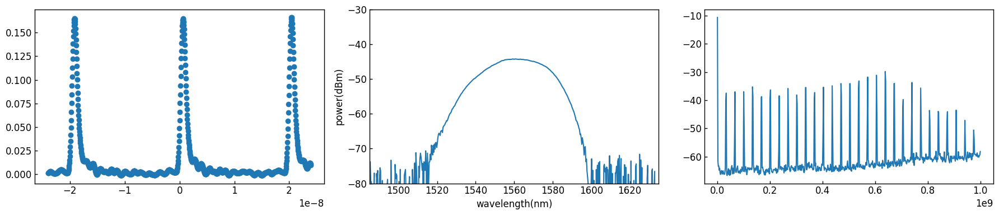

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [06:06<00:40, 20.30s/it]

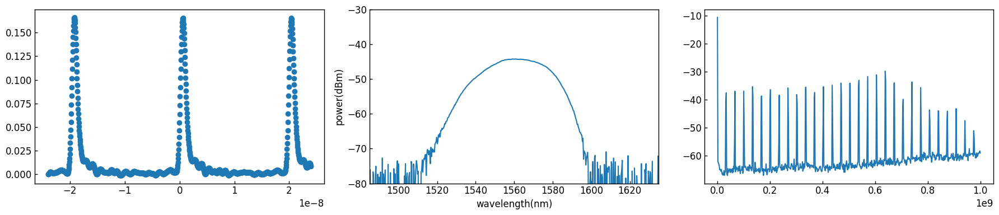

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [06:26<00:20, 20.30s/it]

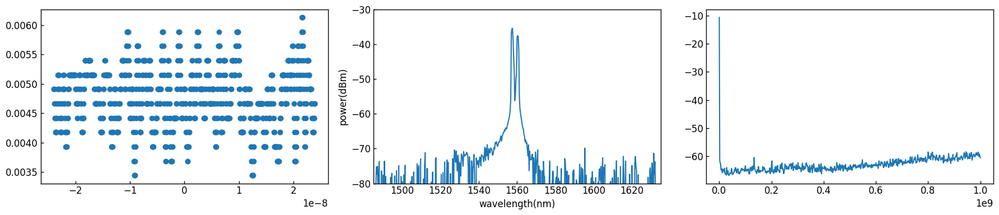

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [06:47<00:00, 20.37s/it]


0.38 180


  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

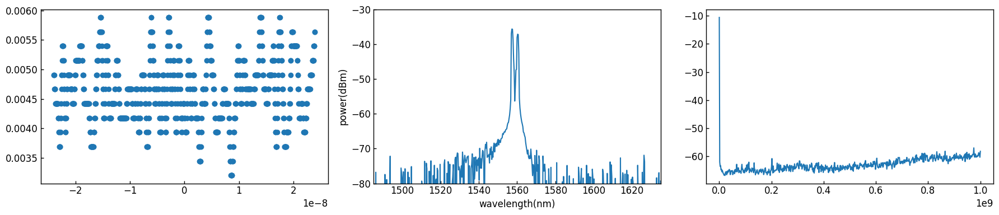

  5%|████▏                                                                              | 1/20 [00:20<06:29, 20.48s/it]

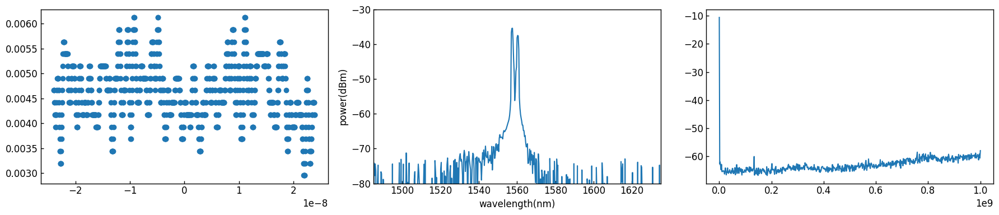

 10%|████████▎                                                                          | 2/20 [00:40<06:07, 20.43s/it]

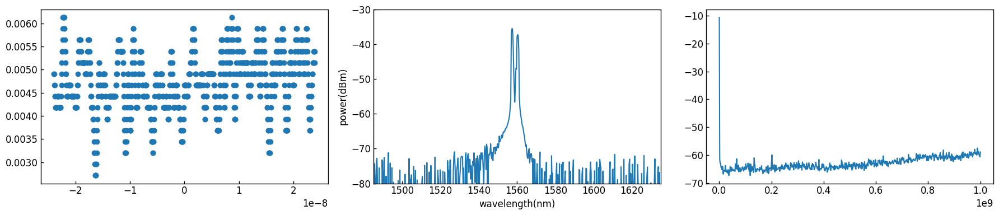

 15%|████████████▍                                                                      | 3/20 [01:01<05:51, 20.70s/it]

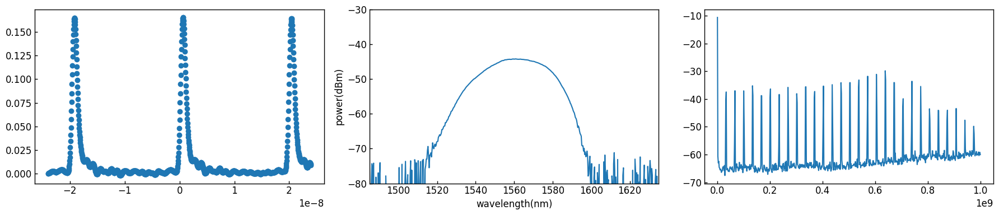

 20%|████████████████▌                                                                  | 4/20 [01:21<05:26, 20.43s/it]

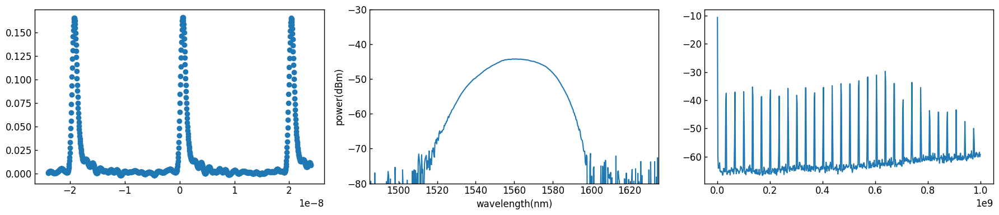

 25%|████████████████████▊                                                              | 5/20 [01:42<05:05, 20.36s/it]

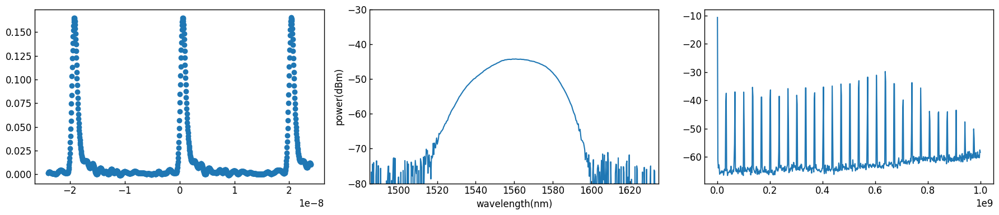

 30%|████████████████████████▉                                                          | 6/20 [02:02<04:44, 20.32s/it]

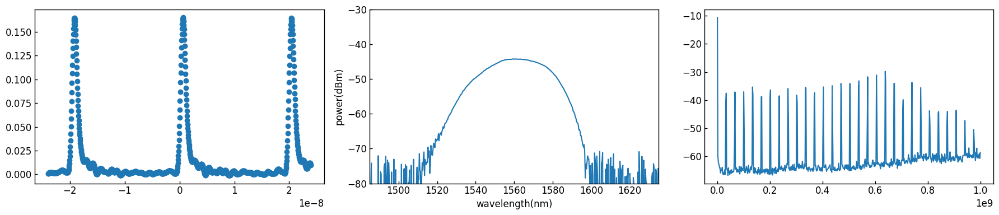

 35%|█████████████████████████████                                                      | 7/20 [02:22<04:23, 20.29s/it]

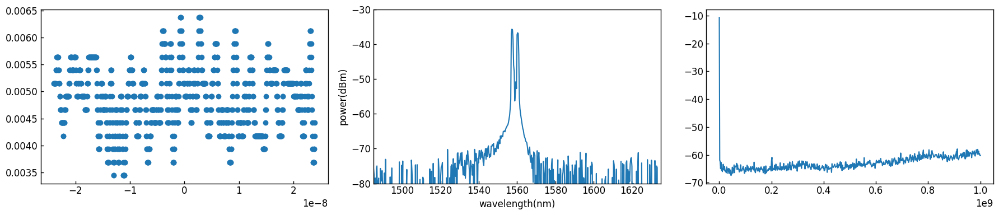

 40%|█████████████████████████████████▏                                                 | 8/20 [02:42<04:03, 20.29s/it]

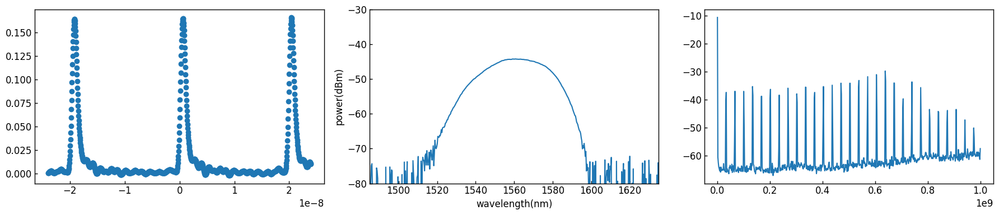

 45%|█████████████████████████████████████▎                                             | 9/20 [03:03<03:42, 20.27s/it]

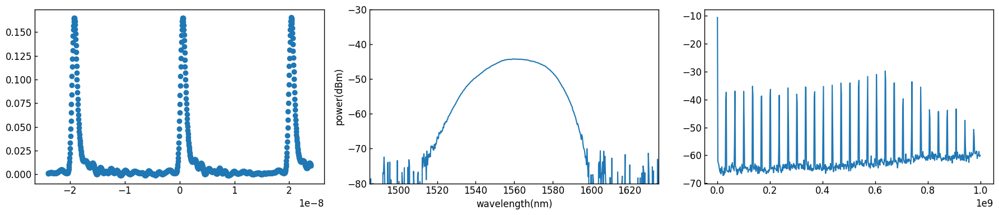

 50%|█████████████████████████████████████████                                         | 10/20 [03:23<03:22, 20.23s/it]

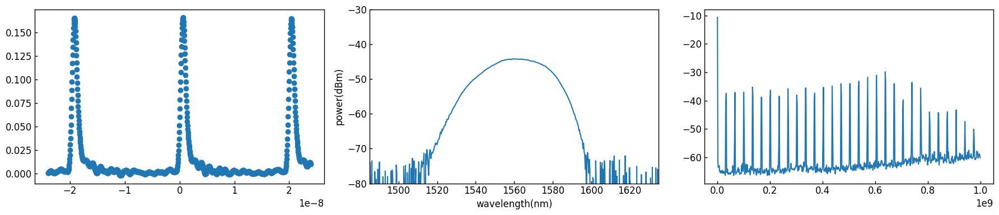

 55%|█████████████████████████████████████████████                                     | 11/20 [03:43<03:01, 20.18s/it]

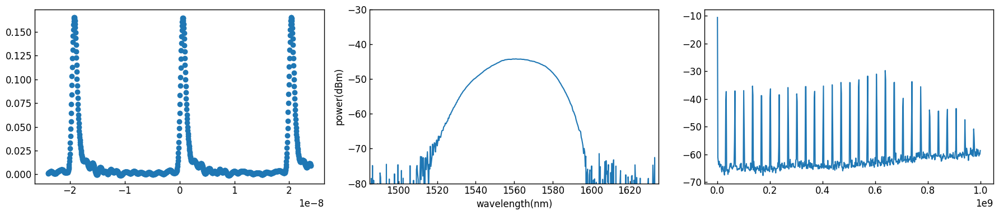

 60%|█████████████████████████████████████████████████▏                                | 12/20 [04:03<02:41, 20.19s/it]

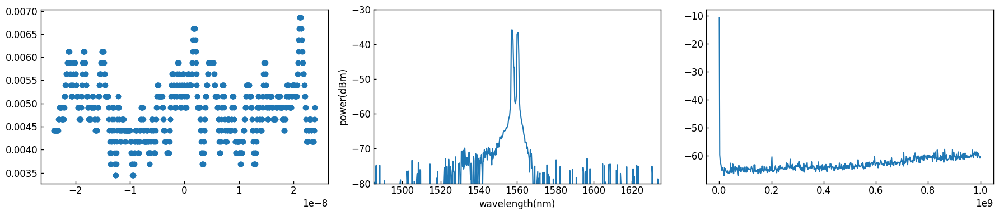

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [04:23<02:20, 20.00s/it]

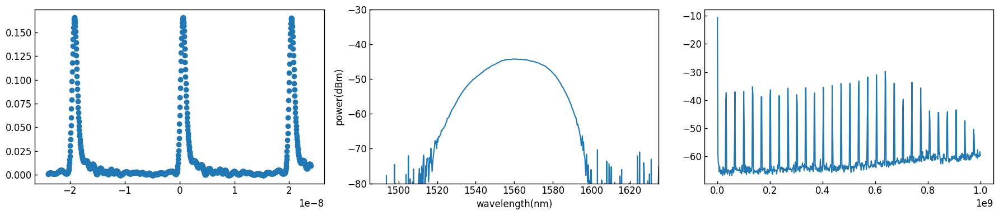

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [04:43<02:00, 20.00s/it]

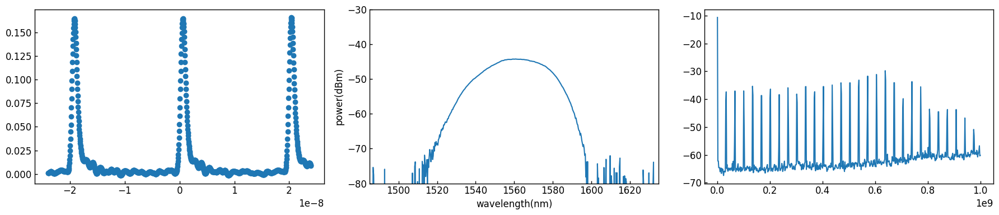

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [05:03<01:40, 20.00s/it]

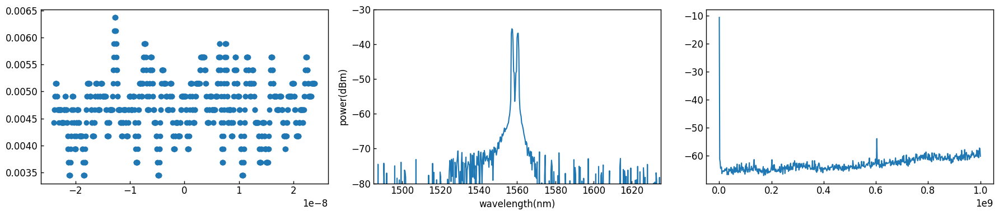

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [05:23<01:20, 20.08s/it]

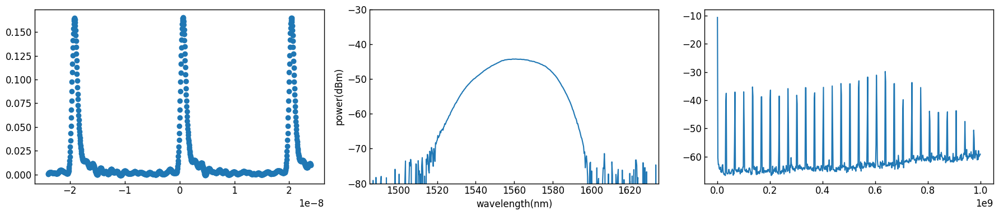

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [05:43<01:00, 20.03s/it]

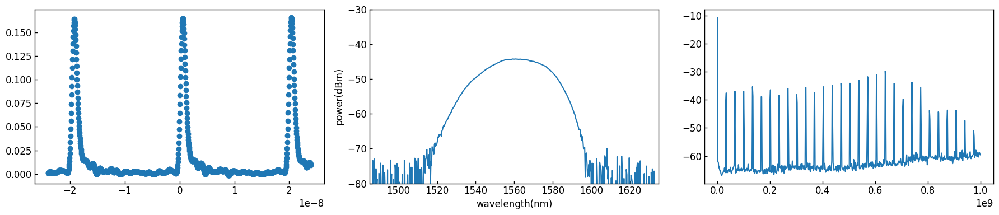

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [06:03<00:40, 20.08s/it]

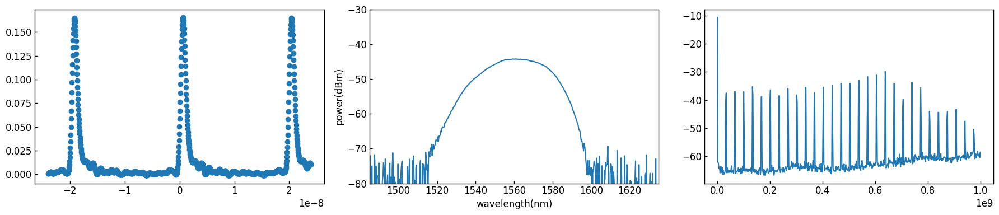

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [06:23<00:20, 20.12s/it]

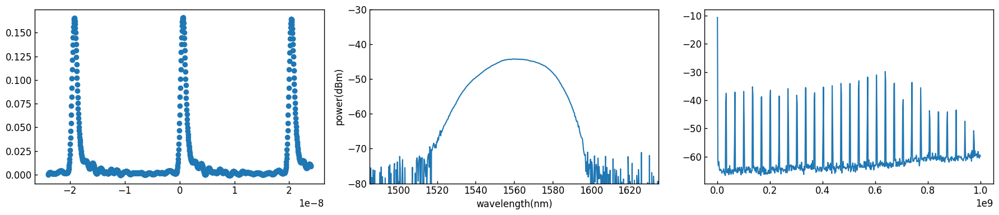

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [06:44<00:00, 20.22s/it]

Wall time: 20min 15s


In [ ]:
%%time

Vpp = amp_df["input_amplitude"]
Freq = amp_df.index

for Vpp_,freq_ in zip(Vpp,Freq):
    data_folder = f"mode_locked_auto/mode_locked_break_test/_{Vpp_}_{freq_}Hz"
    os.makedirs(data_folder,exist_ok=True)

    inst3.write("output:state ON") 
    inst3.write("source:volt:immediate:unit VPP")
    inst3.write(f"source:volt:immediate:amplitude {Vpp_}")
    #     inst3.query("source:freq?")
    inst3.write(f"source:freq {freq_}")


    pulse_data = pd.DataFrame()
    spec_data = pd.DataFrame()
    rf_data = pd.DataFrame()
    daq_data = pd.DataFrame()
    print(Vpp_,freq_)

    for i in tqdm(range(20)):
        mode_locked_automation(LD_voltage)
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        df_LD_auto.index = df_LD_auto[f"time_{i}"]
        df_LD_auto.to_csv(os.path.join(data_folder,f"automation_pulse_{i}.csv"))

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
        df_spectrum.index = df_spectrum["wavelength(nm)"]
        df_spectrum.to_csv(os.path.join(data_folder,f"automation_spectrum_{i}.csv"))
        time.sleep(0.5)
        rf_data = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
        rf_frequency = np.linspace(10000,1000000000,len(rf_data))
        rf_df = pd.DataFrame({"freq":rf_frequency,"power":rf_data})
        rf_df.to_csv(os.path.join(data_folder,f"automation_rf_spectrum_{i}.csv"))

        fig, ax = plt.subplots(1,3,figsize=(18,4))
        ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])


        ax[1].plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"],label=f"number = {i}")
        ax[1].set_xlabel("wavelength(nm)")
        ax[1].set_ylabel("power(dBm)")
        ax[1].set_xlim(1485,1635)
        ax[1].set_ylim(-80,-30)

        ax[2].plot(rf_frequency,rf_data)
        plt.tight_layout()
        plt.savefig(os.path.join(data_folder,f"repetability_mode_locked_automation_{i}.png"),dpi=300)
        plt.show()

In [ ]:
rf_frequency = np.linspace(10000,1000000000,len(rf_data))
len(rf_frequency)

601

## モード同期破壊テスト

  0%|                                                                                           | 0/10 [00:00<?, ?it/s]

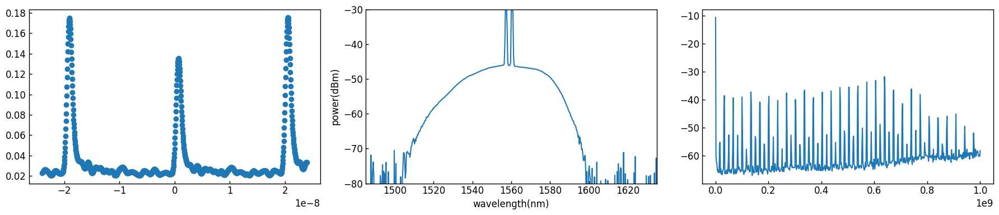

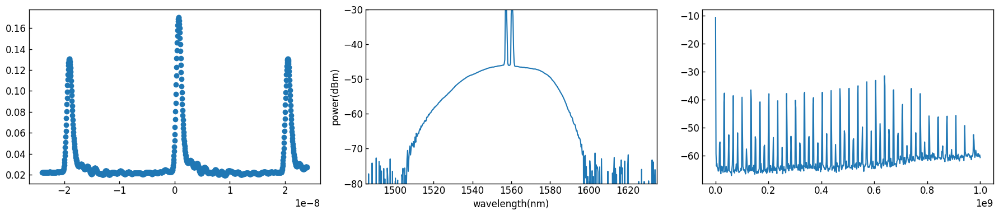

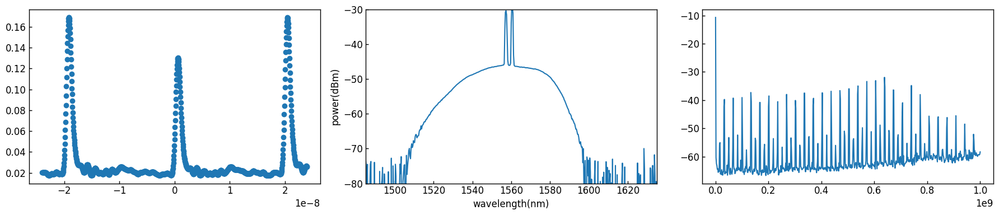

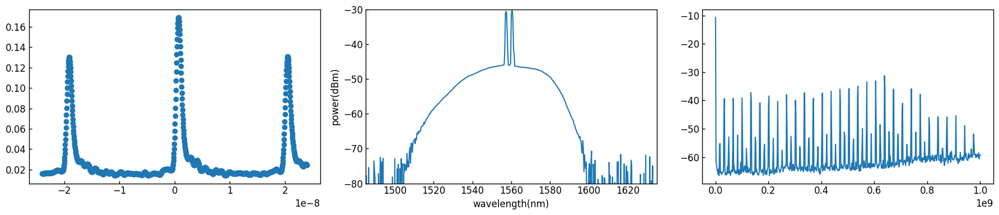

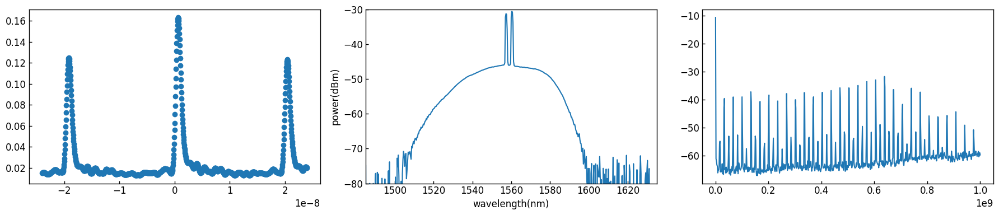

...

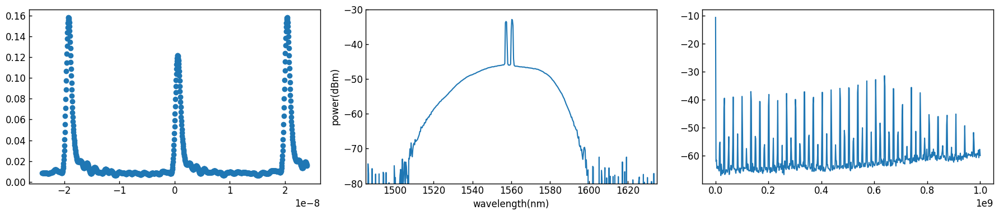

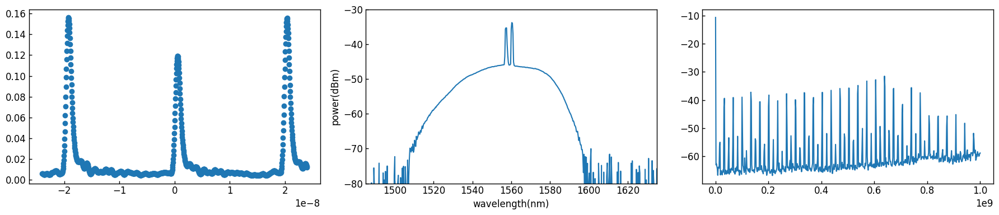

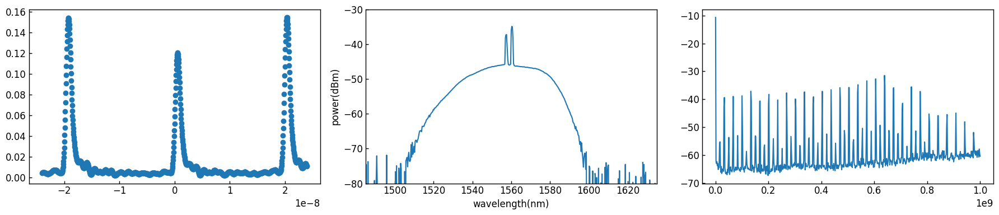

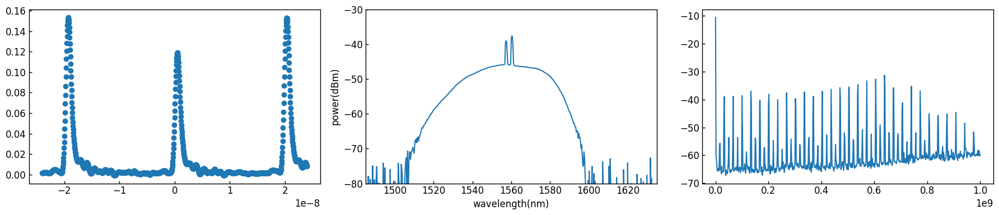

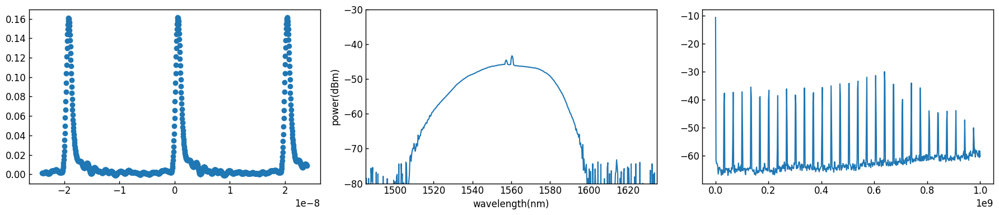

 10%|████████▎                                                                          | 1/10 [01:03<09:32, 63.60s/it]

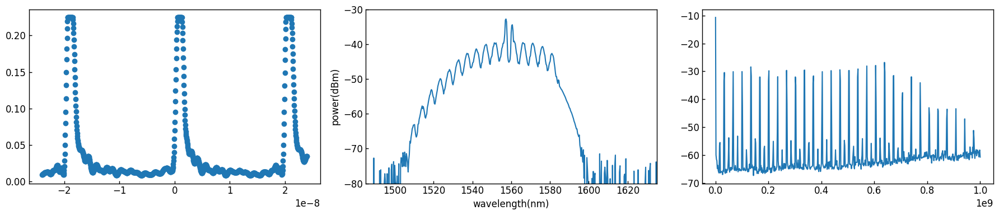

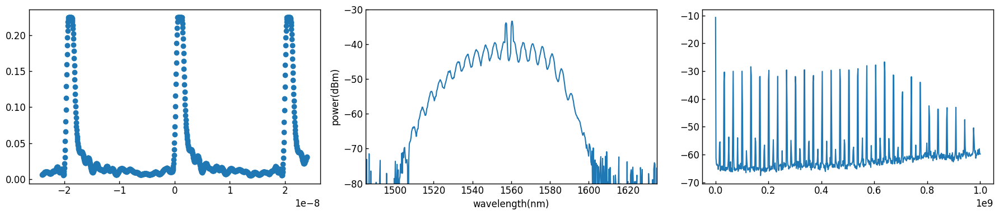

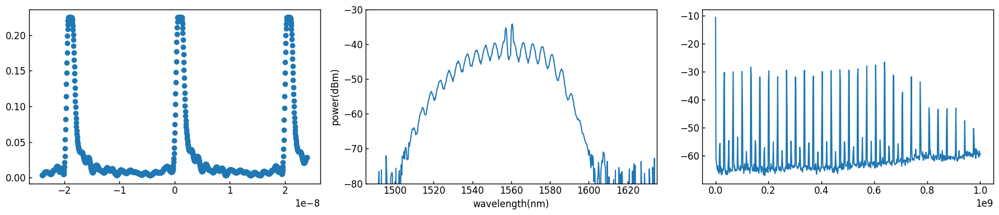

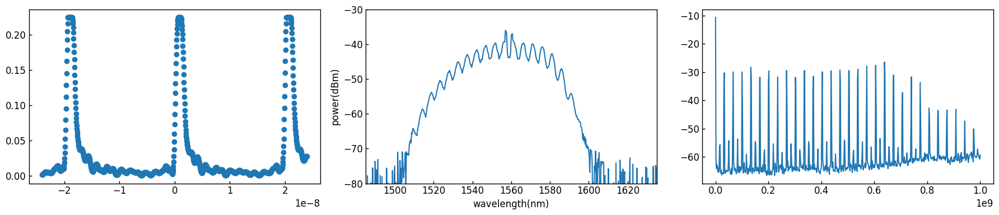

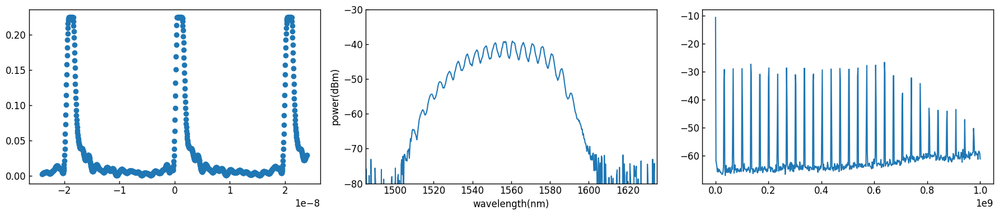

...

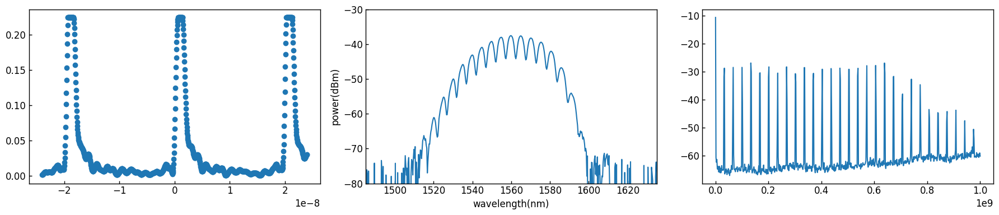

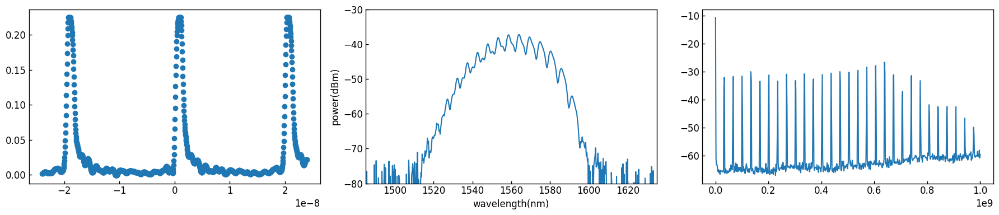

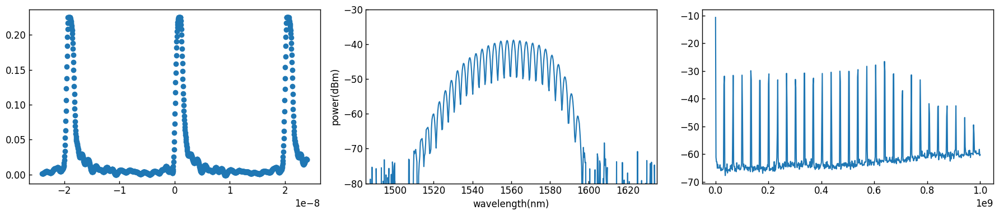

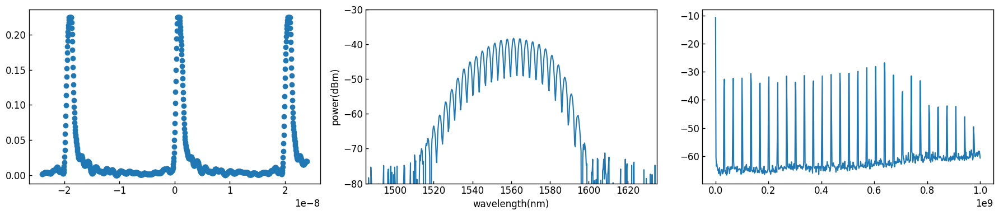

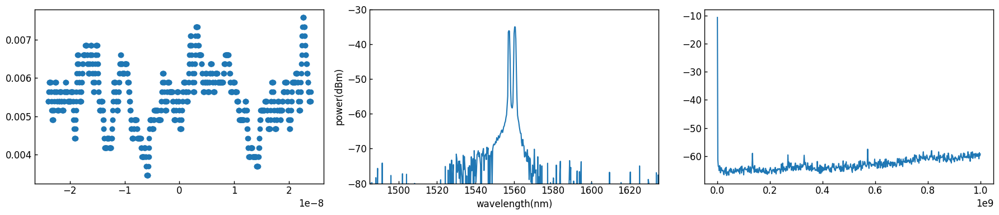

 20%|████████████████▌                                                                  | 2/10 [02:07<08:31, 63.97s/it]

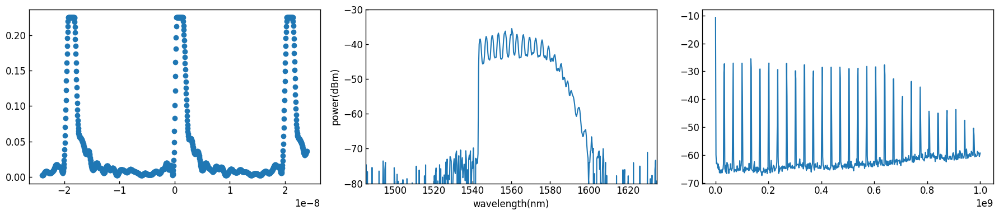

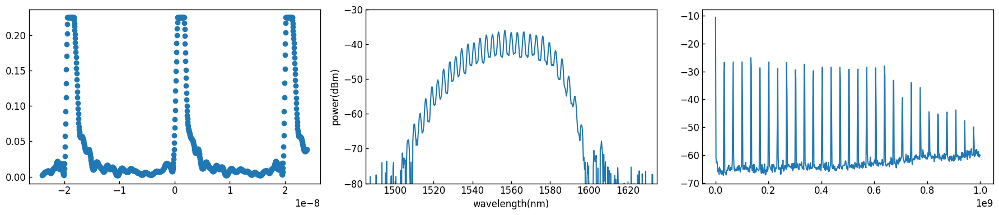

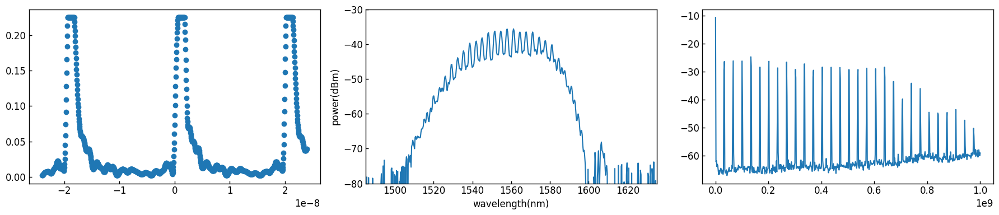

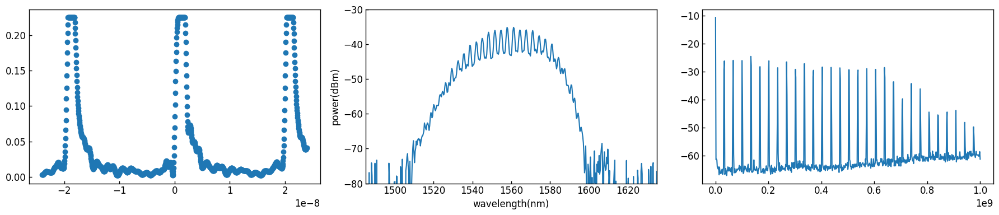

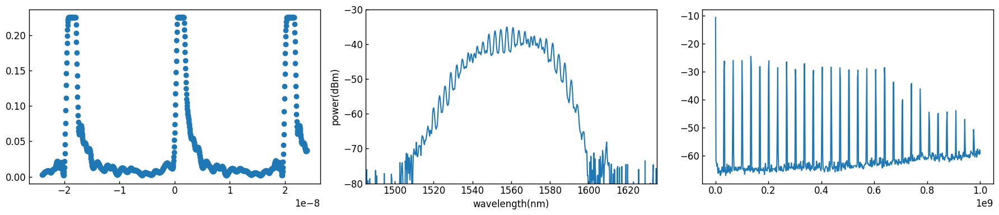

...

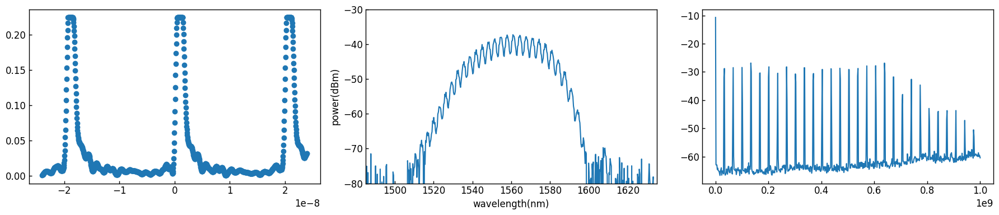

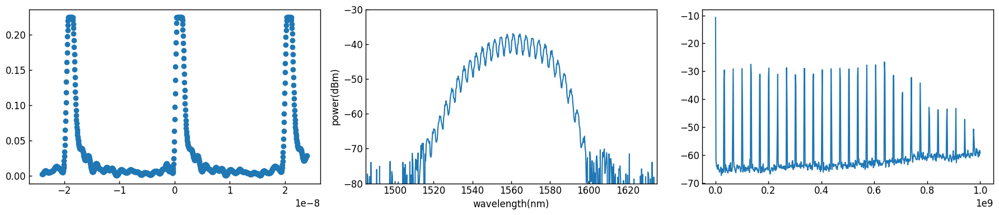

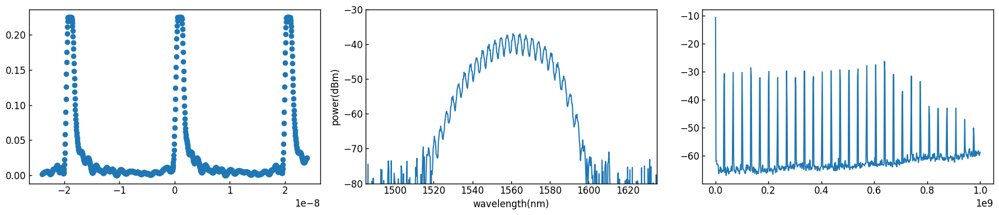

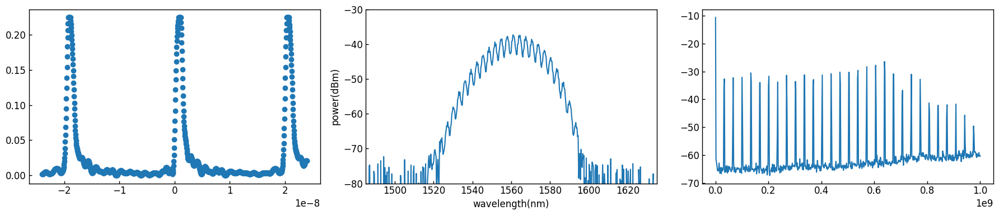

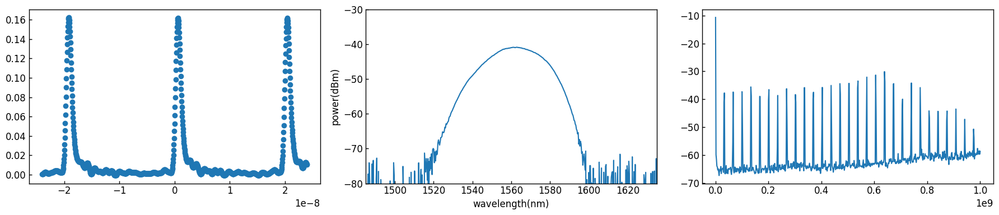

 30%|████████████████████████▉                                                          | 3/10 [03:11<07:26, 63.85s/it]

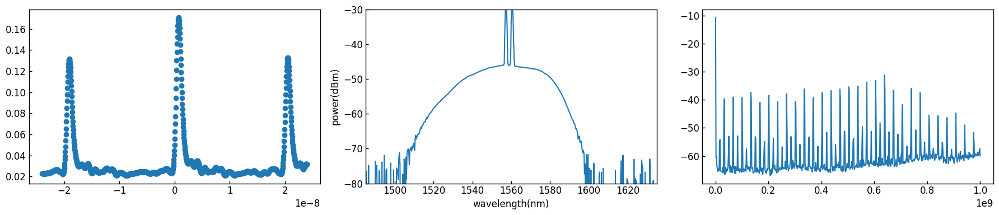

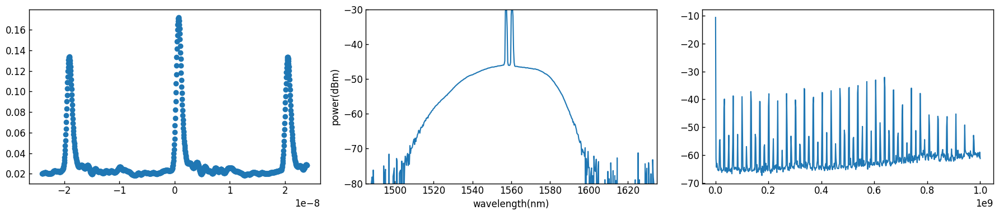

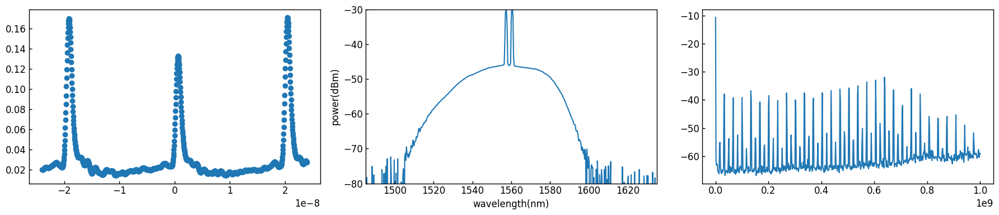

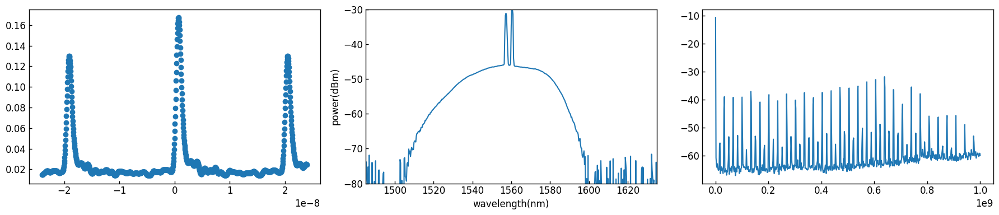

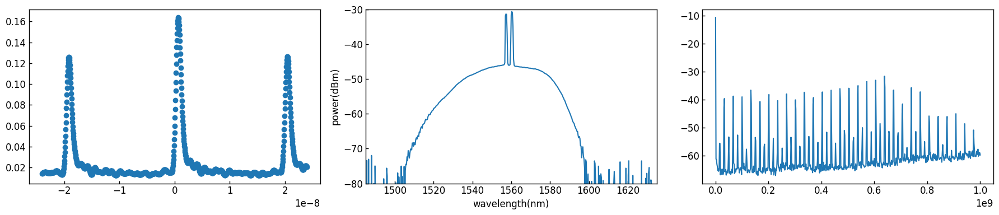

...

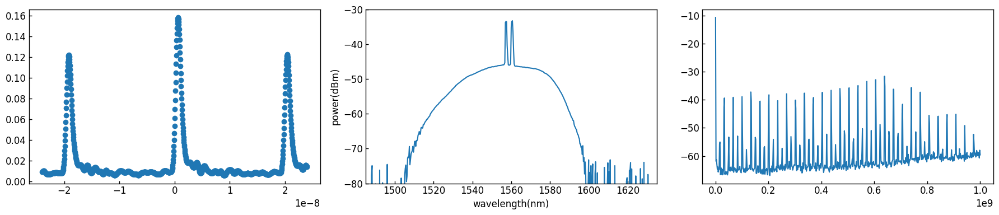

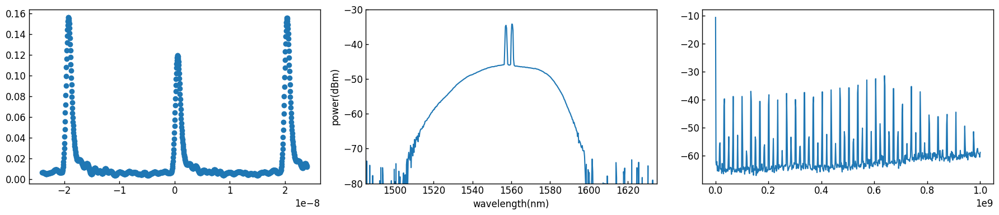

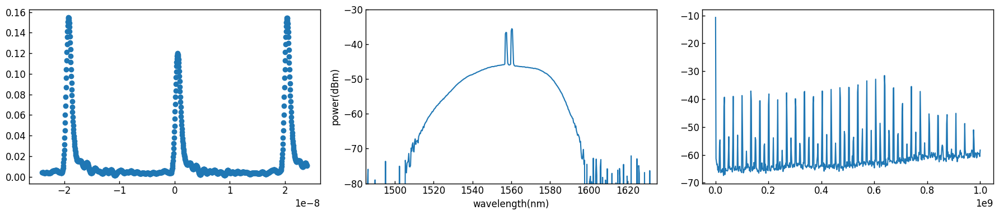

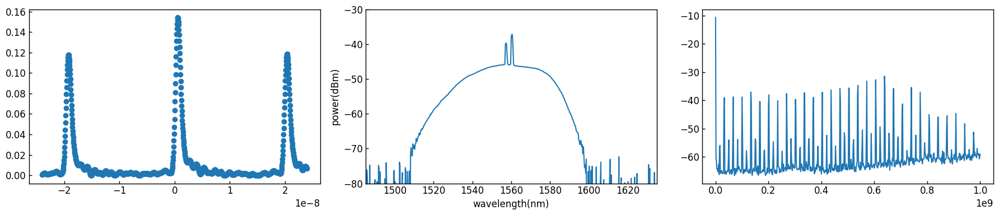

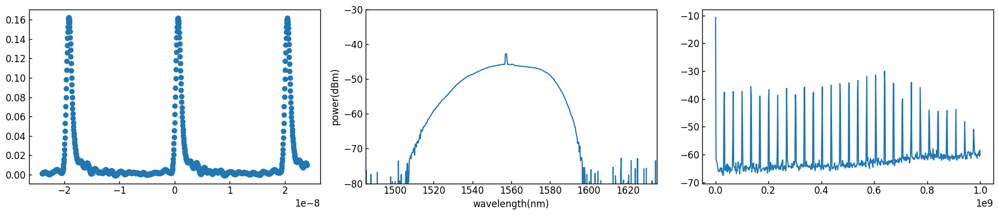

 40%|█████████████████████████████████▏                                                 | 4/10 [04:15<06:22, 63.73s/it]

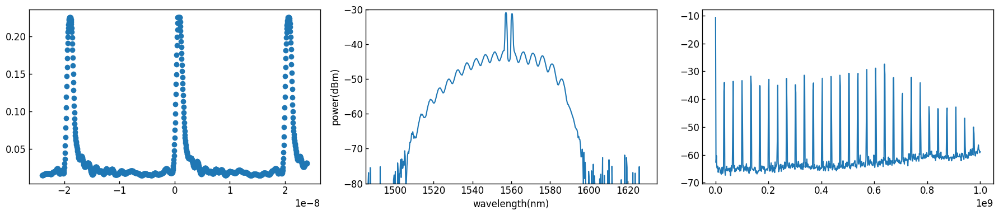

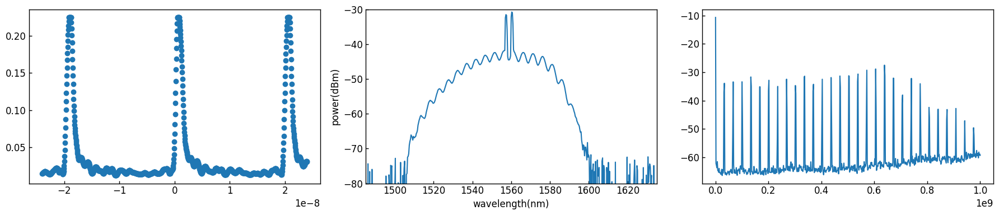

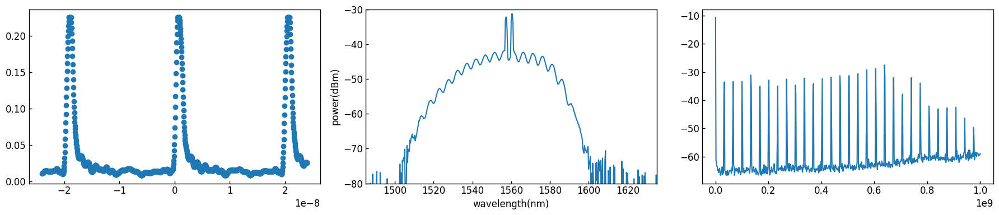

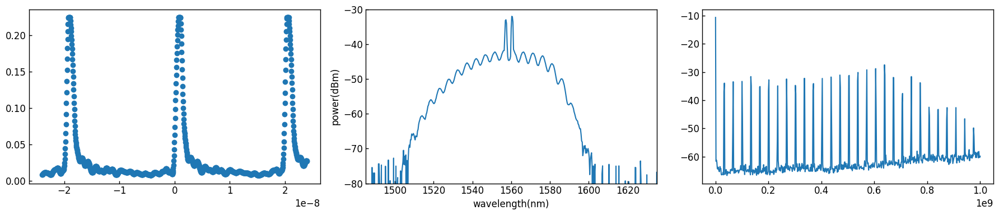

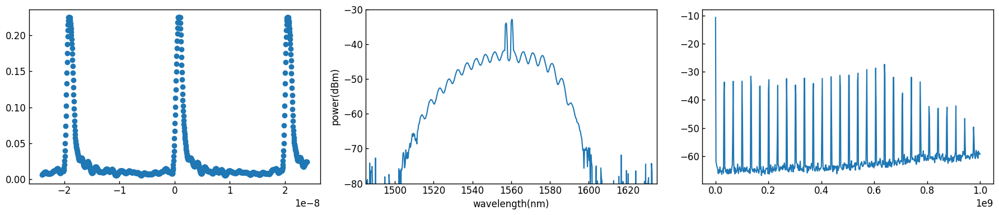

...

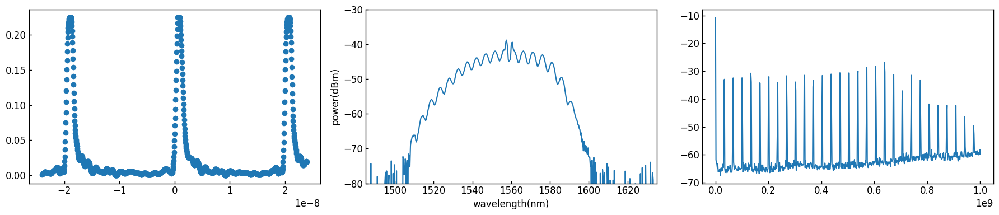

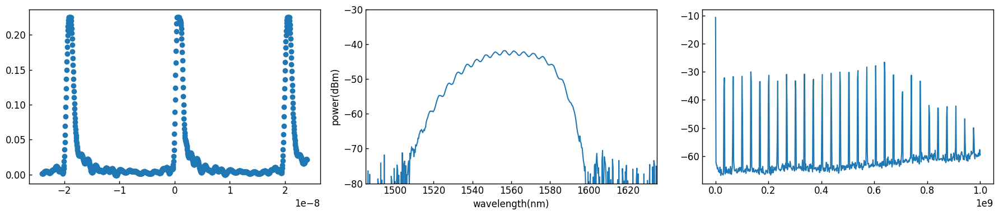

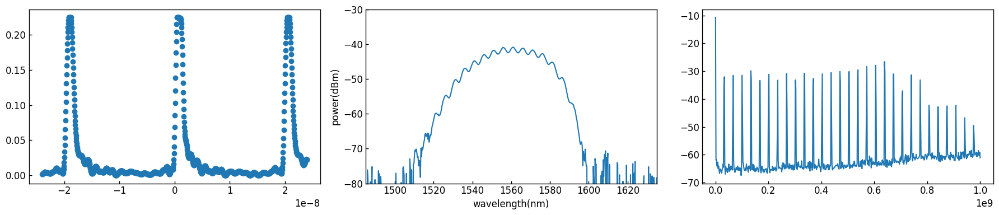

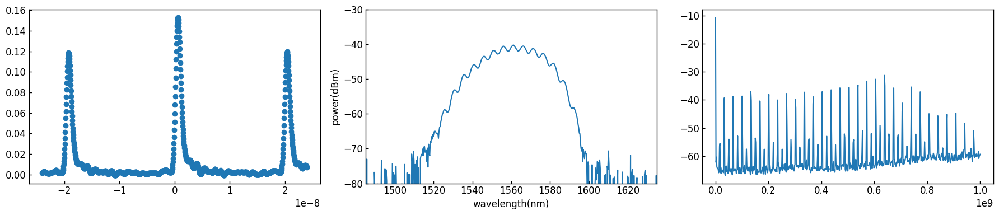

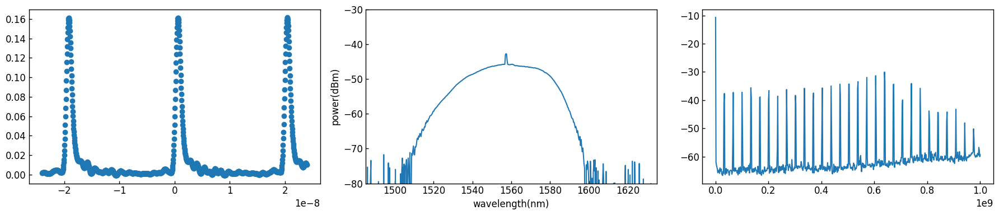

 50%|█████████████████████████████████████████▌                                         | 5/10 [05:18<05:18, 63.70s/it]

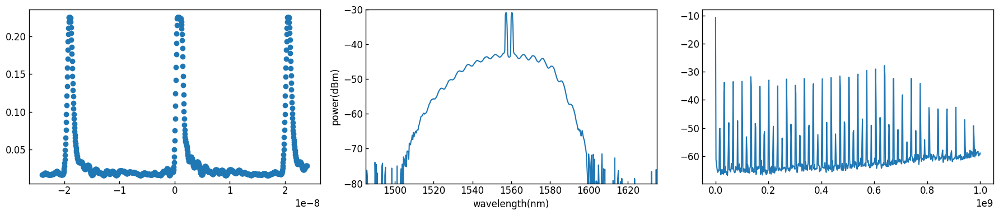

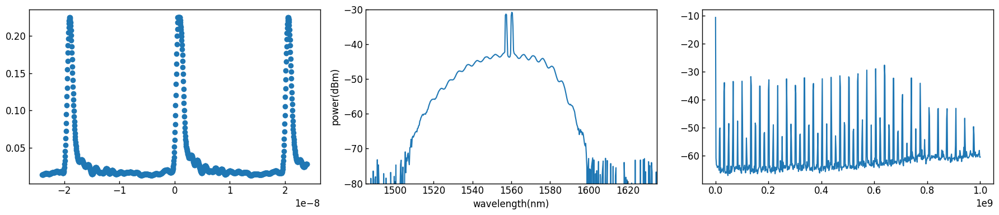

 50%|█████████████████████████████████████████▌                                         | 5/10 [05:34<05:34, 66.96s/it]


KeyboardInterrupt: 

In [ ]:
%%time

data_folder = "mode_locked_automation_analyze4"
os.makedirs(data_folder,exist_ok=True)


for i in tqdm(range(10)):
    
    with nidaqmx.Task() as out_ld_cnt_v:
            out_ld_cnt_v.ao_channels.add_ao_voltage_chan("Dev2/ao0")
            current_vol = LD_voltage
            for num, current in enumerate(current_vol):
#                 print(num)
                if num < 300 :
                    out_ld_cnt_v.write(current)
                elif num%100 == 0: 
                    out_ld_cnt_v.write(current)
                    time.sleep(0.01)
                    inst2.write("srt")# SSI single meas/SRT repeat
                    inst1.write("sing")
                    inst1.query("*opc?")
                    data_header = inst1.query("chan:data:head?")
                    rohde_data = inst1.query("chan:data?")
                    rohde_data = [float(i) for i in rohde_data.split(",")]
                    time_setting = [float(i) for i in data_header.split(",")]
                    time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
                    df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
                    df_LD_auto.index = df_LD_auto[f"time_{i}"]
                    df_LD_auto.to_csv(os.path.join(data_folder,f"automation_pulse_{i}.csv"))

                    inst2.write("DMA?")
                    data = [float(inst2.read()) for i in range(501)]
                    wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
                    wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
                    df_spectrum = pd.DataFrame({"wavelength(nm)":wl,"power(dBm)":data})
                    df_spectrum.index = df_spectrum["wavelength(nm)"]
                    df_spectrum.to_csv(os.path.join(data_folder,f"automation_spectrum_{i}.csv"))
                    
                    time.sleep(0.5)
                    rf_data = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
                    rf_frequency = np.linspace(10000,1000000000,len(rf_data))
                    rf_df = pd.DataFrame({"freq":rf_frequency,"power":rf_data})
                    rf_df.to_csv(os.path.join(data_folder,f"automation_rf_spectrum_{i}.csv"))

                    fig, ax = plt.subplots(1,3,figsize=(18,4))
                    ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])


                    ax[1].plot(df_spectrum["wavelength(nm)"],df_spectrum["power(dBm)"],label=f"number = {i}")
                    ax[1].set_xlabel("wavelength(nm)")
                    ax[1].set_ylabel("power(dBm)")
                    ax[1].set_xlim(1485,1635)
                    ax[1].set_ylim(-80,-30)

                    ax[2].plot(rf_frequency,rf_data)
#                     fig.set_title(num)
                    plt.tight_layout()
                    plt.savefig(os.path.join(data_folder,f"repetability_mode_locked_automation_{i}.png"),dpi=300)
                    plt.show()
                else:
                    out_ld_cnt_v.write(current)

In [ ]:
inst1.write("sing")

6

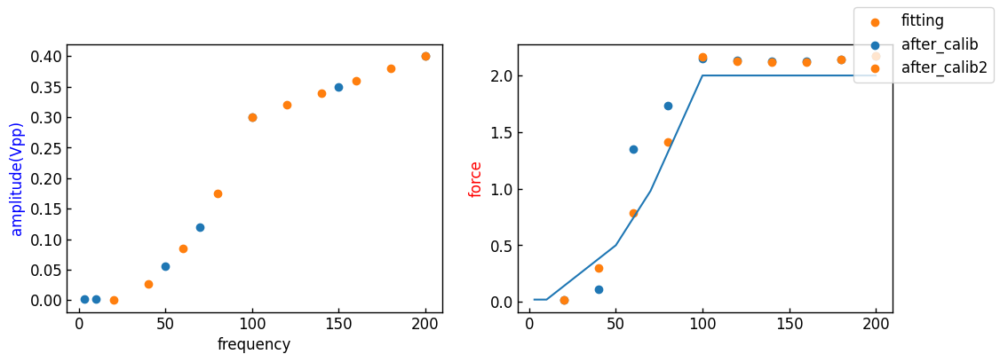

In [ ]:
freqen = [3,10,50,70,100,150,200]
force = [0.02,0.02,0.5,0.98,2,2,2]
amplitude = [0.002,0.002,0.056,0.12,0.3,0.35,0.4]#Vp-p

re_frequency = np.arange(20,200+20,20)
re_amp = [0.00072625,0.02646849,0.08463819,0.17523534,0.3,0.32,0.34,0.36,0.38,0.4]
re_force = [0.0184,0.1118,1.3520,1.7322,2.1531,2.1338,2.128,2.1284,2.1399,2.1707]

rere_force = [0.02,0.3029,0.7854,1.4155,2.1688,2.1269,2.1173,2.1174,2.1397,2.1695]

fig,ax = plt.subplots(1,2,figsize=(12,4))
ax[0].scatter(freqen,amplitude)
ax[0].scatter(re_frequency,re_amp,label="fitting")
ax[0].set_xlabel("frequency")
ax[0].set_ylabel("amplitude(Vpp)")
ax[0].yaxis.label.set_color("blue")
ax[1].plot(freqen,force)
ax[1].scatter(re_frequency,re_force,label="after_calib")
ax[1].scatter(re_frequency,rere_force,label="after_calib2")
ax[1].set_ylabel("force")
ax[1].yaxis.label.set_color("red")
fig.legend()
plt.show()

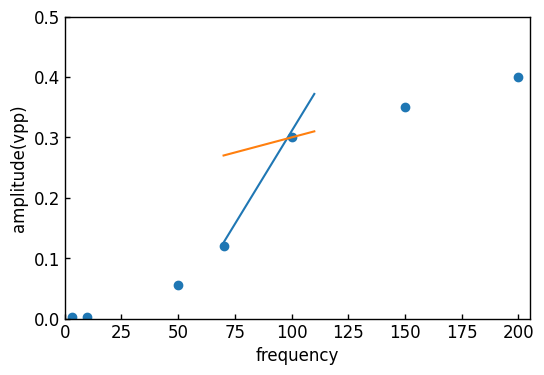

In [ ]:
from scipy.optimize import curve_fit

def y1(x,a,b):
    Y = a*x + b
    return Y

def y2(x,a,b,c):
    Y = a*x**2+b*x+c
    return Y

num = 10
#f_d = np.arange(num,200+num,num)
f_d = np.array([70,110,])

freque1 = [3,10,50,70,100]
freque2 = [100,150,200]

amp1 = [0.002,0.002,0.056,0.12,0.3]
amp2 = [0.3,0.35,0.4]

popt1, pcov1 = curve_fit(y2,freque1,amp1)
popt2, pcov2 = curve_fit(y1,freque2,amp2)

plt.scatter(freqen,amplitude)

plt.plot(f_d,y2(f_d,*popt1))
plt.plot(f_d,y1(f_d,*popt2))

plt.xlabel("frequency")
plt.ylabel("amplitude(vpp)")
plt.ylim(0,0.5)
plt.xlim(0,205)

plt.show()

          low  high  input_amplitude
70   0.125883  0.27         0.125883
110  0.371933  0.31         0.310000
2


<AxesSubplot:>

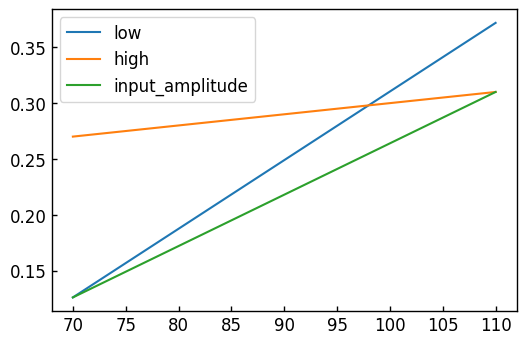

In [ ]:
amp_df = pd.DataFrame(index=f_d,data={"low":y2(f_d,*popt1),"high":y1(f_d,*popt2)})
amp_df.loc[amp_df.index > 0,"input_amplitude"] = 0.002
amp_df.loc[amp_df.index > 20,"input_amplitude"] = amp_df["low"]
amp_df.loc[amp_df.index > 100,"input_amplitude"] = amp_df["high"]

print(amp_df)
print(len(amp_df))

amp_df.plot()

## force sensor 確認

In [ ]:
# function generator

# instruments setup

# optical spectrum analyzer MS9710C
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst3 = rm.open_resource("USB0::0x0D4A::0x000E::9282780::INSTR",read_termination="\n")
inst3.query("*IDN?")

'NF Corporation,WF1948,9282780,Ver1.50'

In [ ]:
inst3.write("output:state ON") 
inst3.query("output:state?")
time.sleep(1)
inst3.write("output:state OFF")

18

In [ ]:
inst3.query("source:volt:immediate:unit?")

'VPP'

In [ ]:
import winsound
winsound.Beep(800,1000)
winsound.Beep(800,500)

In [ ]:
Vpp = amp_df["input_amplitude"]
Freq = amp_df.index

In [ ]:
inst3.write("output:state ON") 
for Vpp_,freq_ in zip(Vpp,Freq):
    print(Vpp_,freq_)
    inst3.write("source:volt:immediate:unit VPP")
    inst3.write(f"source:volt:immediate:amplitude {Vpp_}")
#     inst3.query("source:freq?")
    inst3.write(f"source:freq {freq_}")
#     winsound.Beep(800,1000)
#     time.sleep(35)
#     winsound.Beep(800,1000)
#     winsound.Beep(800,500)
    time.sleep(10)
inst3.write("output:state OFF")

0.002 10
0.002 20
0.00954393859583931 30
0.026468494043686015 40
0.05149991145499343 50
0.08463819082976155 60
0.12588333216799036 70
0.17523533546967993 80
0.23269420073483013 90
0.3 100
0.31 110
0.31999999999999995 120
0.32999999999999996 130
0.33999999999999997 140
0.35 150
0.36 160
0.37 170
0.38 180
0.39 190
0.4 200


18

In [ ]:
for freq in FG_frequency:
    inst3.query("source:freq?")
    inst3.write(f"source:freq {freq}")
    time.sleep(1)

In [ ]:
inst3.close()

In [ ]:
FG_frequency = np.arange(3,204,10)
FG_frequency

array([  3,  13,  23,  33,  43,  53,  63,  73,  83,  93, 103, 113, 123,
       133, 143, 153, 163, 173, 183, 193, 203])

In [ ]:
inst3.query("source:function?")
inst3.write("source:voltage:immediate:high")
inst3.query("source:voltage:immediate:high?"),inst3.query("source:voltage:immediate:low?")

('1.00E-2', '-2.000E-1')

In [ ]:
inst1.close()

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:02<00:00, 39.13it/s]


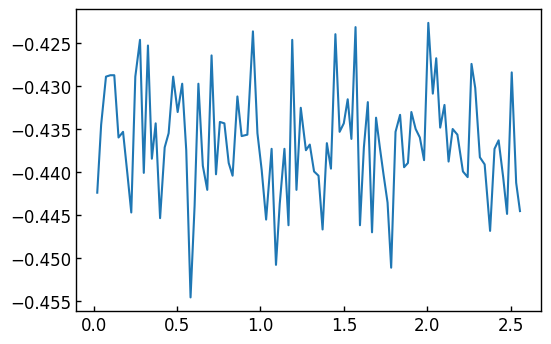

Wall time: 2.65 s


In [ ]:
%%time
data = []
time_data = []
start = time.perf_counter()
for i in tqdm(range(100)):
    with nidaqmx.Task() as photo_p:
        photo_p.ai_channels.add_ai_voltage_chan("Dev2/ai1")
        data = np.append(data,photo_p.read())
        time_data = np.append(time_data,time.perf_counter()-start)
        time.sleep(0.001)
        
plt.plot(time_data,data)
plt.show()

### RF spectrum RIGOL

In [ ]:
# optical spectrum analyzer MS9710C
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst4 = rm.open_resource("USB0::0x1AB1::0x0960::DSA8A182801130::INSTR",read_termination="\n")
inst4.query("*IDN?")

'Rigol Technologies,DSA815,DSA8A182801130,00.01.16.00.03'

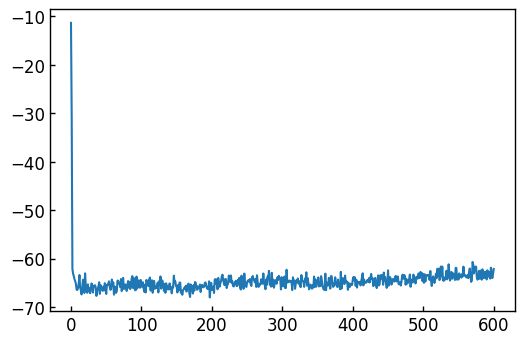

In [ ]:
rf_data = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
plt.plot(rf_data)

In [ ]:
print(inst4.query("freq:star?"),inst4.write("freq:stop 1000000000"),inst4.query("band:res?"))

0 22 1000000


 ### MS2691A

In [ ]:
# RF SPECTRUM Analyzer MS2691A
rm = pyvisa.ResourceManager()
visa_list = rm.list_resources()
inst5 = rm.open_resource("GPIB0::5::INSTR",read_termination="\r\n")
inst5.query('*IDN?')

'ANRITSU,MS2691A,6201027428,7.04.00'

In [ ]:
inst5.write("*rst")

6

In [ ]:
rf_freq = [10000,1e9,10001]
rf_frequency = np.linspace(*rf_freq)
inst5.write("trace:mode Spec")
inst5.write(f"freq:start {rf_freq[0]};freq:stop {rf_freq[1]}")
inst5.write(f"sweep:points {rf_freq[2]}")
inst5.write("init:mode:sing")
rf_frequency

array([1.00000000e+04, 1.09999000e+05, 2.09998000e+05, ...,
       9.99800002e+08, 9.99900001e+08, 1.00000000e+09])

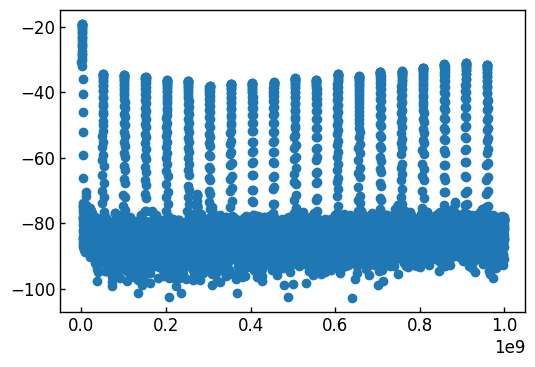

In [ ]:
rf_data = [float(i) for i in inst5.query("trac? trac1").split(",")]
rf_data
rf_frequency 
plt.scatter(rf_frequency,rf_data)
plt.show()

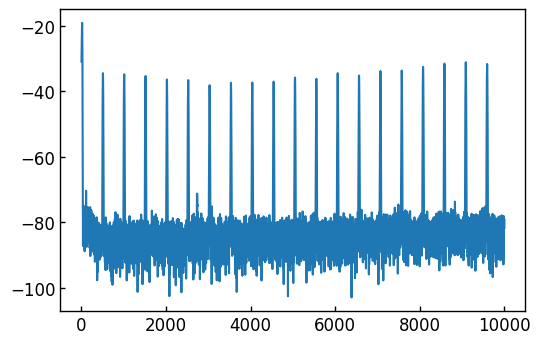

In [ ]:
rf_data = [float(i) for i in inst5.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
plt.plot(rf_data)

## auto measurement during vibration

0it [00:00, ?it/s]

0.002 10


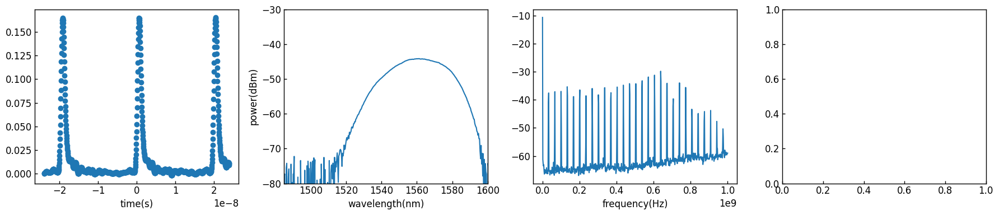

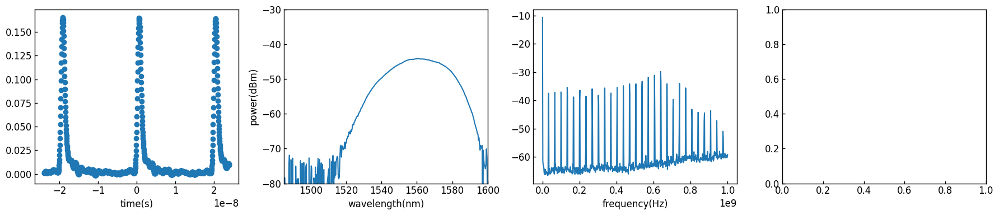

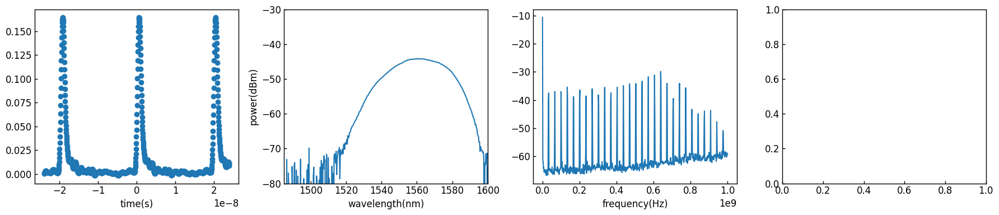

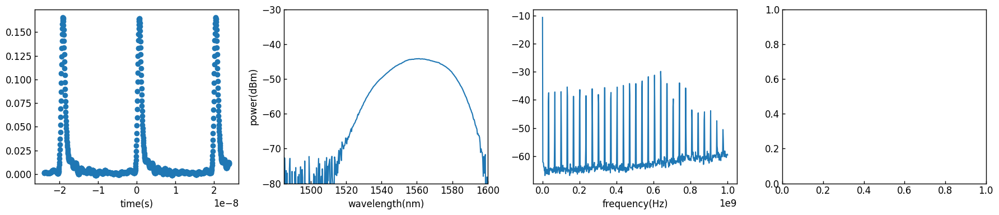

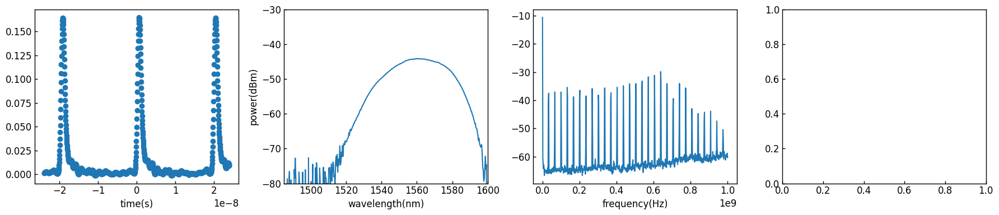

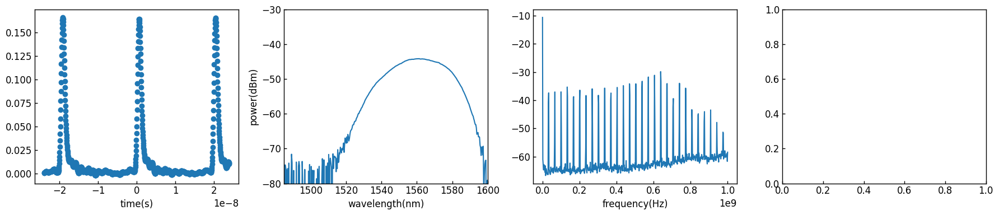

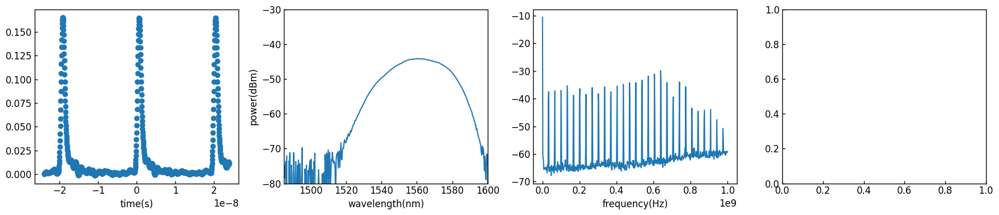

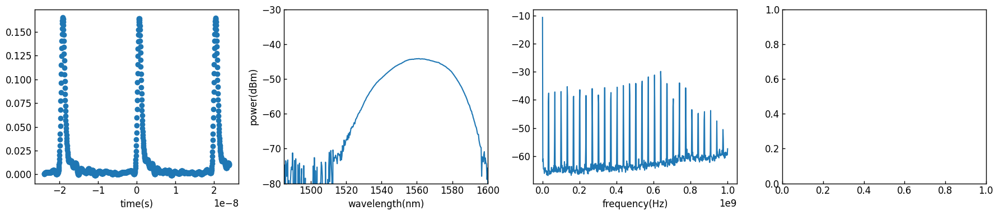

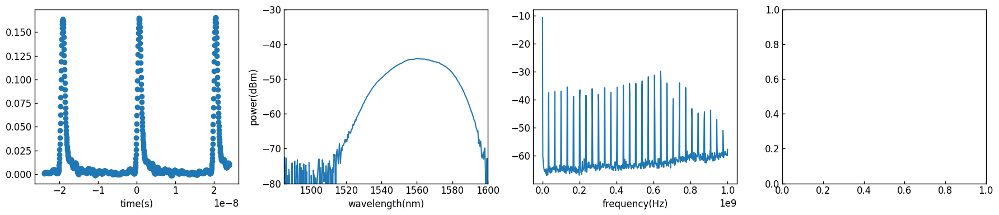

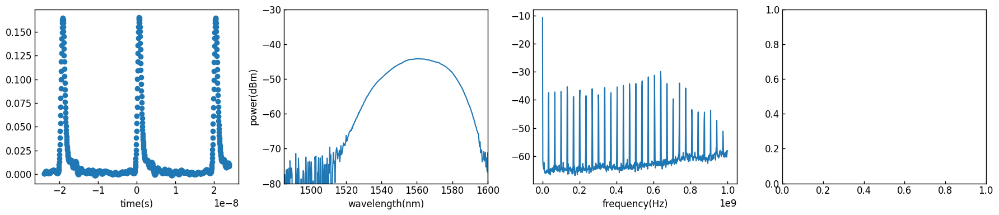

1it [00:46, 46.41s/it]

0.002 20


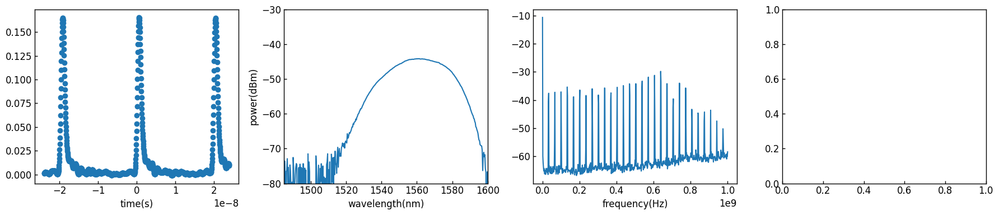

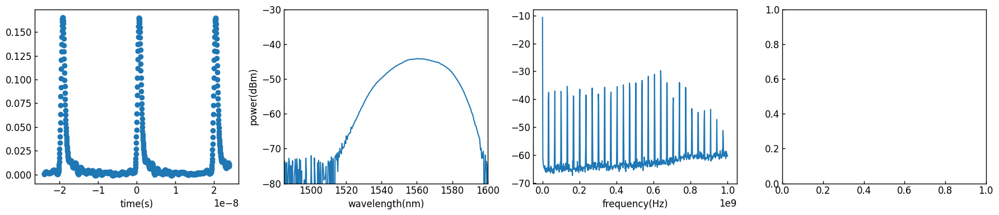

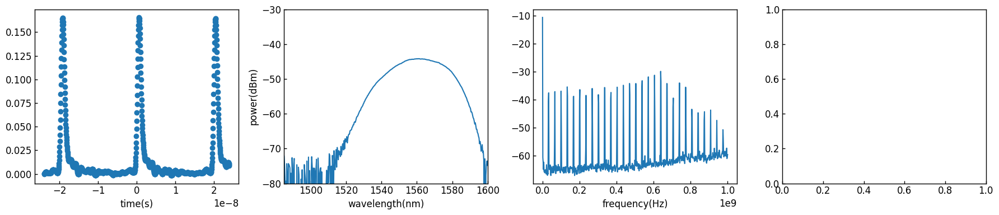

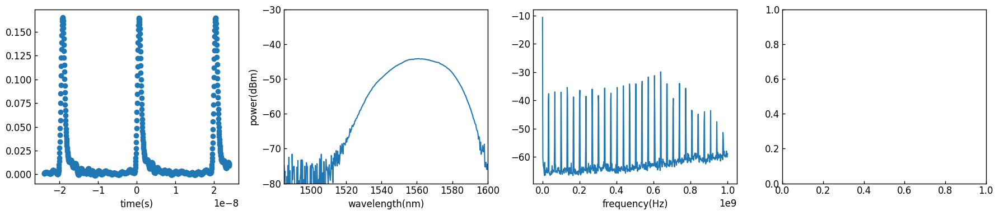

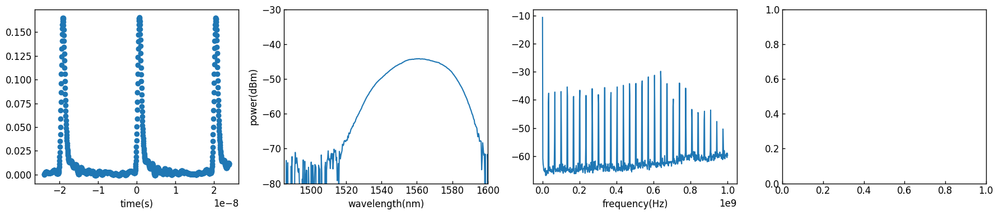

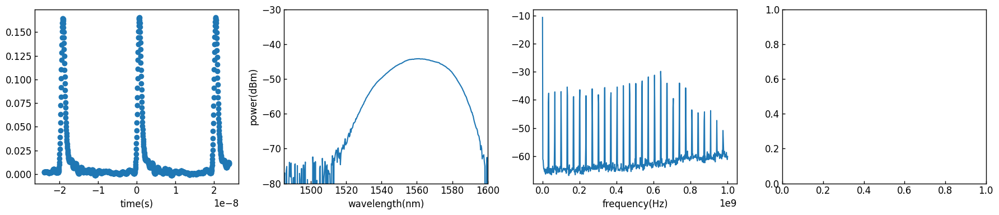

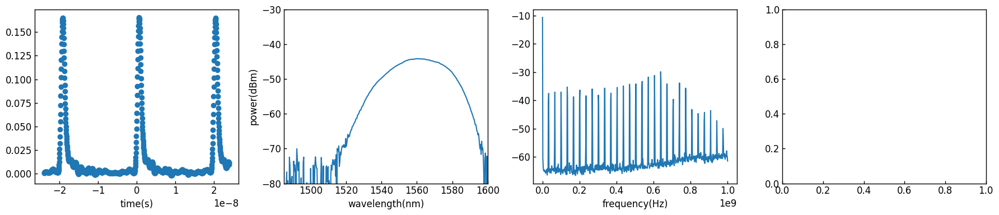

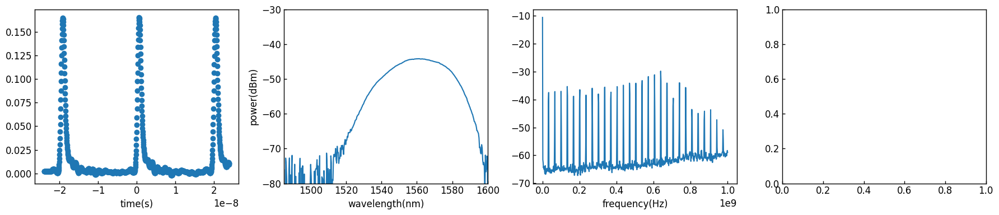

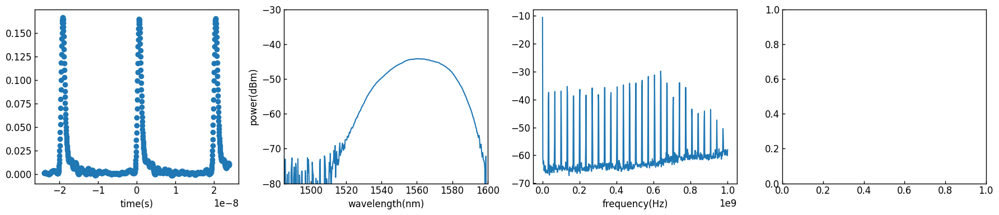

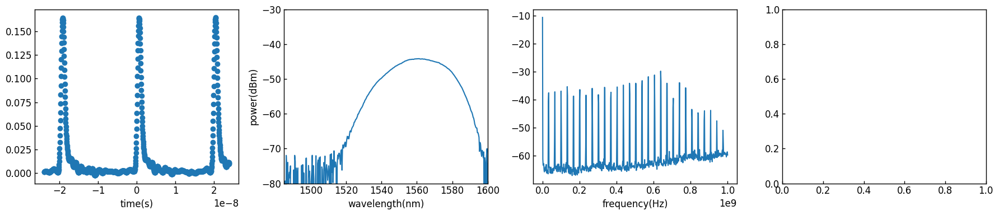

2it [01:32, 46.38s/it]

0.00954393859583931 30


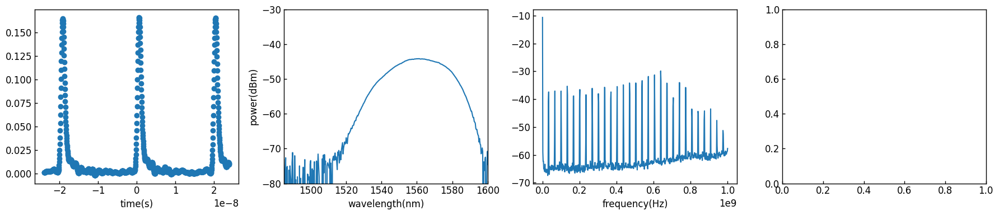

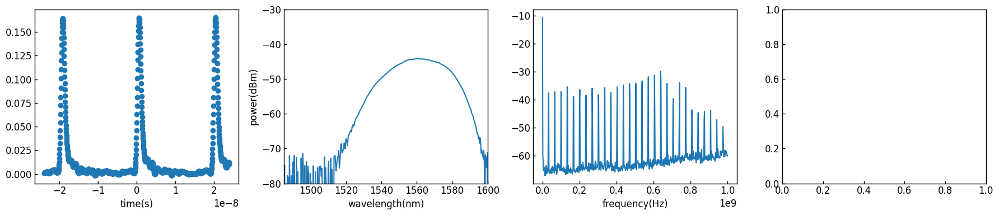

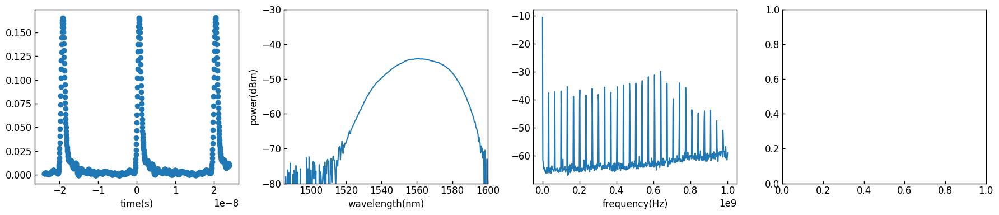

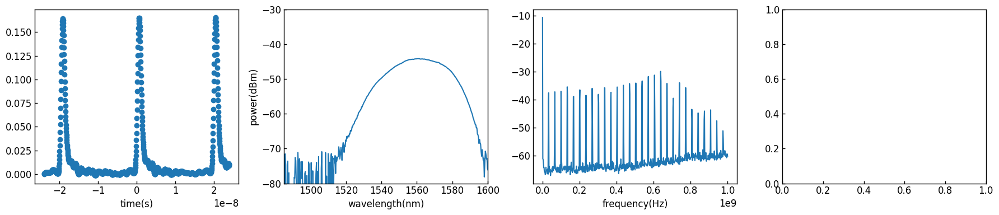

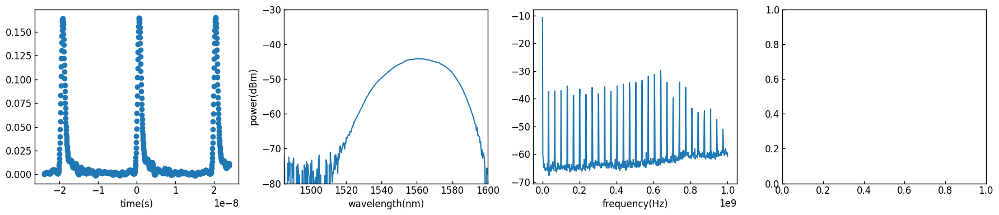

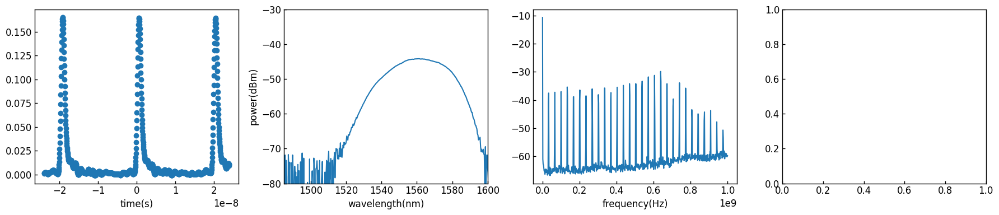

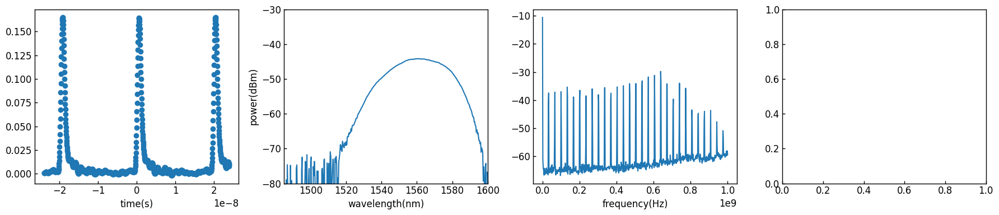

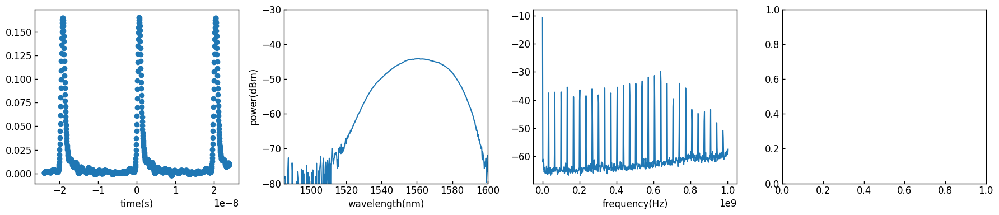

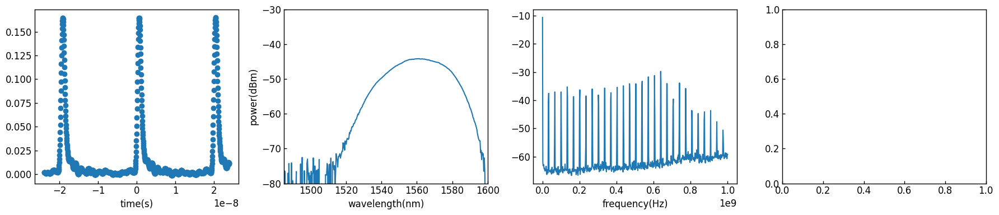

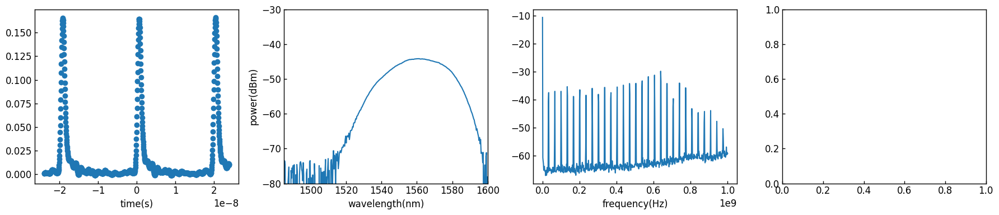

3it [02:19, 46.31s/it]

0.026468494043686015 40


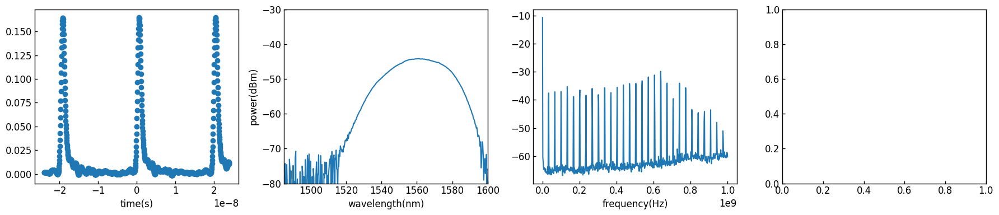

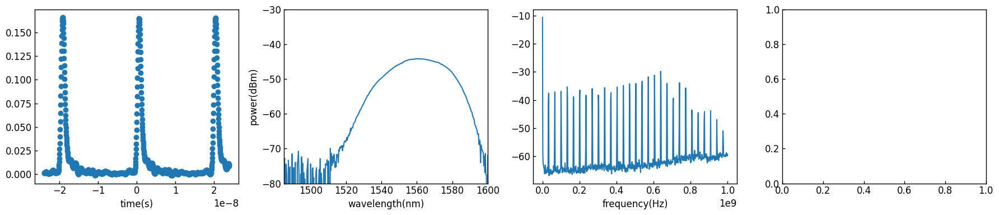

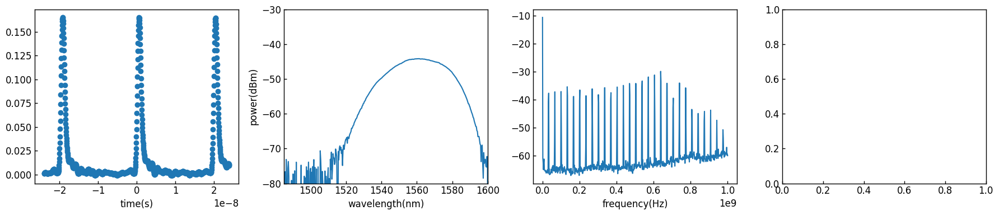

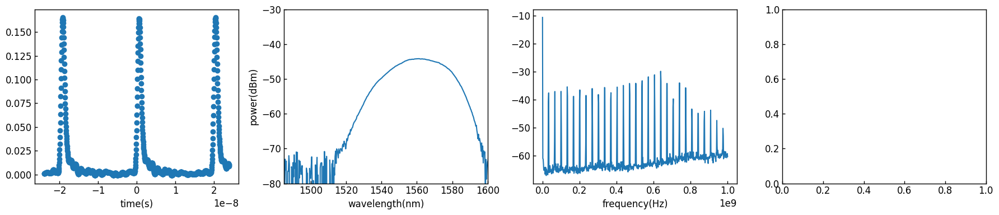

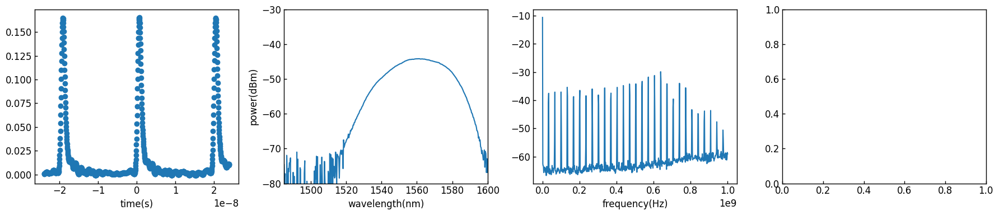

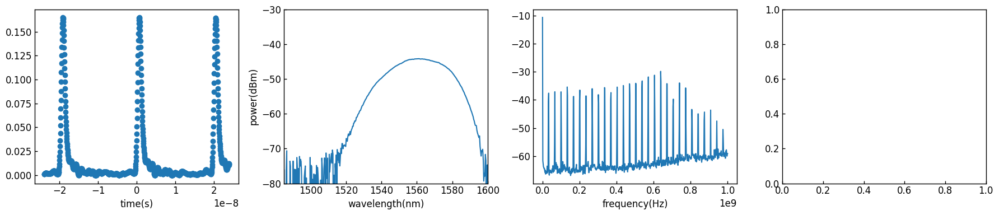

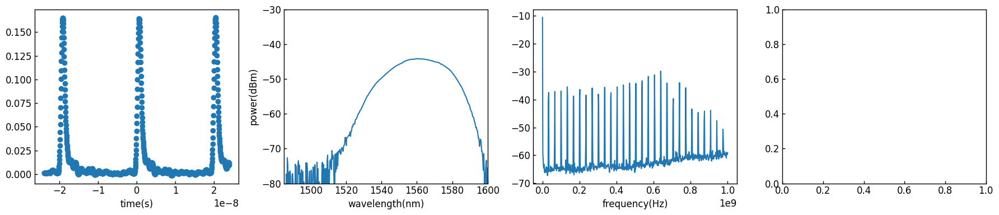

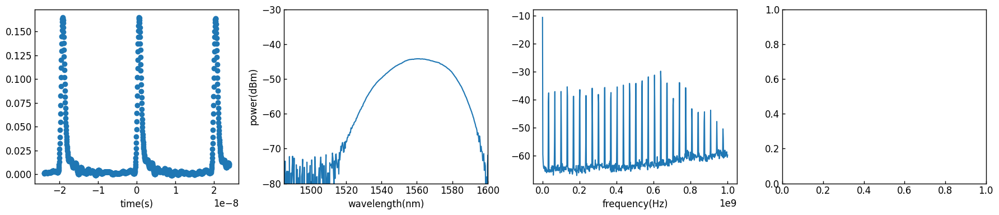

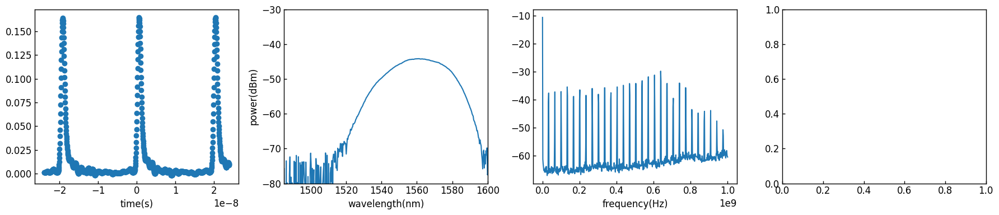

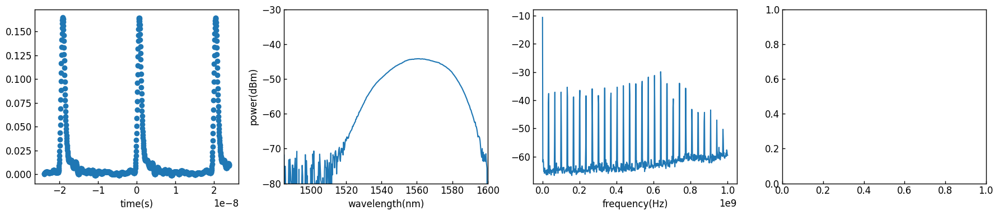

4it [03:05, 46.21s/it]

0.05149991145499343 50


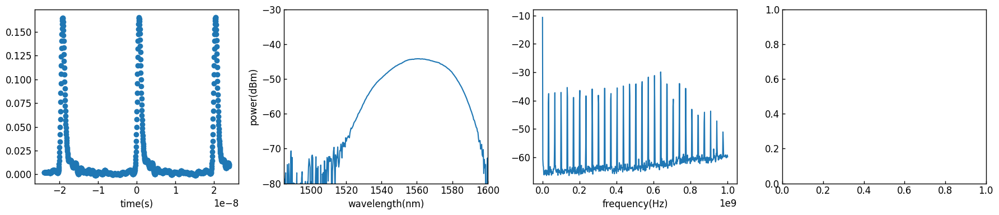

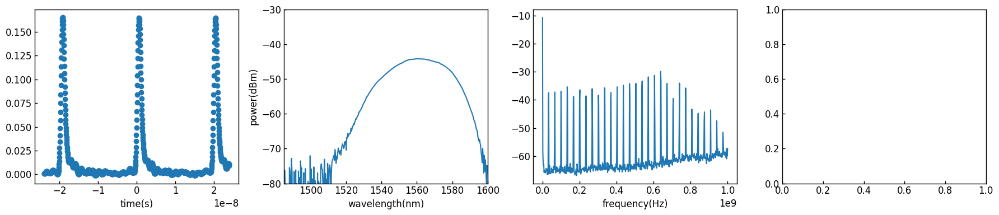

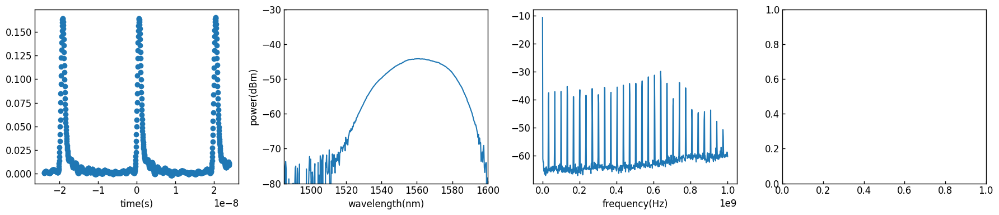

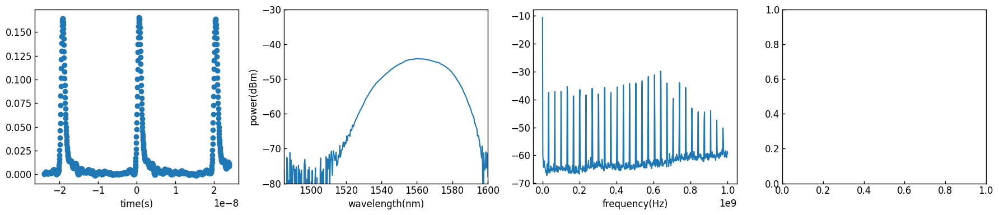

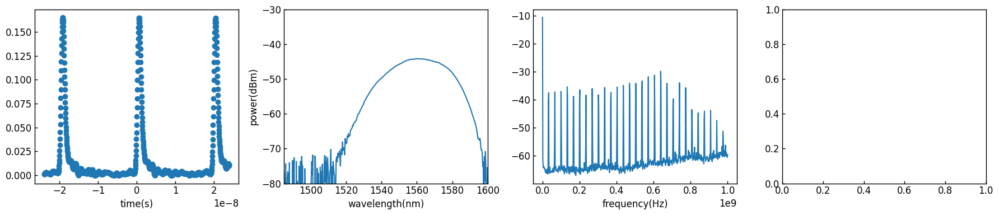

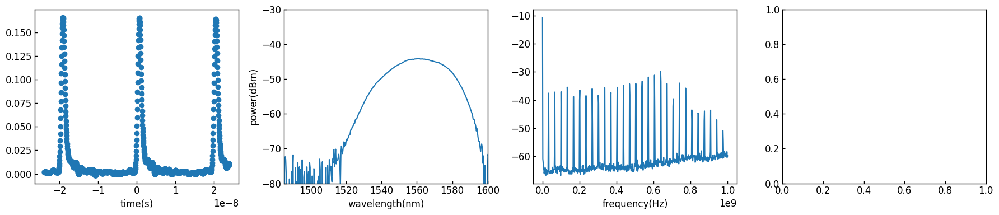

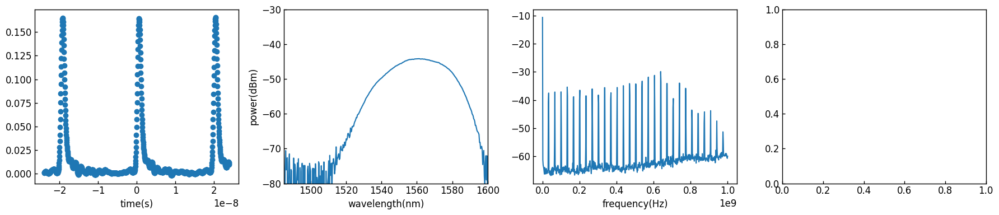

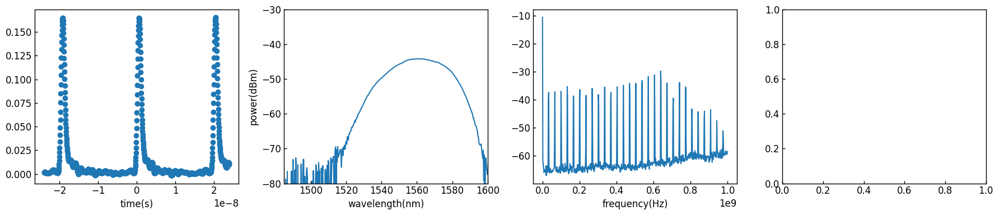

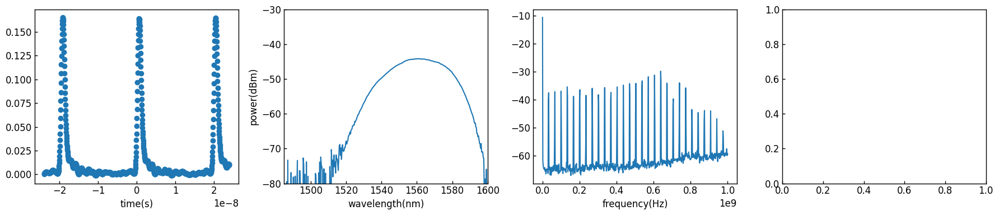

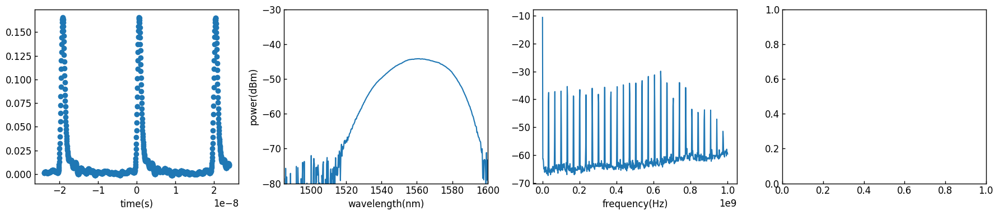

5it [03:51, 46.33s/it]

0.08463819082976155 60


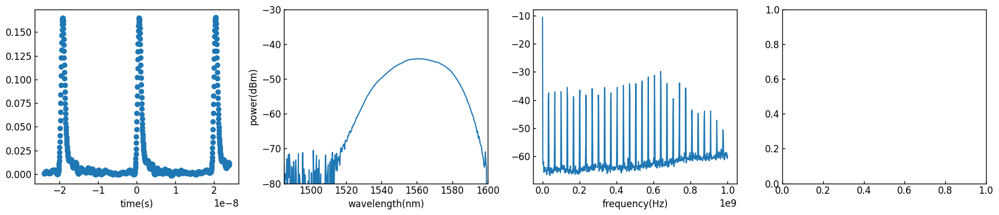

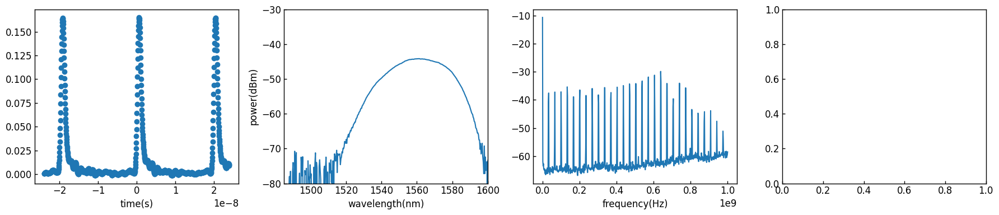

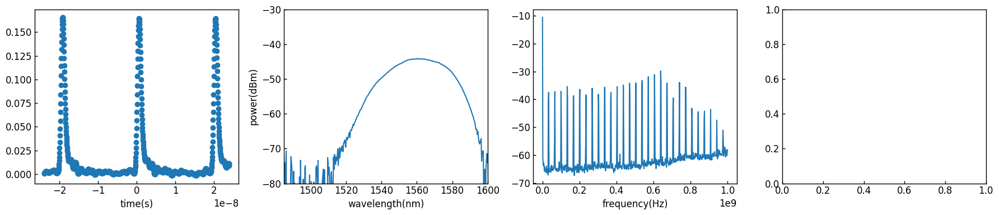

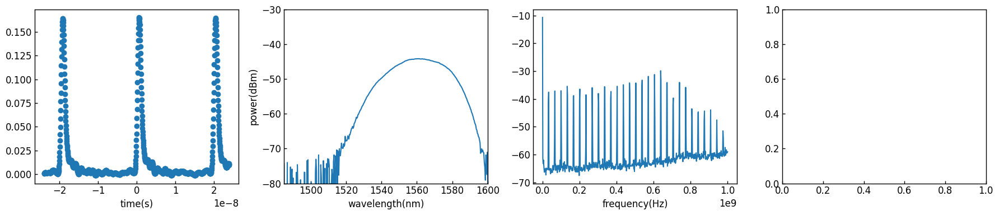

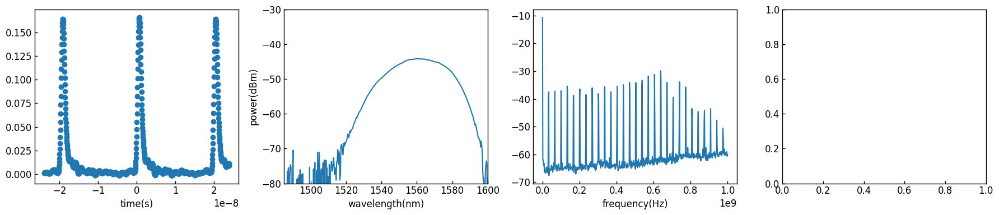

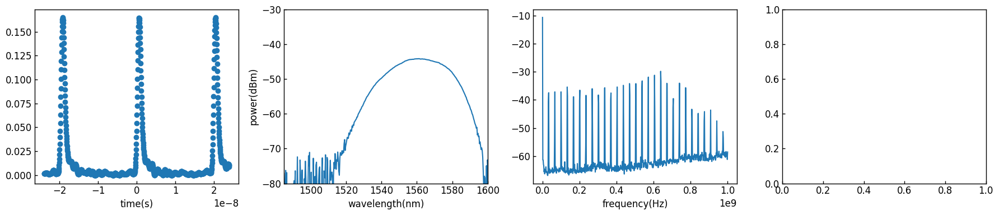

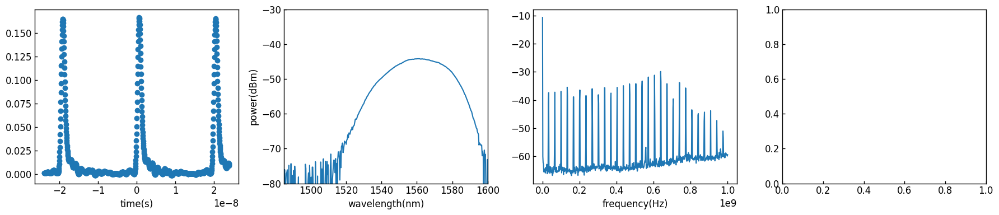

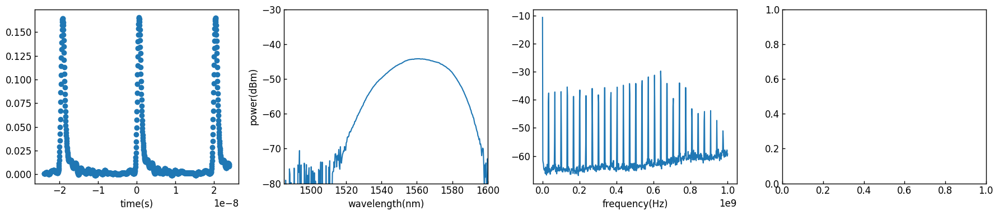

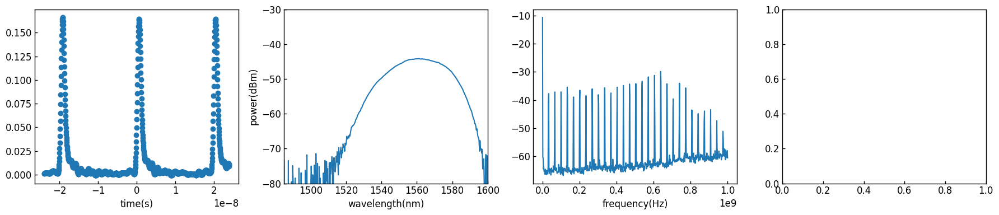

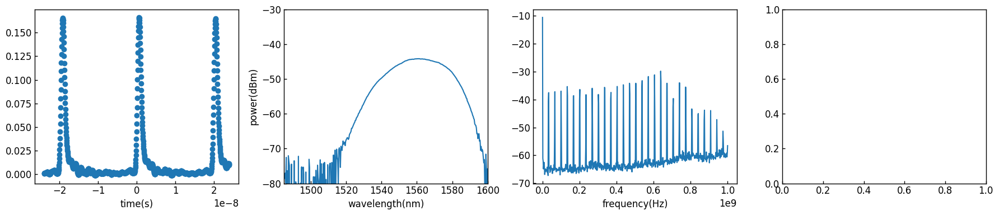

6it [04:38, 46.37s/it]

0.12588333216799036 70


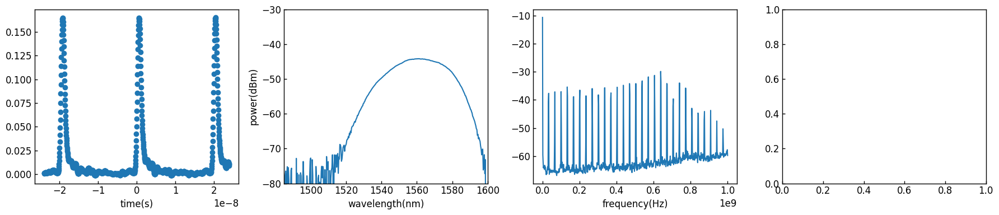

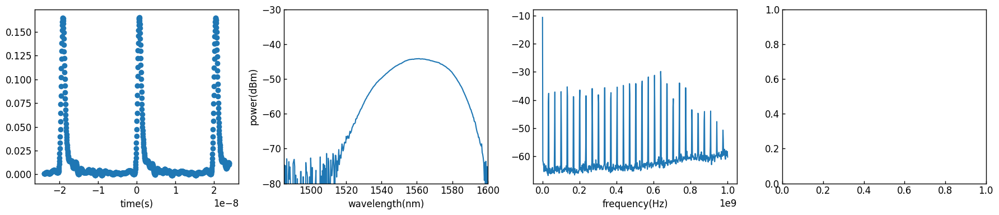

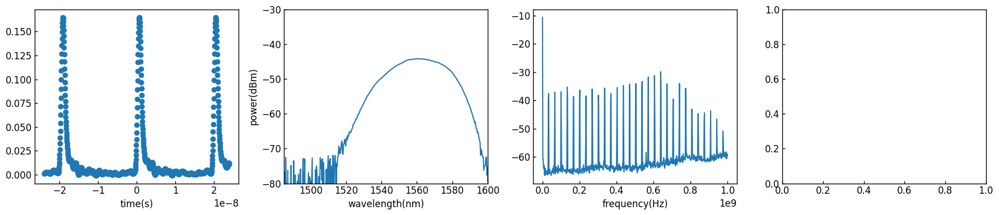

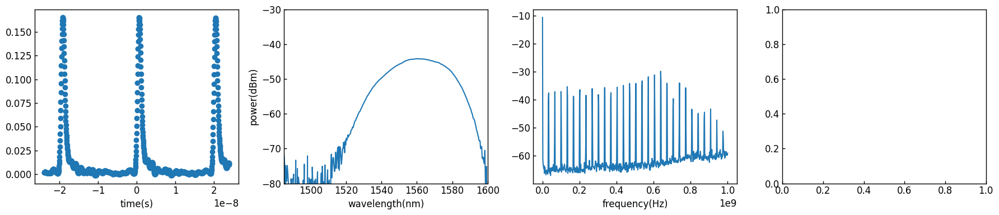

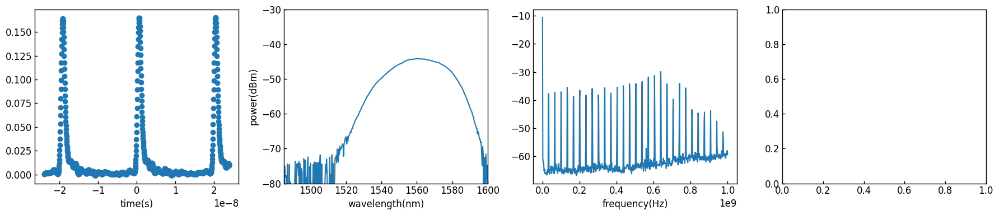

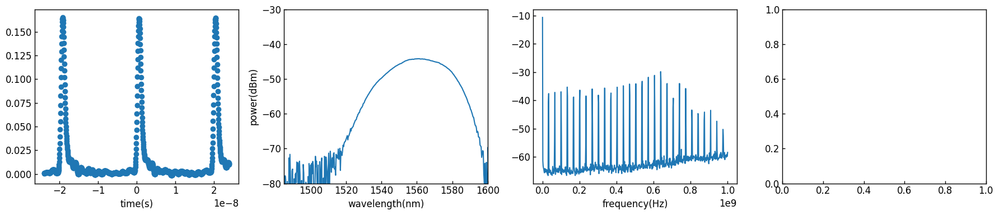

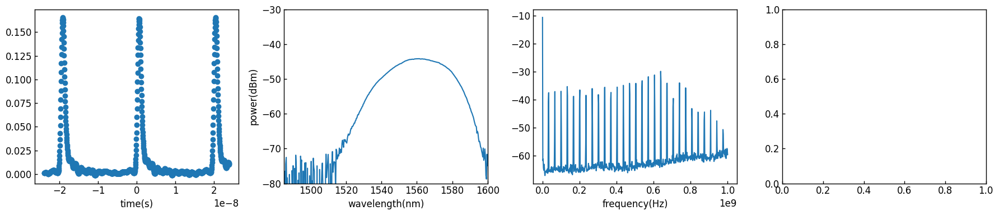

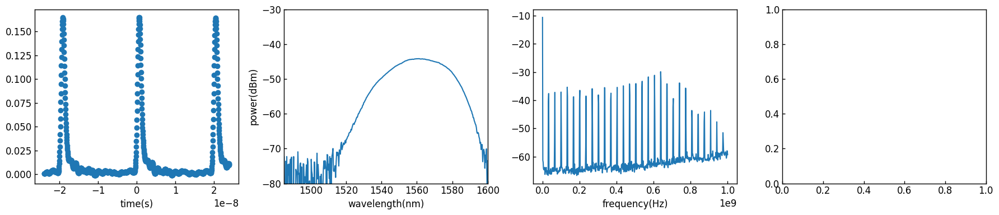

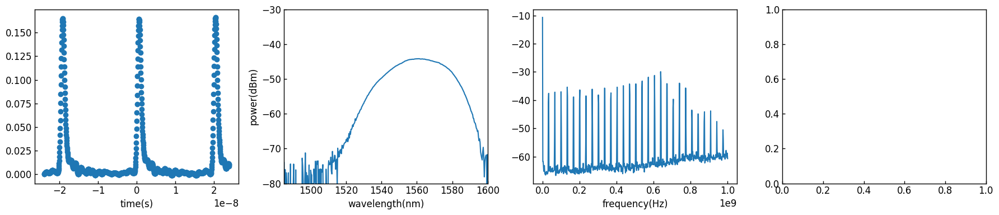

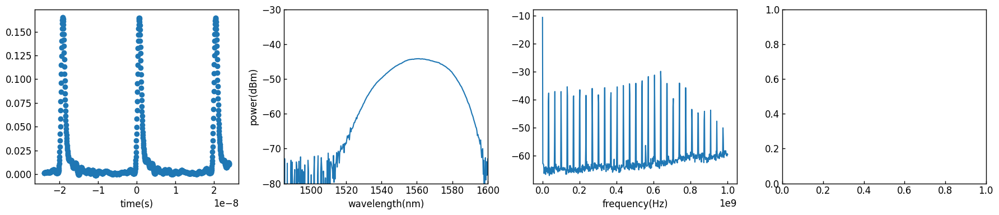

7it [05:24, 46.28s/it]

0.17523533546967993 80


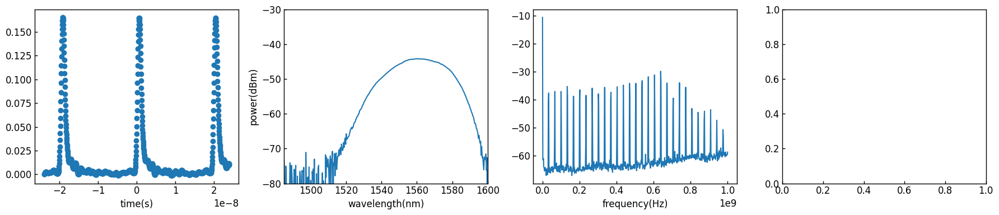

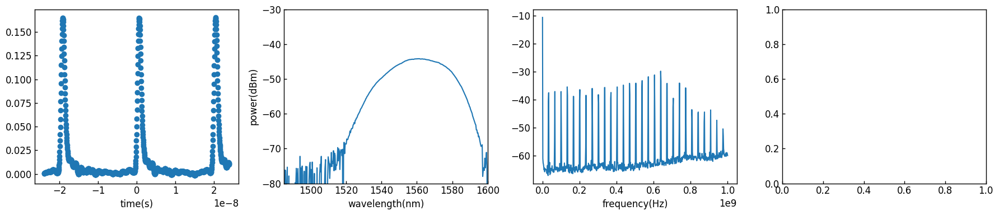

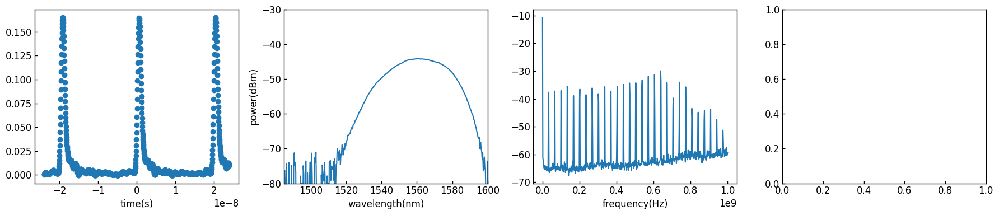

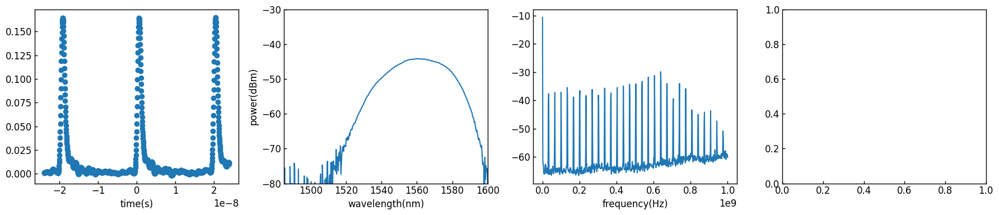

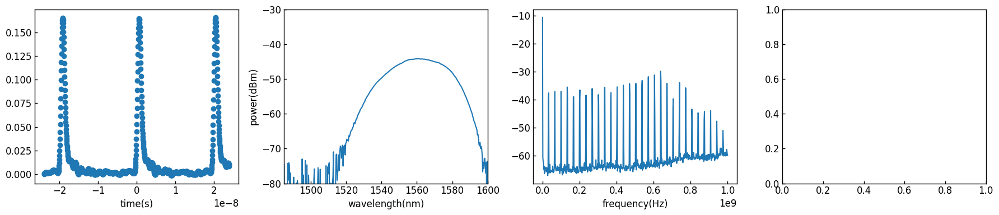

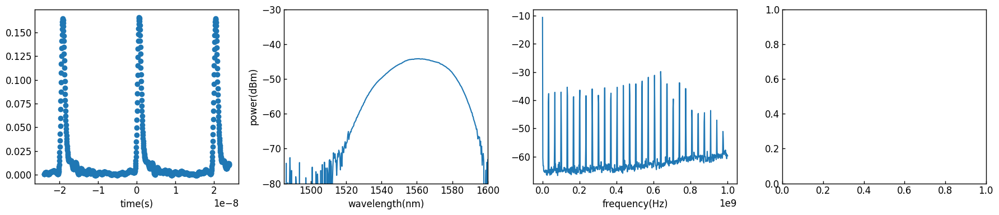

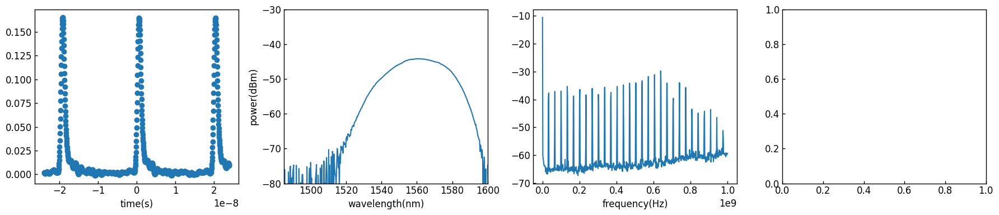

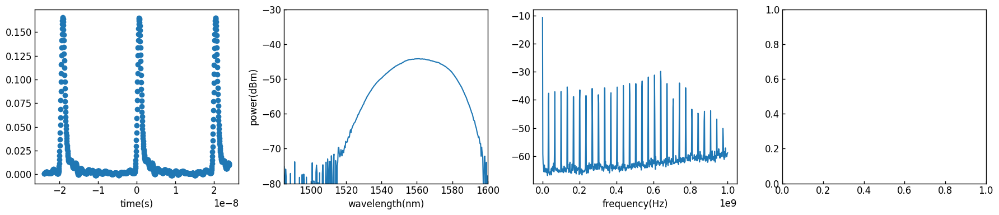

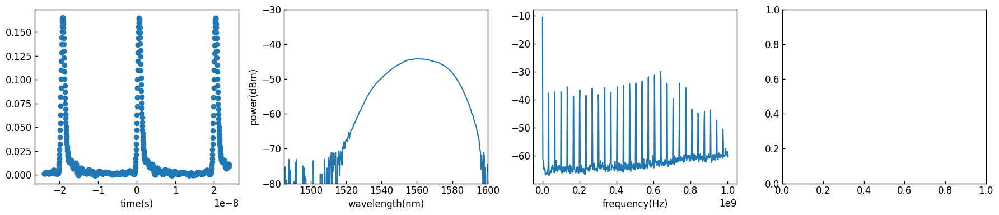

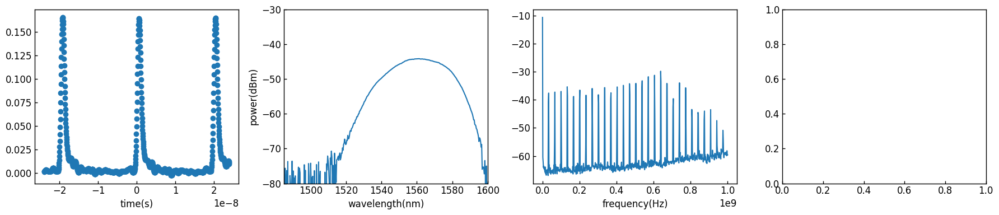

8it [06:09, 46.12s/it]

0.23269420073483013 90


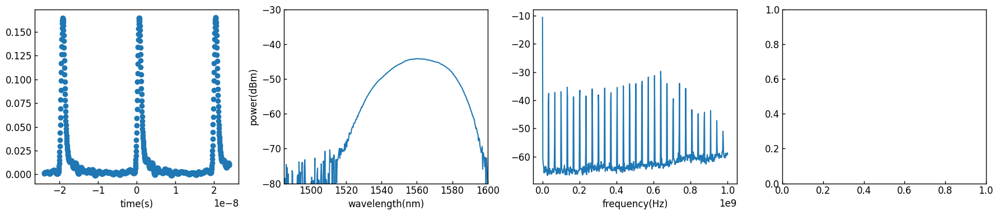

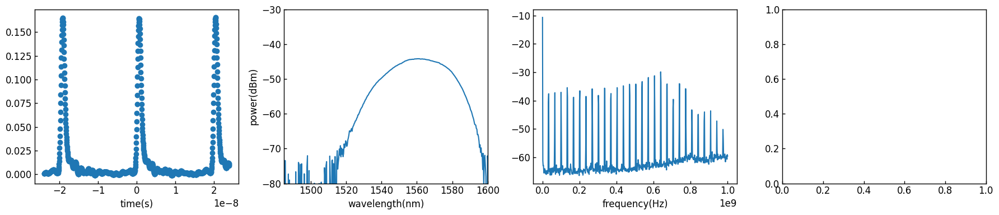

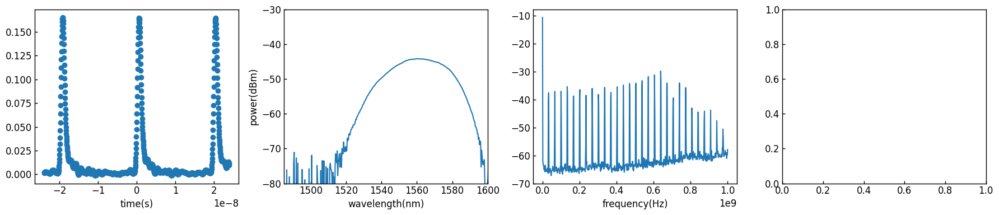

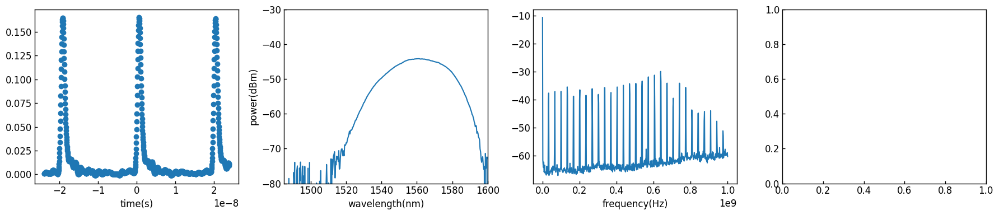

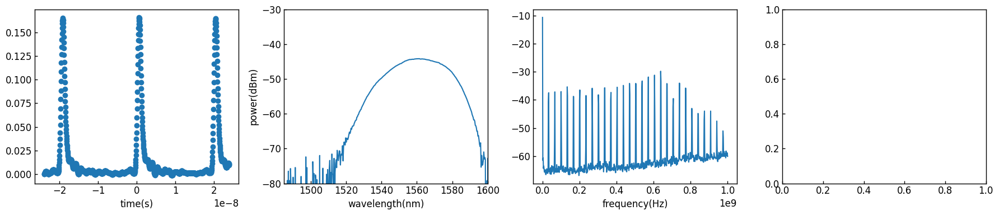

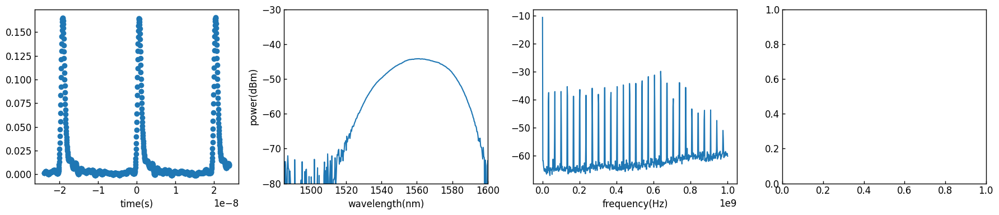

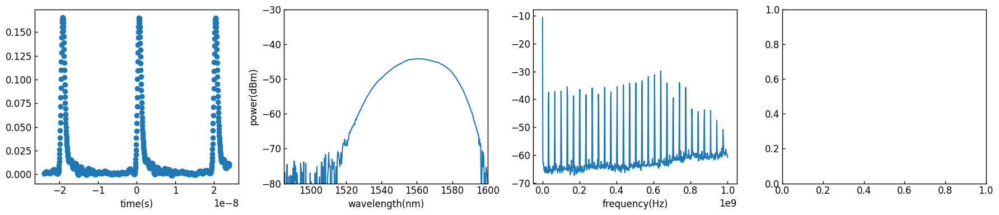

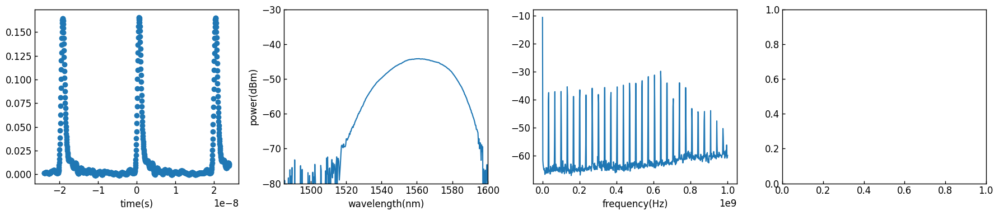

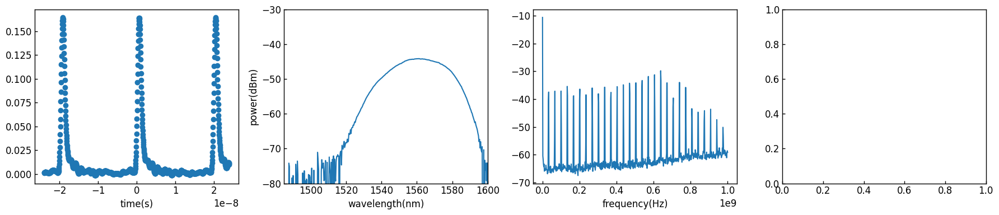

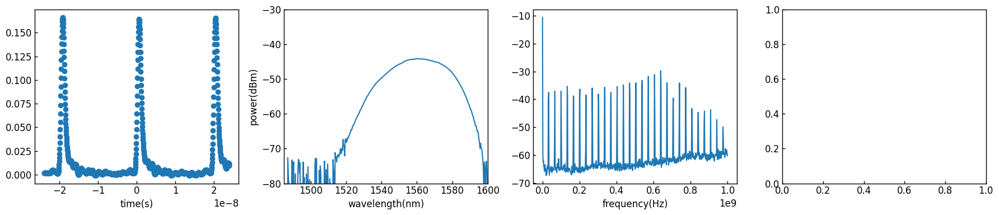

9it [06:56, 46.16s/it]

0.29825992796344114 100


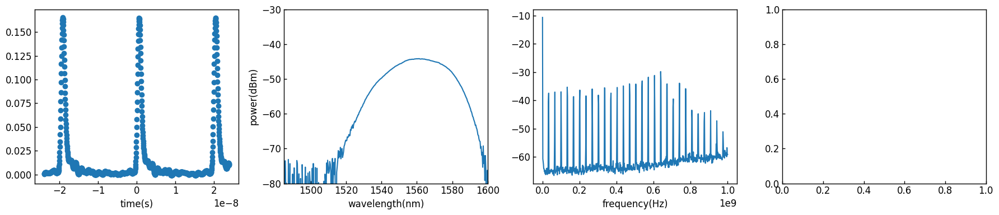

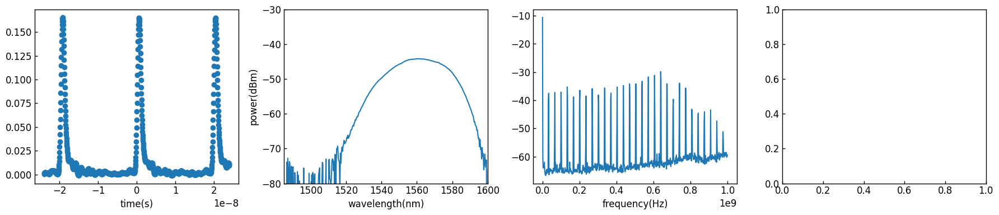

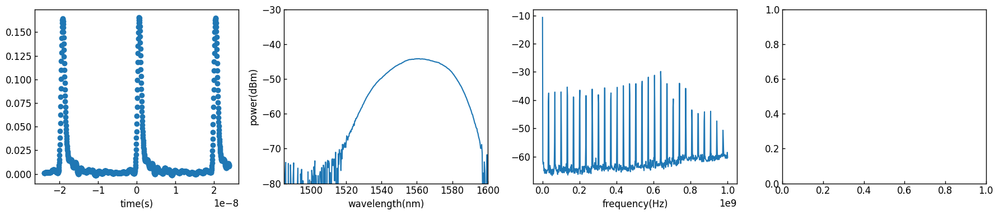

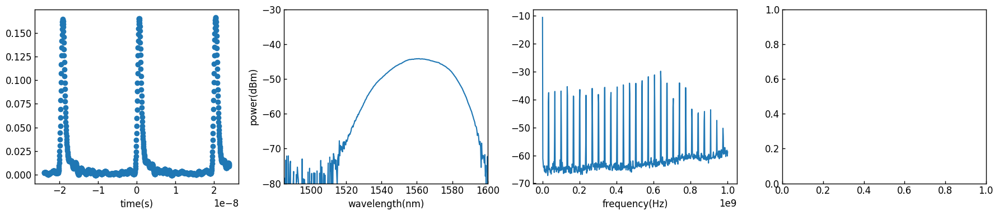

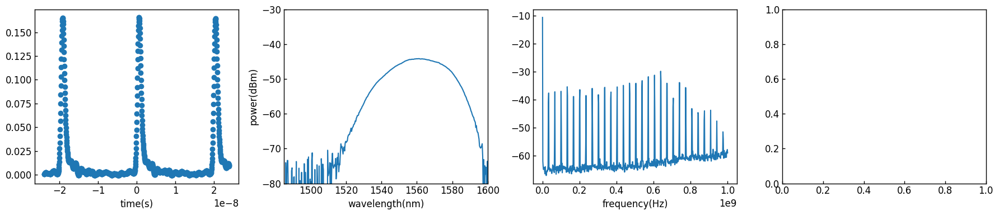

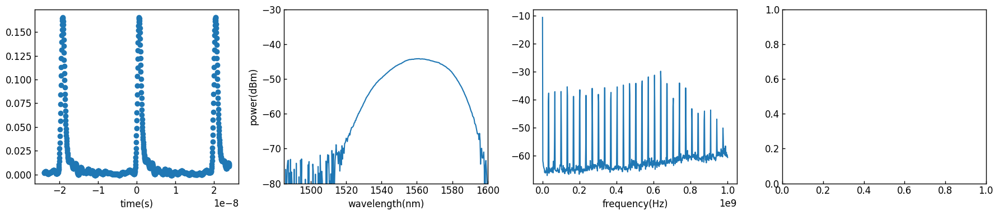

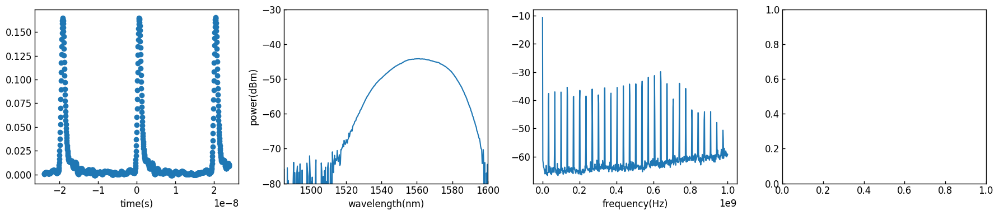

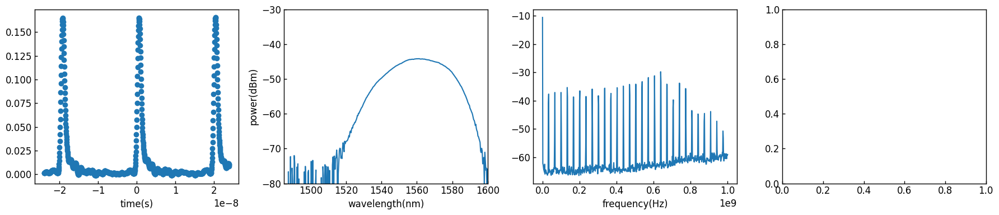

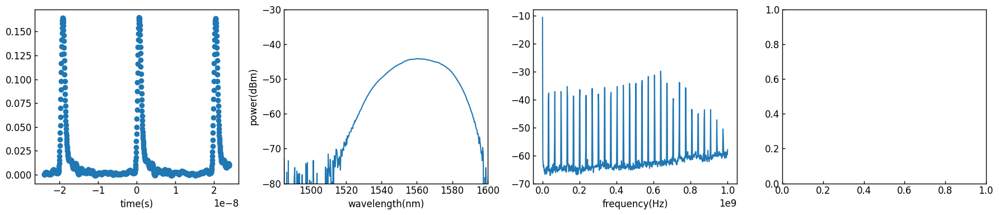

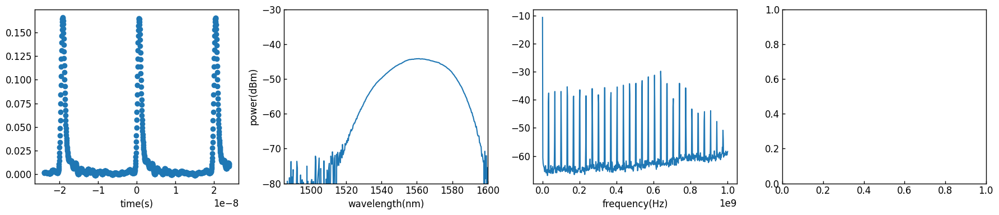

10it [07:42, 46.15s/it]

0.31 110


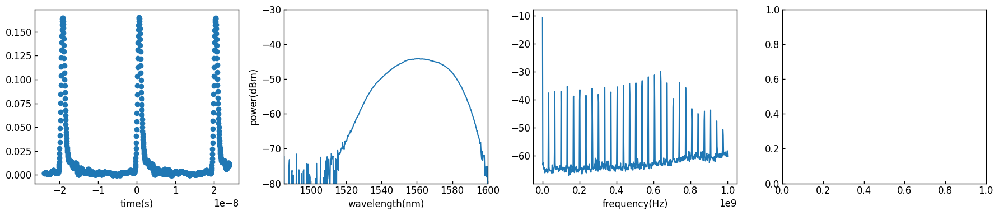

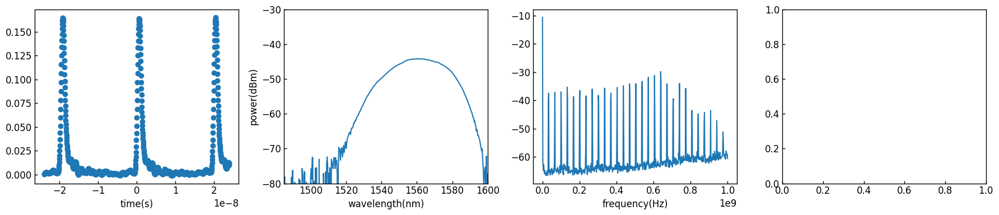

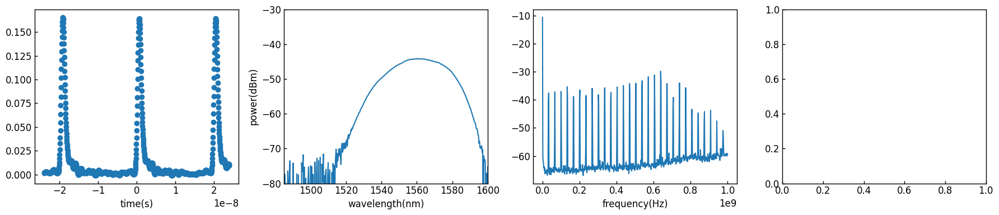

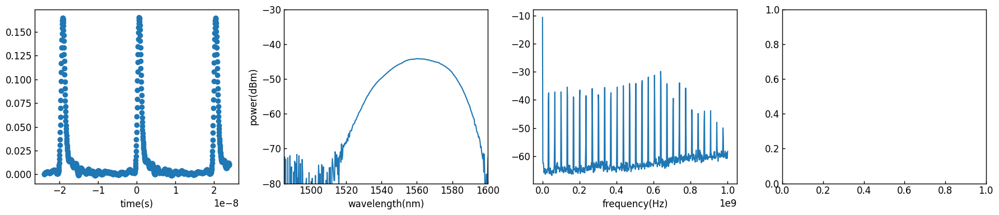

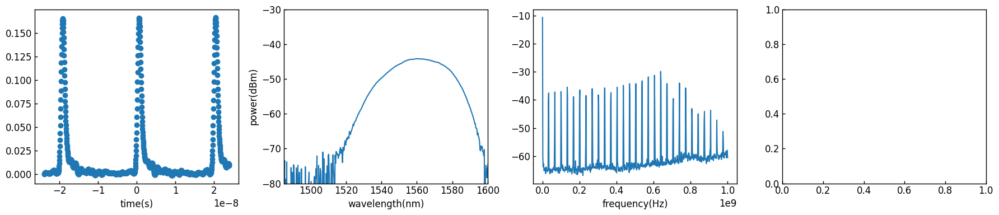

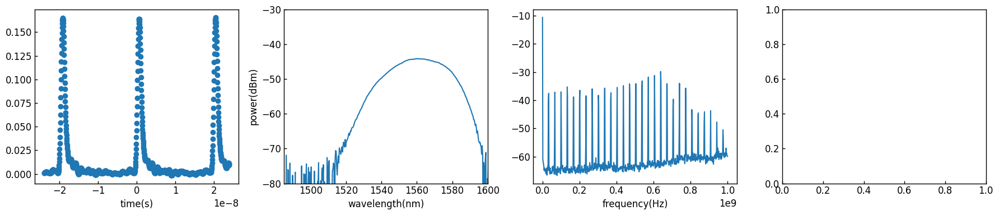

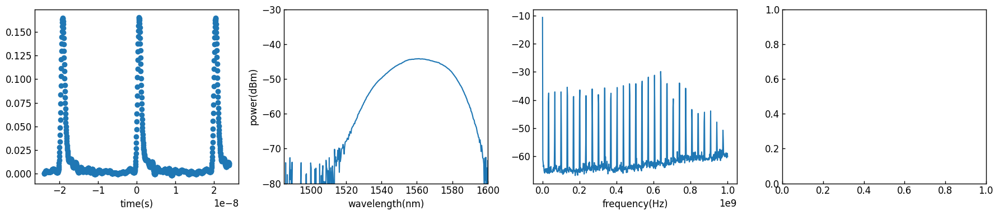

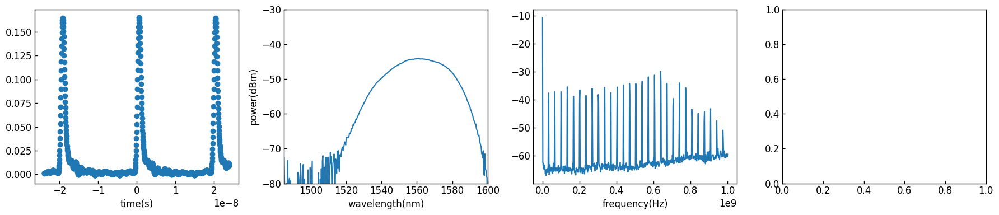

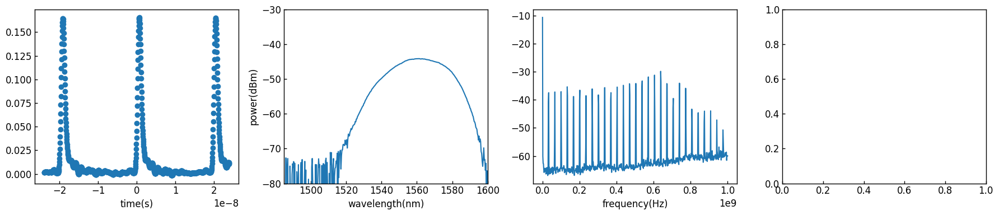

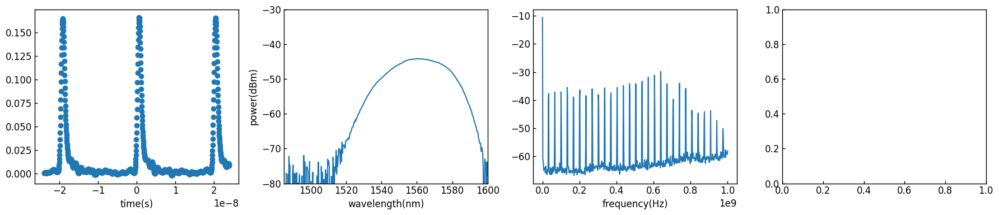

11it [08:28, 46.12s/it]

0.31999999999999995 120


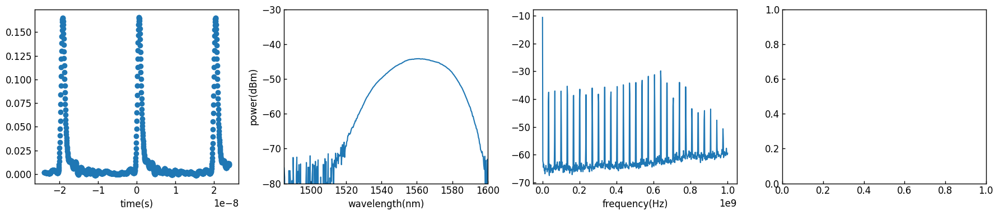

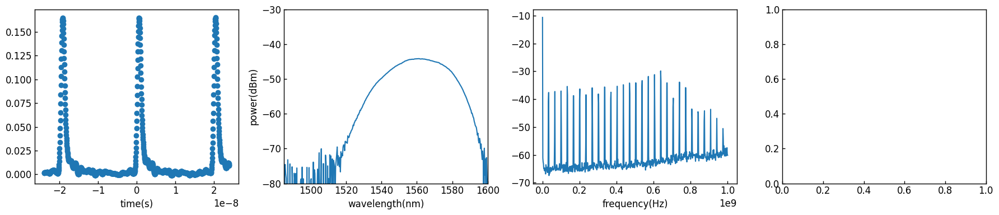

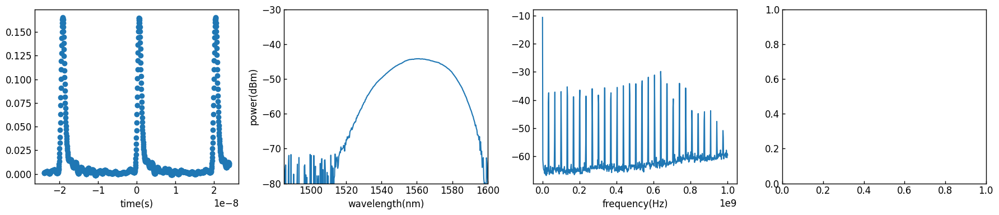

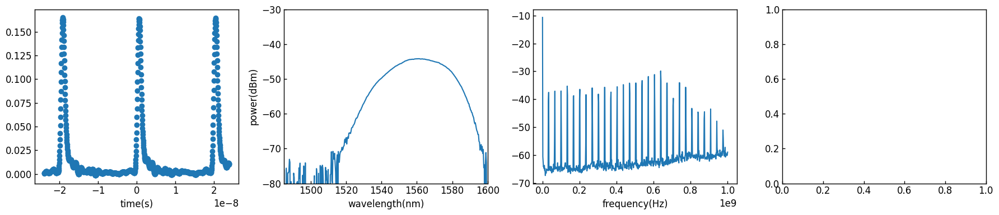

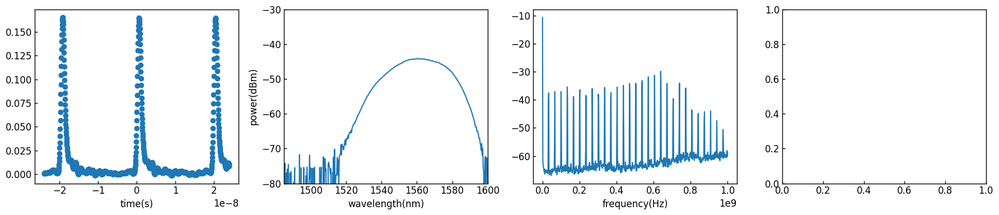

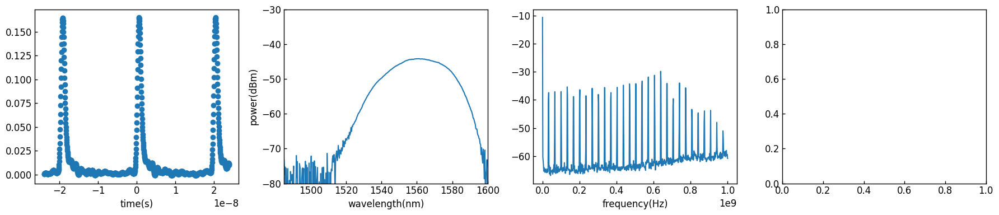

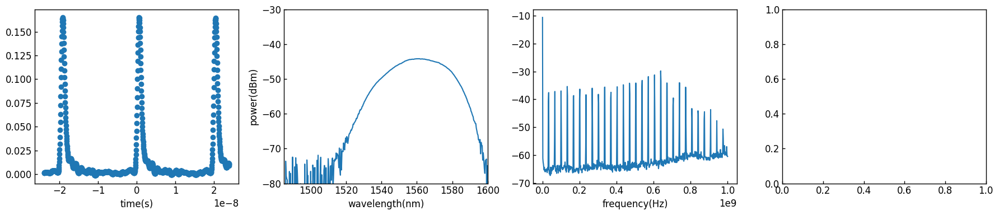

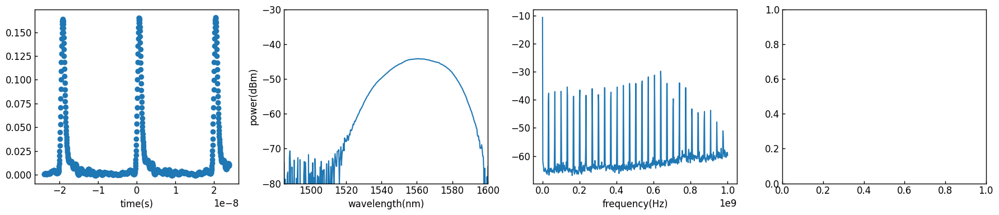

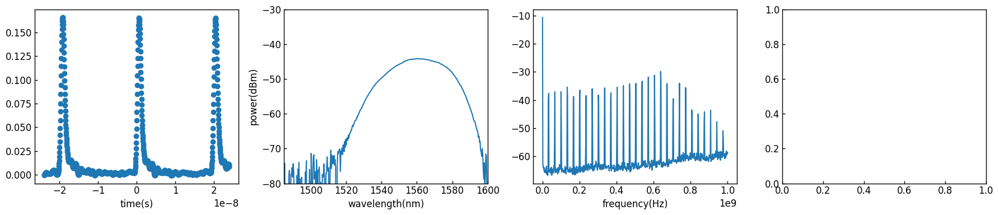

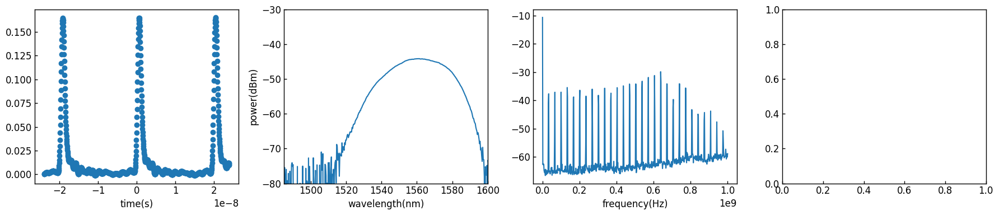

12it [09:14, 46.12s/it]

0.32999999999999996 130


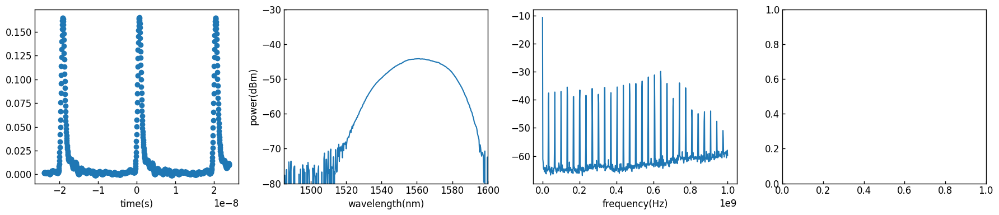

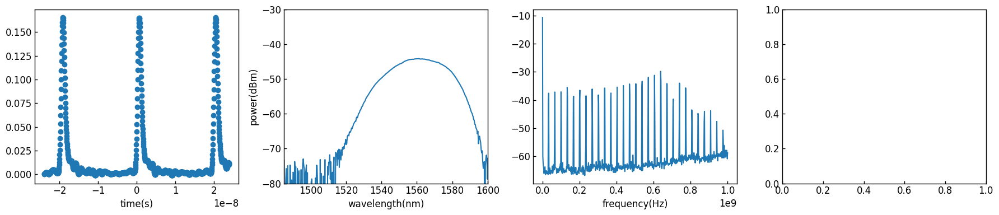

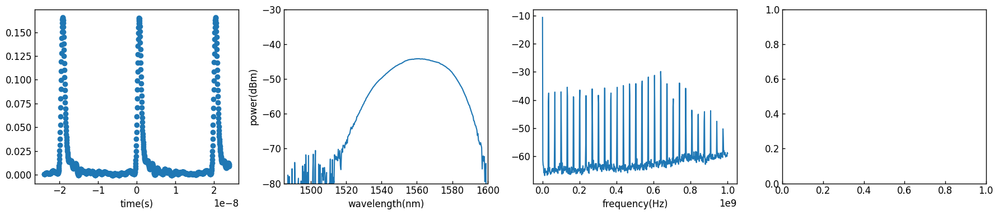

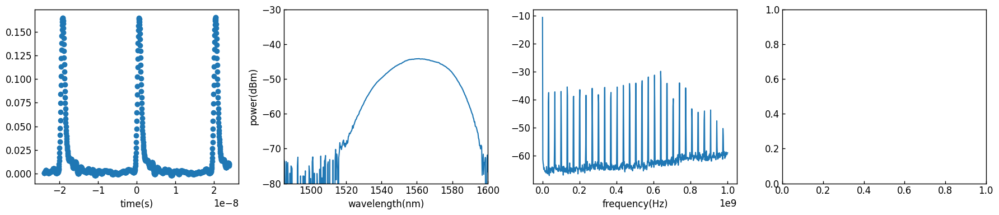

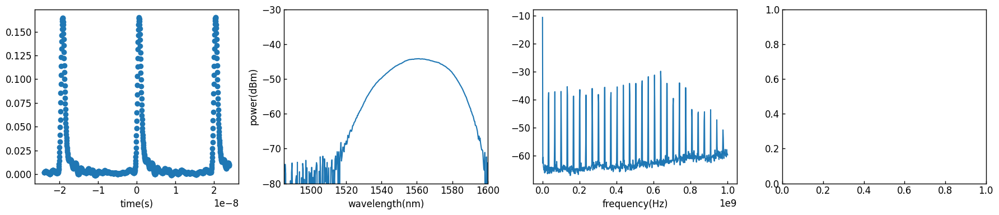

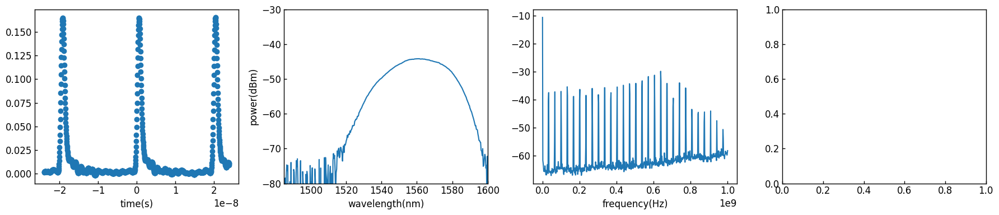

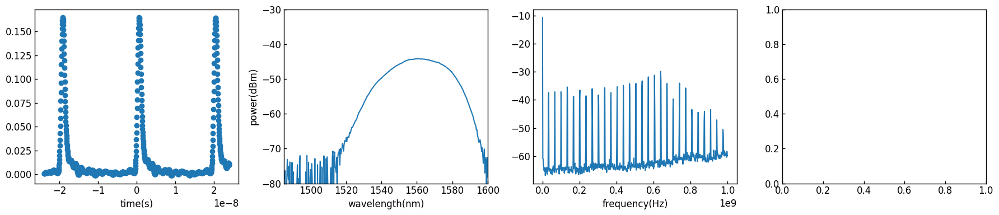

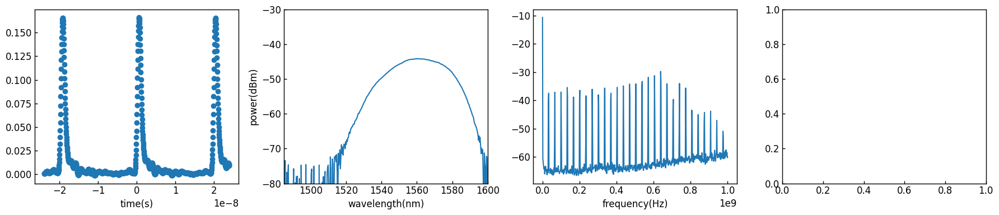

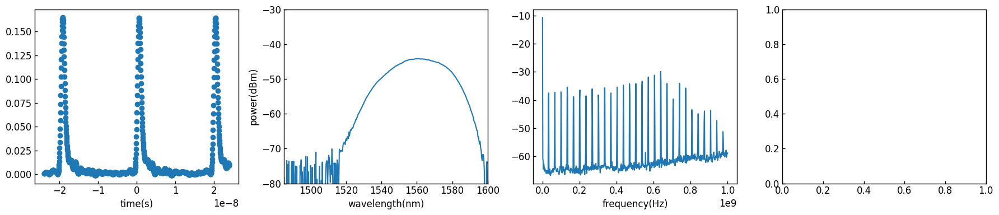

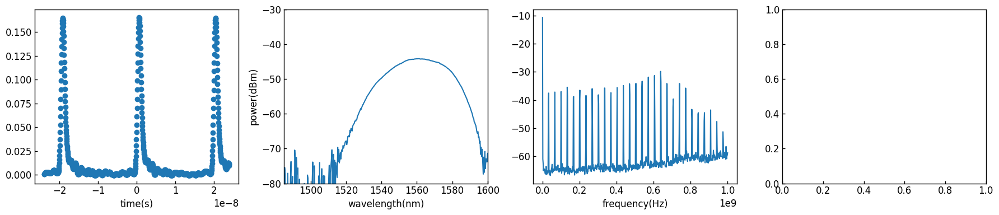

13it [10:00, 45.99s/it]

0.33999999999999997 140


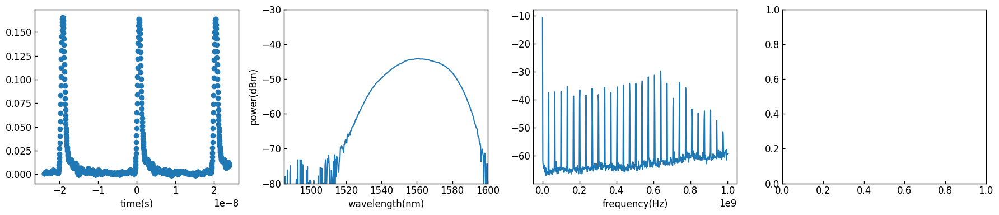

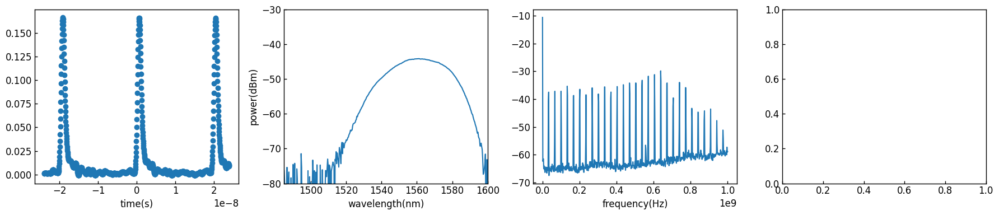

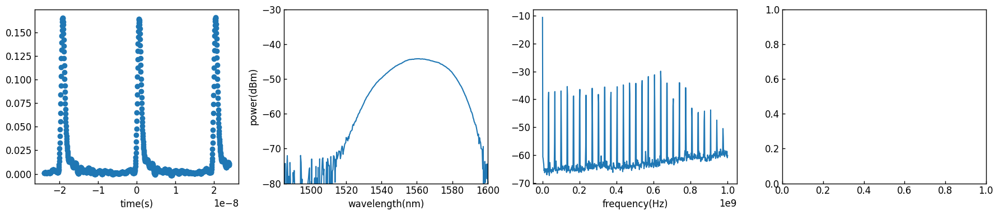

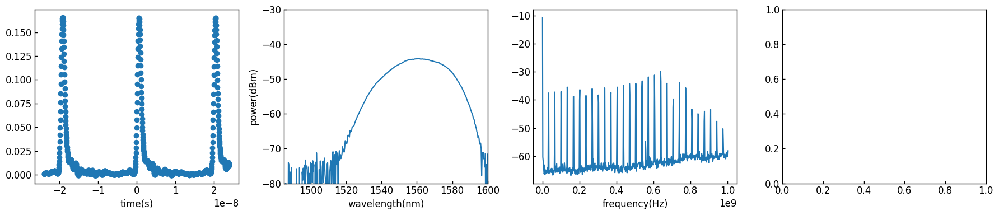

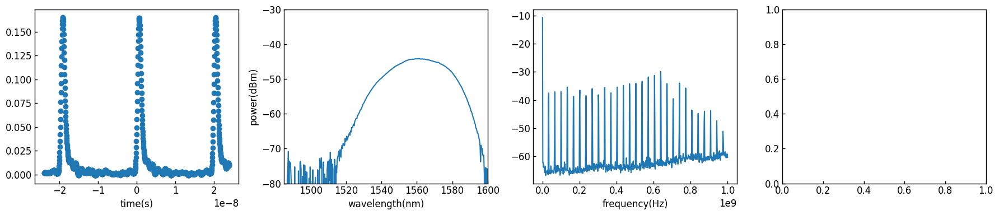

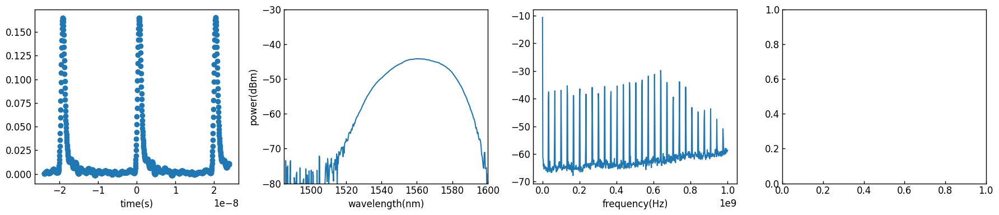

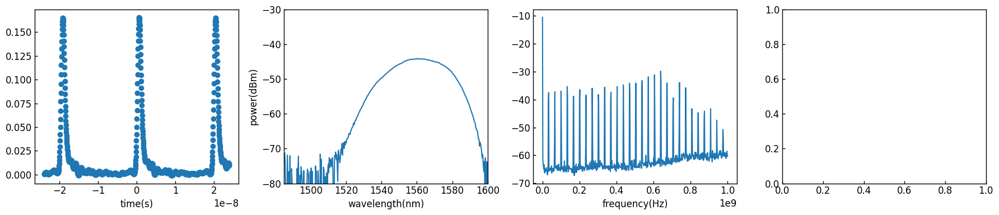

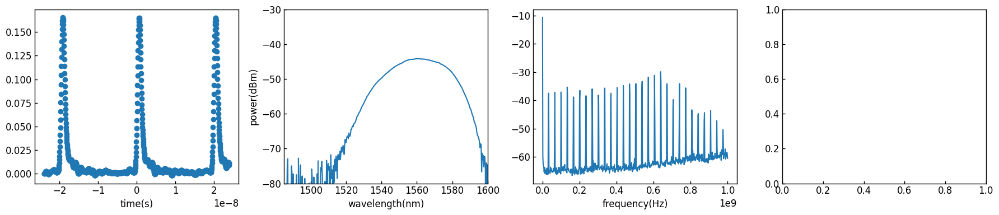

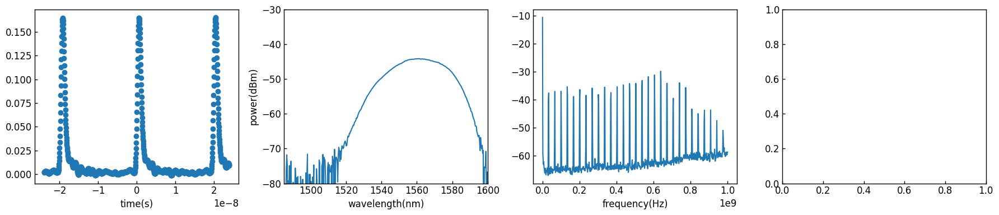

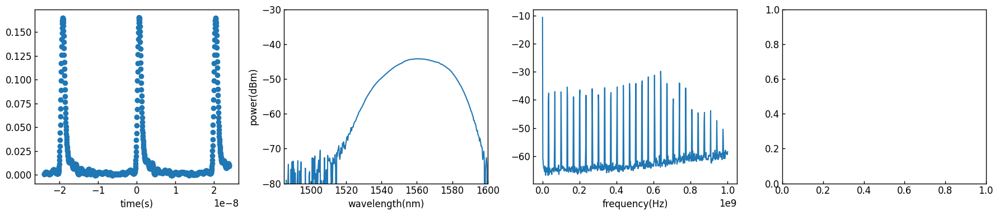

14it [10:46, 45.98s/it]

0.35 150


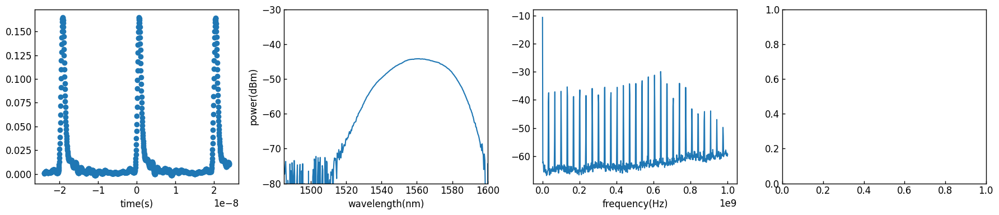

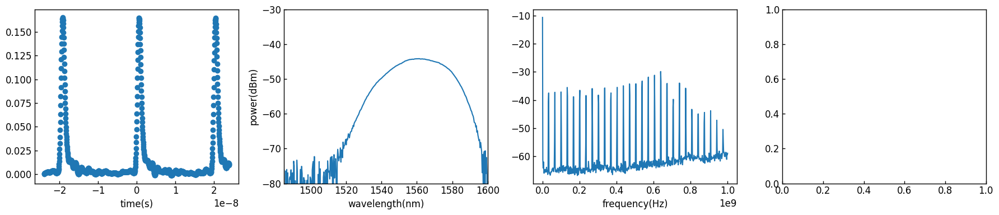

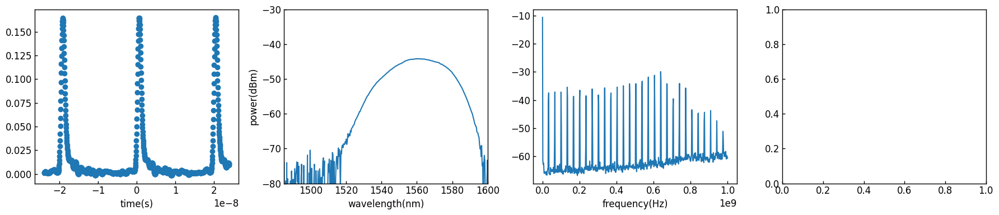

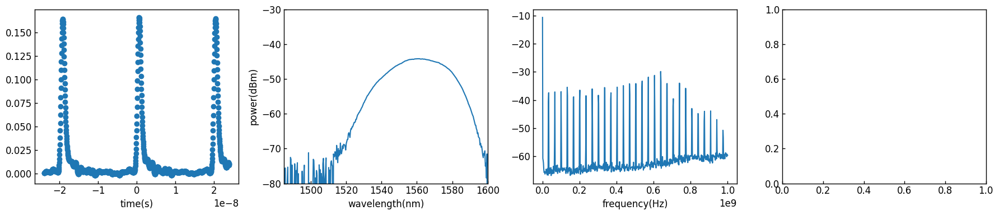

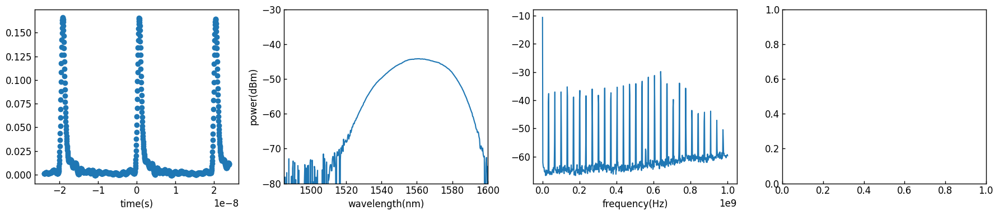

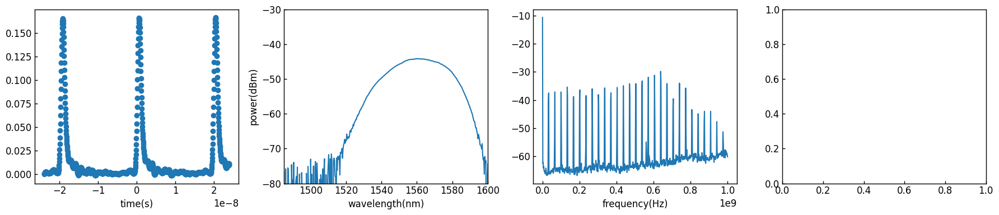

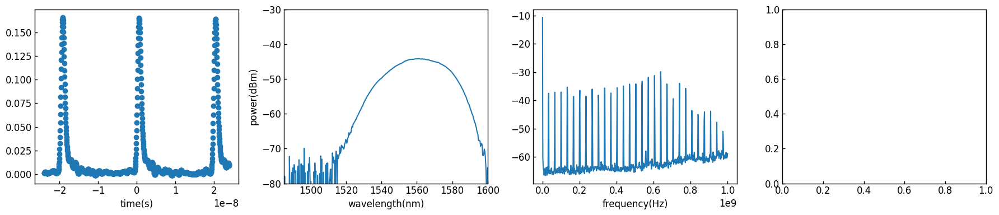

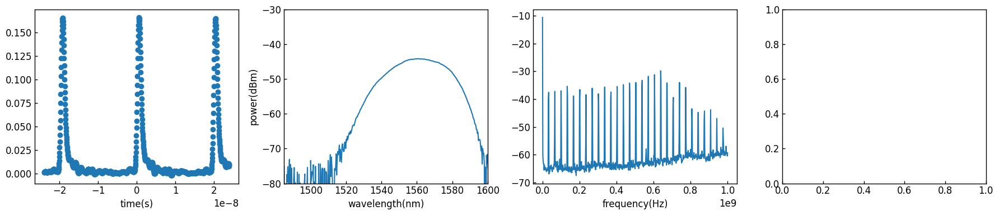

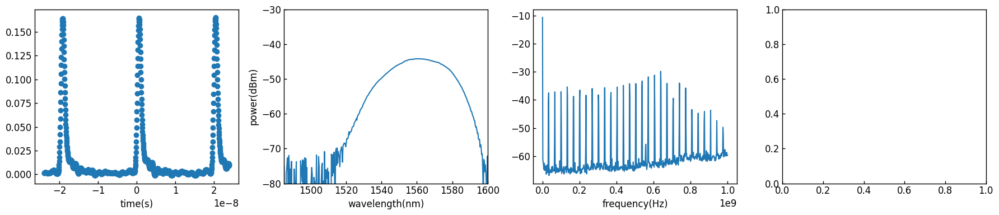

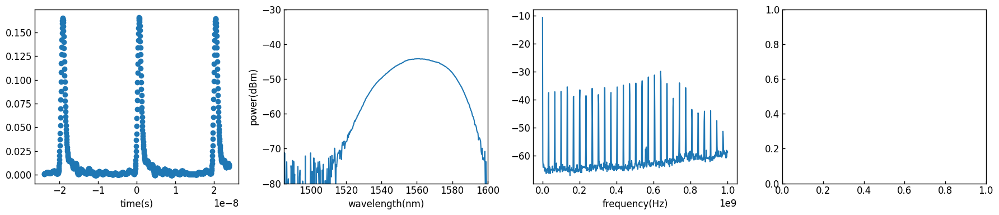

15it [11:32, 46.13s/it]

0.36 160


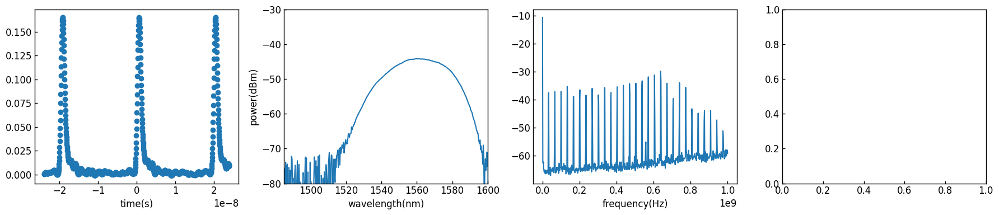

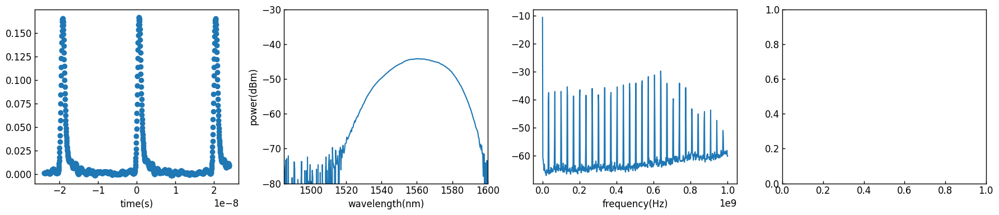

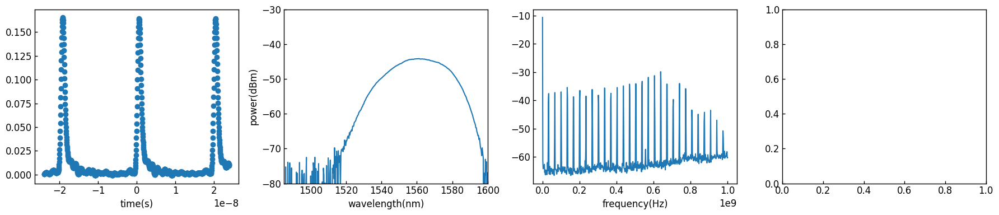

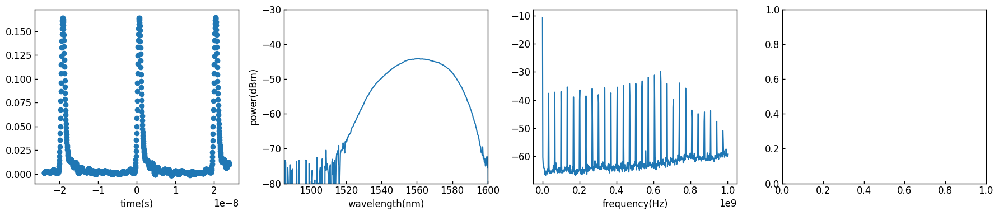

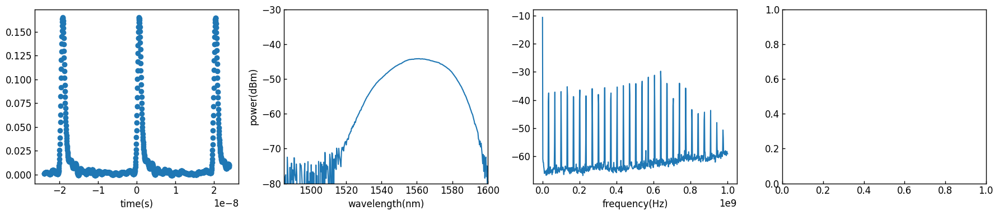

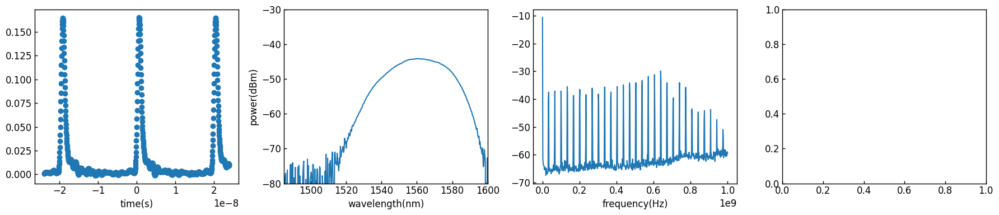

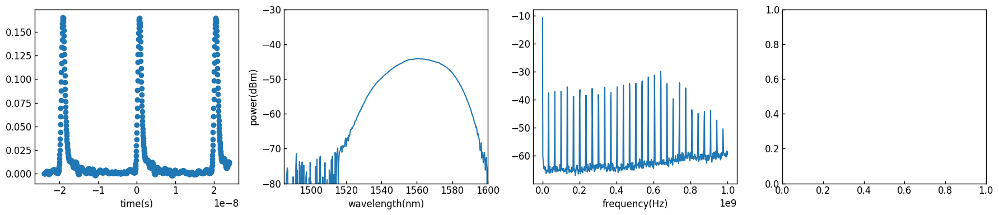

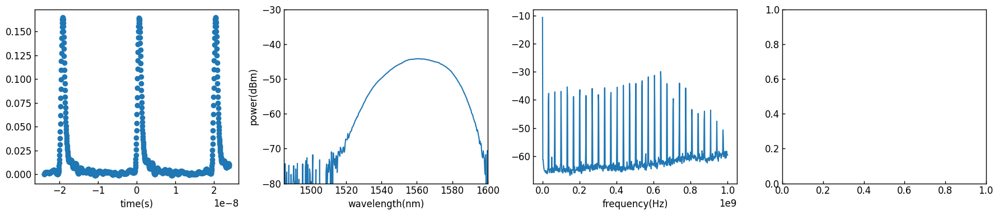

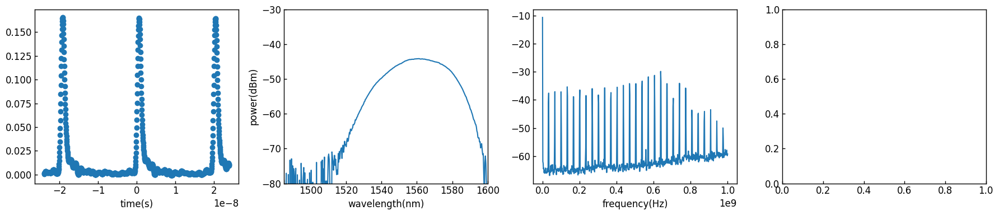

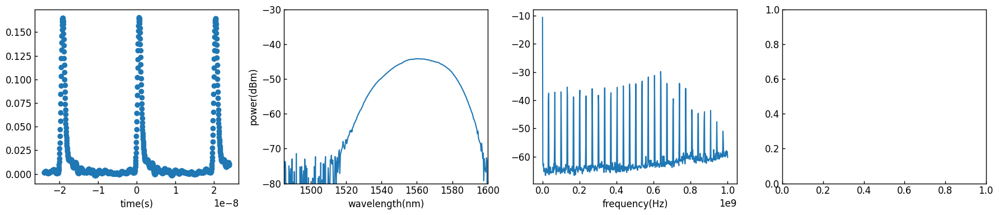

16it [12:19, 46.22s/it]

0.37 170


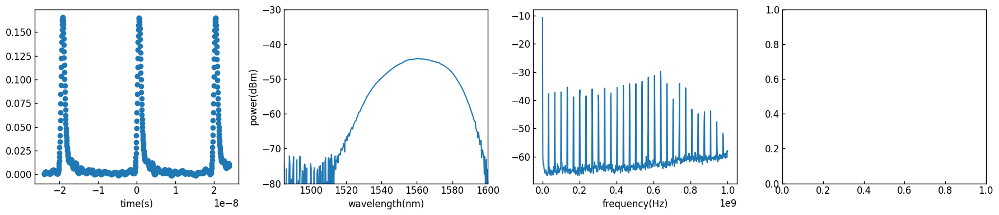

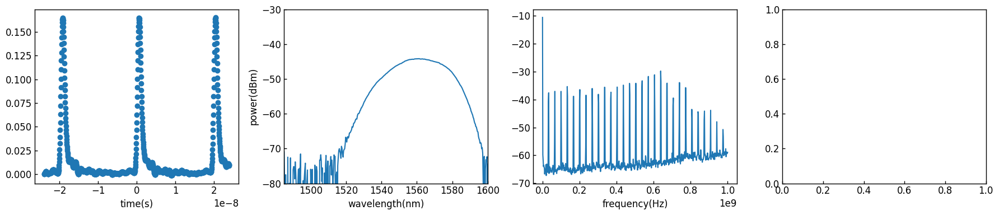

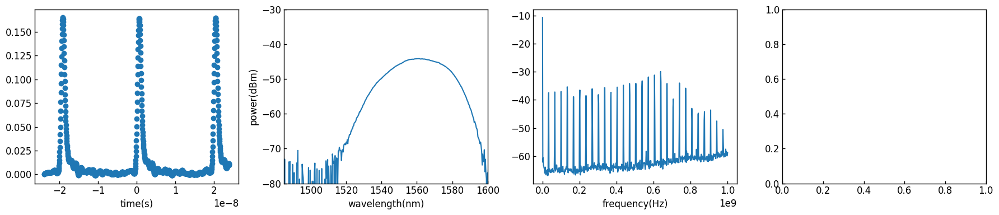

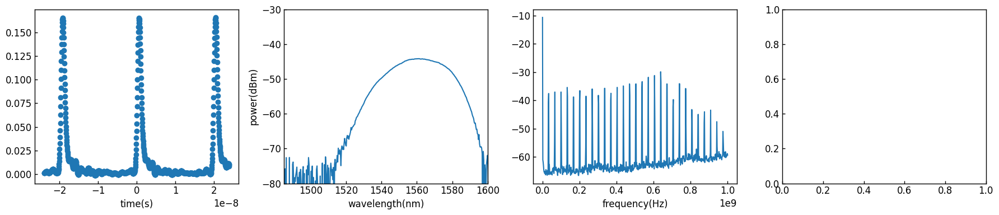

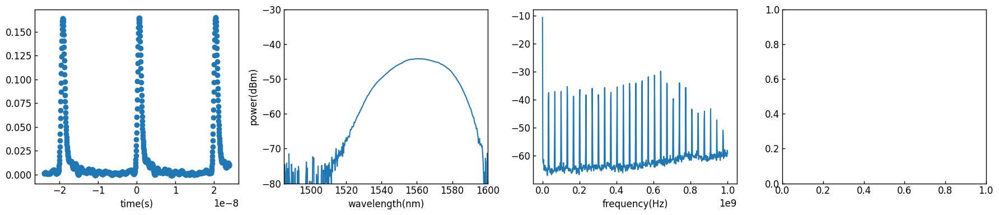

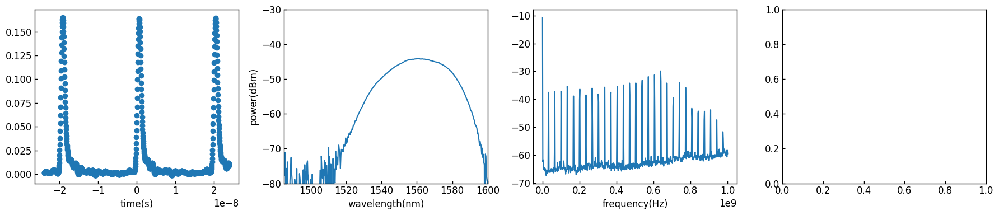

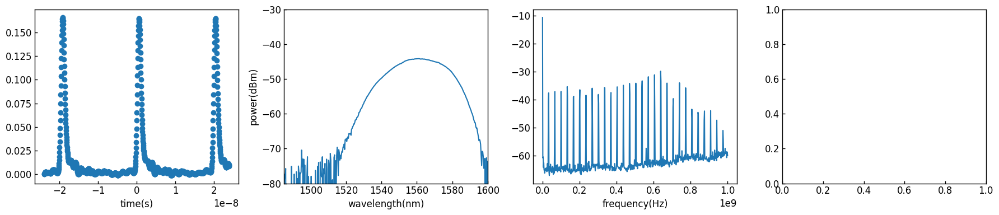

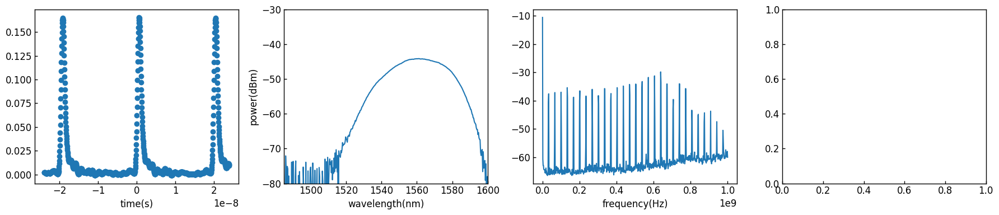

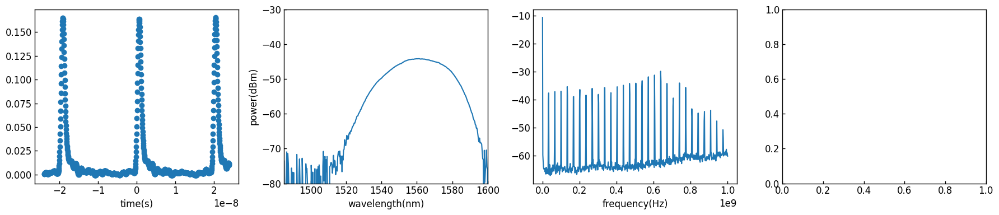

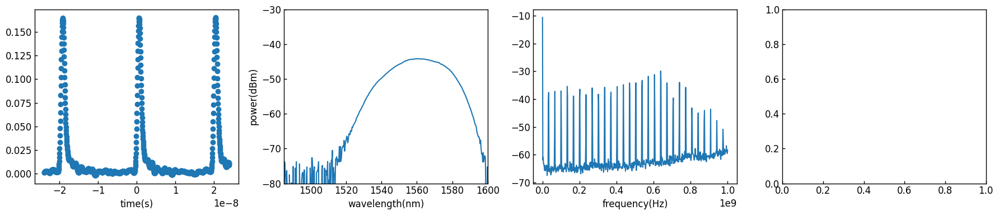

17it [13:05, 46.28s/it]

0.38 180


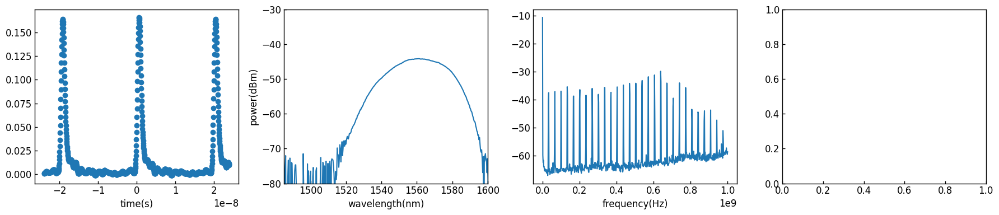

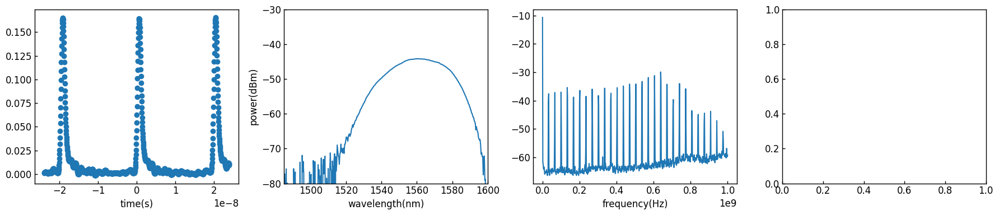

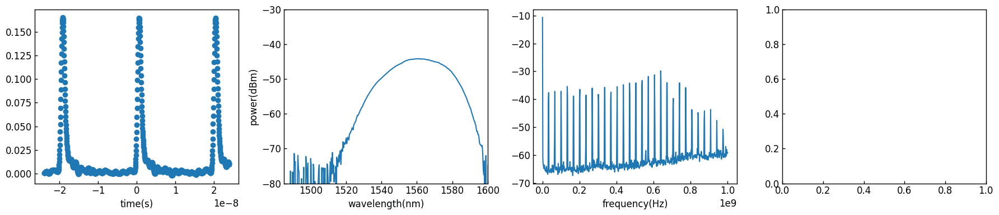

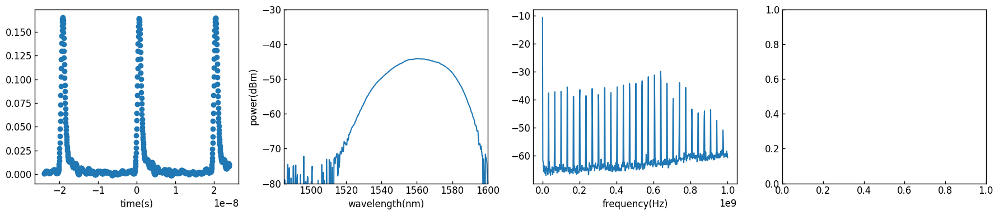

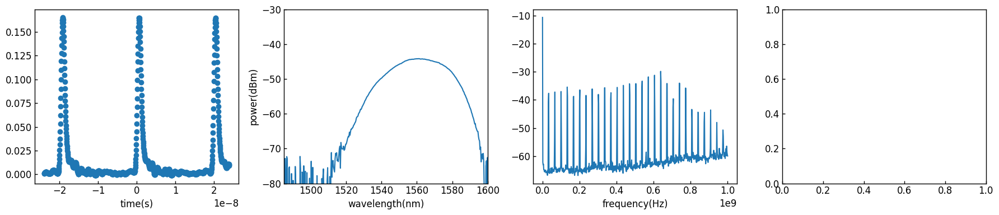

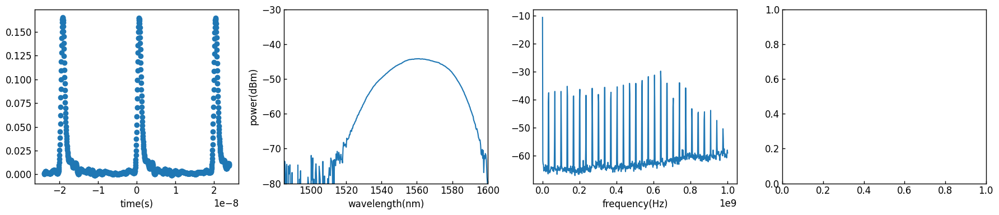

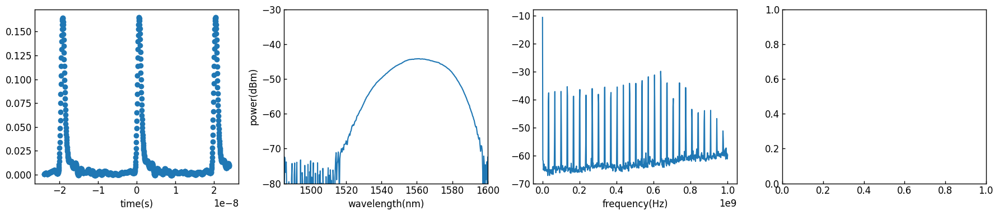

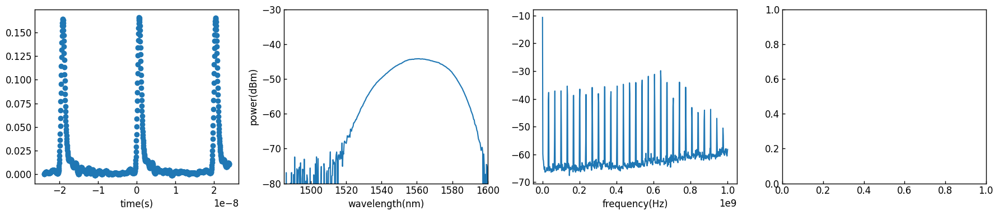

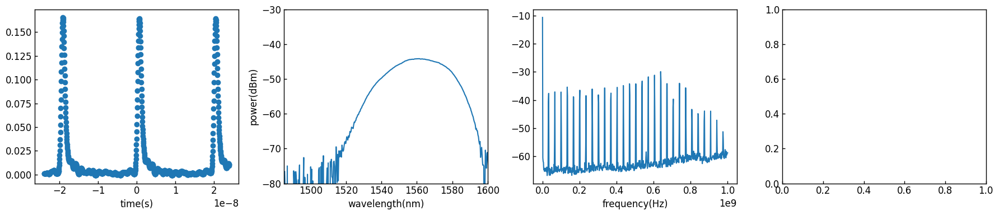

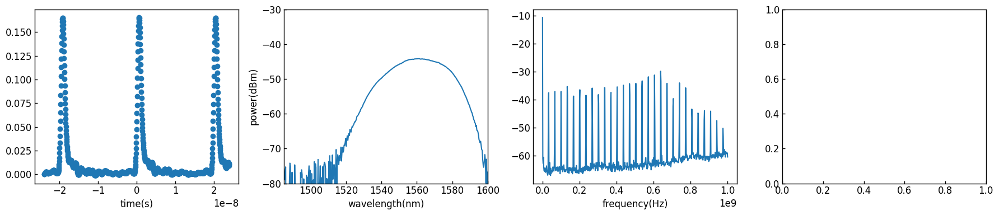

18it [13:51, 46.21s/it]

0.39 190


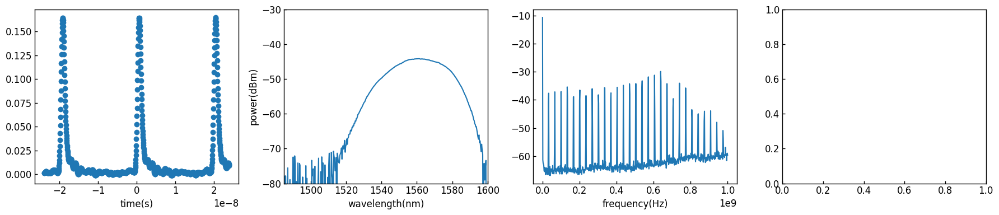

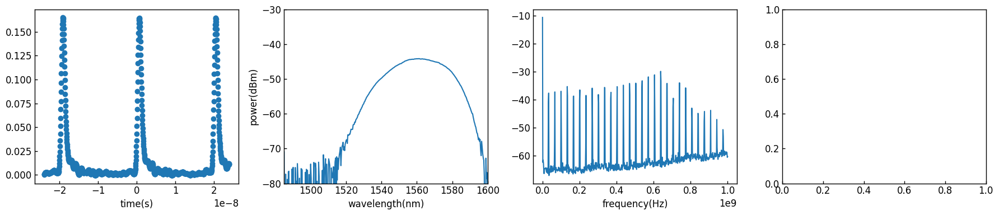

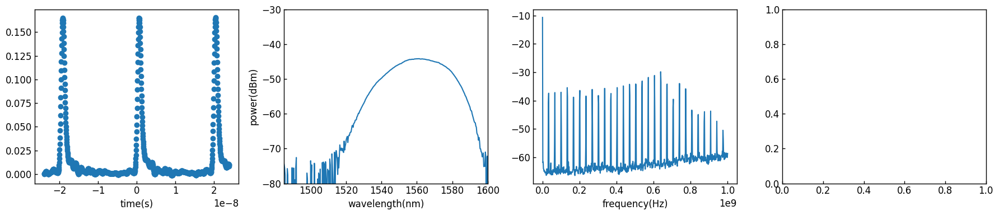

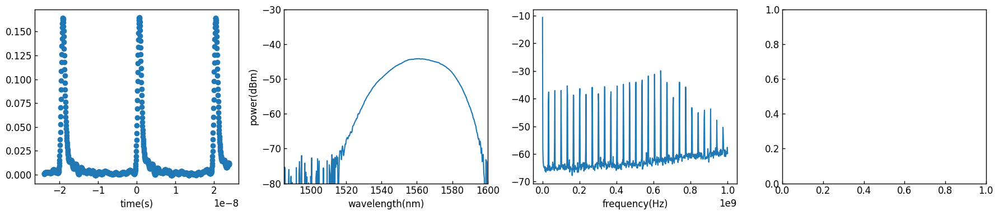

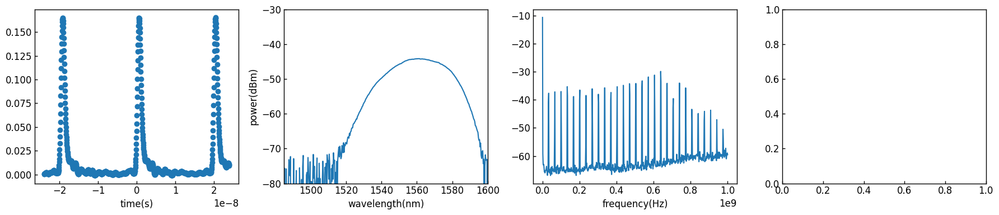

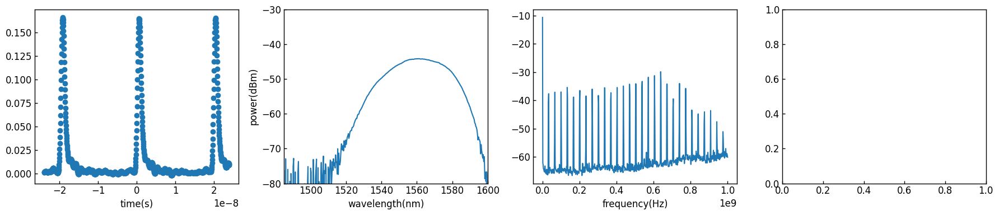

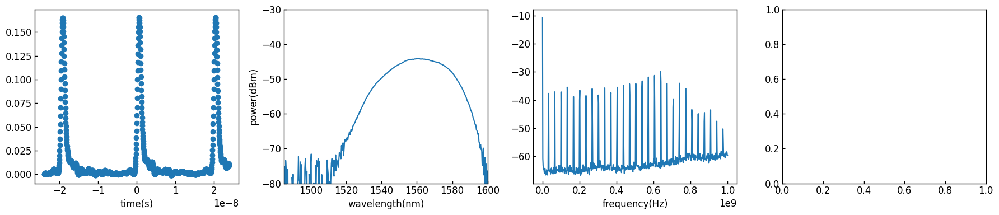

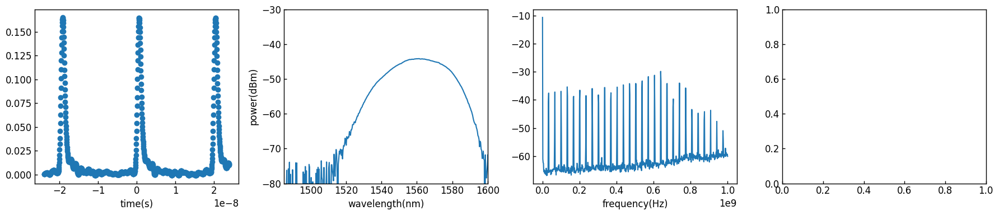

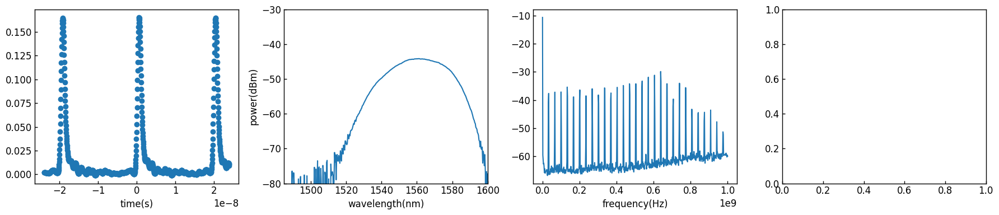

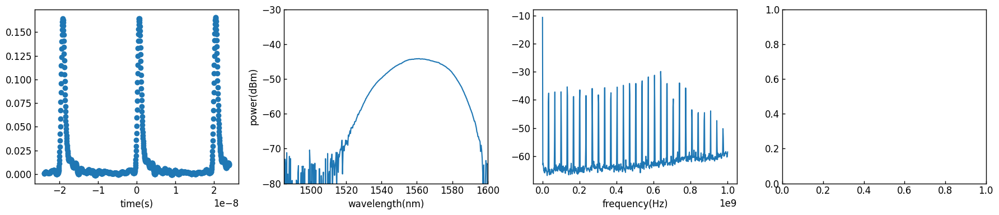

19it [14:37, 46.24s/it]

0.4 200


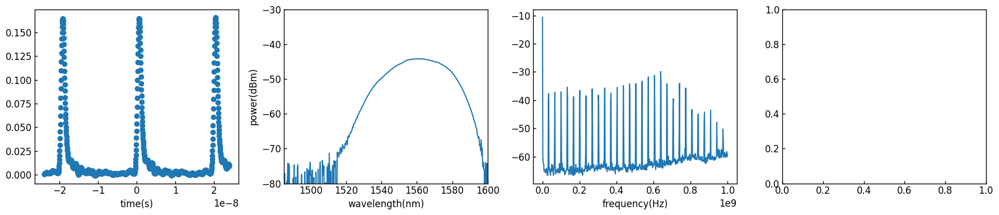

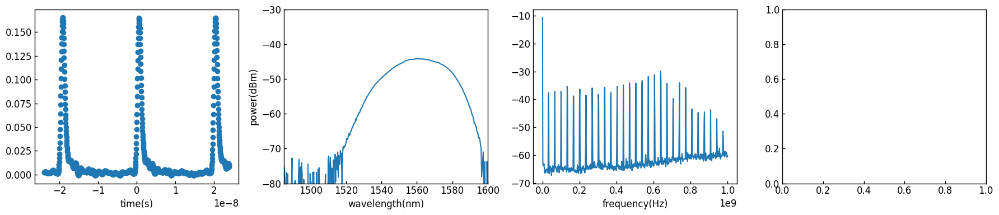

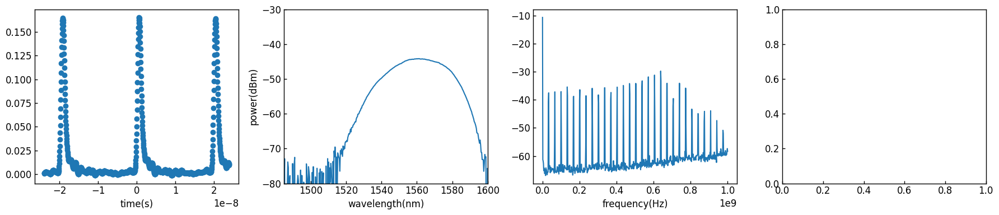

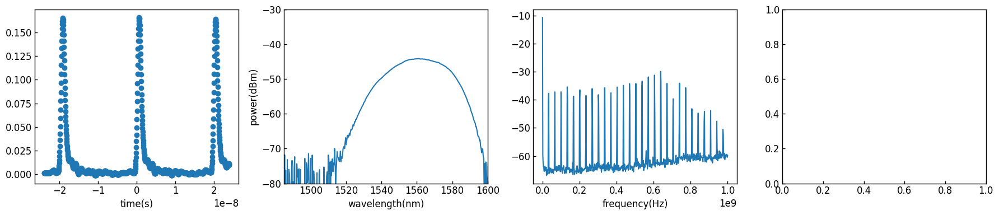

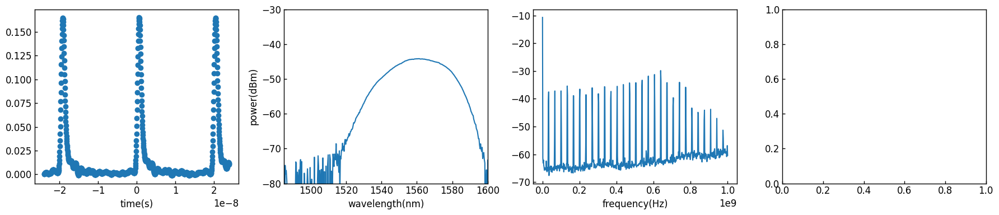

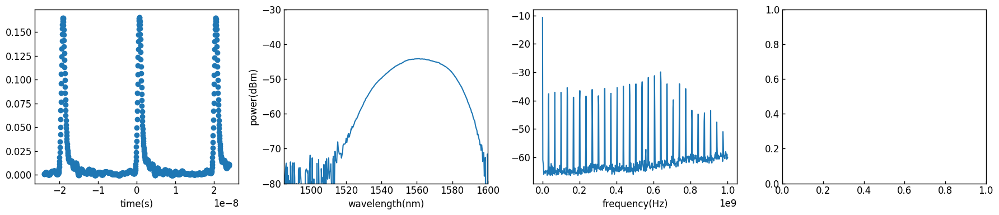

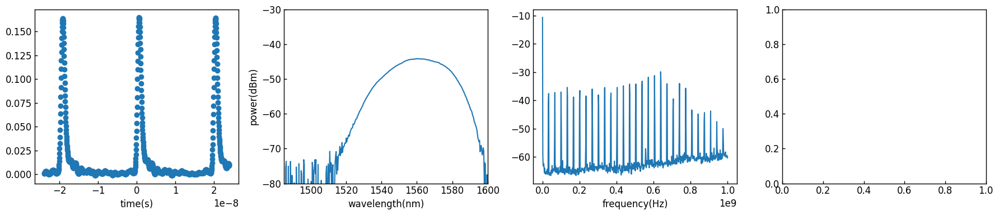

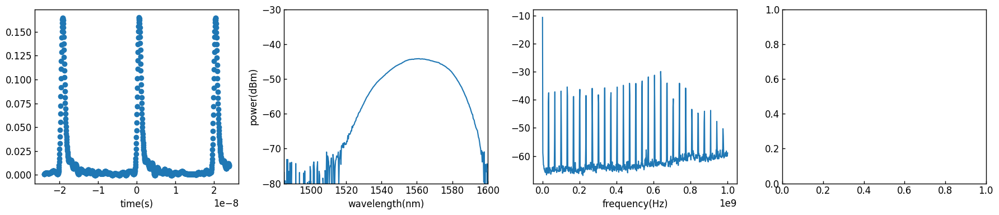

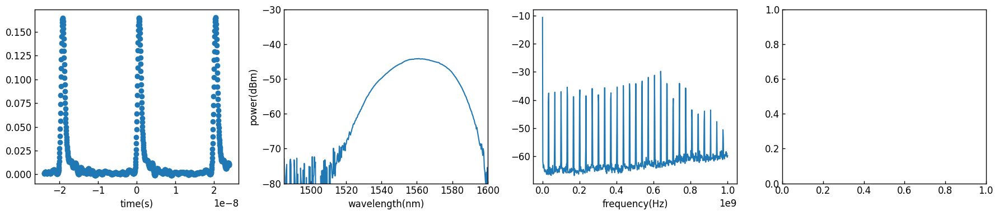

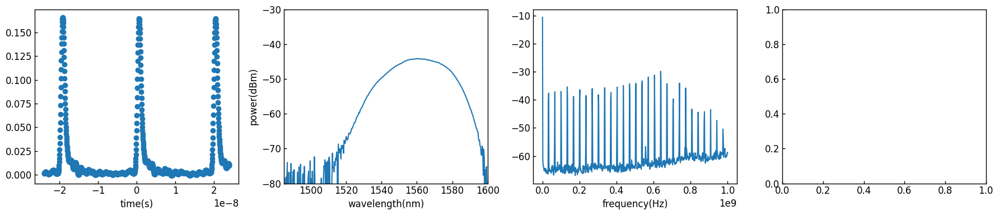

20it [15:24, 46.21s/it]

Wall time: 15min 24s


18

In [ ]:
%%time
Vpp = amp_df["input_amplitude"]
Freq = amp_df.index


data_folder = "force_vibration_vertical1__test_10Hz_interbal"
os.makedirs(data_folder,exist_ok=True)


inst3.write("output:state ON") 
for Vpp_,freq_ in tqdm(zip(Vpp,Freq)):
    pulse_data = pd.DataFrame()
    spec_data = pd.DataFrame()
    rf_data = pd.DataFrame()
    daq_data = pd.DataFrame()
    print(Vpp_,freq_)
    for i in range(10):
        inst3.write("source:volt:immediate:unit VPP")
        inst3.write(f"source:volt:immediate:amplitude {Vpp_}")
    #     inst3.query("source:freq?")
        inst3.write(f"source:freq {freq_}")
        
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        pulse_data = pd.concat([pulse_data,df_LD_auto],axis=1)

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        df_spectrum = pd.DataFrame({f"wavelength(nm)_{i}":wl,f"power(dBm)_{i}":data})
        
        spec_data = pd.concat([spec_data,df_spectrum],axis=1)
    
        time.sleep(0.5)
        rf_power = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
        rf_frequency = np.linspace(10000,1000000000,len(rf_power))
        rf_df = pd.DataFrame({f"freq_{i}":rf_frequency,f"power_{i}":rf_power})
        rf_data = pd.concat([rf_data,rf_df],axis=1)
        
#         DAQ
#         daq_d = []
#         daq_time = []
#         start = time.perf_counter()

#         for i in tqdm(range(100)):
#             with nidaqmx.Task() as photo_p:
#                 photo_p.ai_channels.add_ai_voltage_chan("Dev2/ai1")
#                 data_q = np.append(daq_d,photo_p.read())
#                 daq_time = np.append(daq_time,time.perf_counter()-start)
#                 time.sleep(0.001)
#                 daq = pd.DataFrame({f"time_{i}":daq_time,f"signal_data_{i}":daq_d})
#                 daq_data = pd.concat([daq_data,daq_d],axis=1)

        fig, ax = plt.subplots(1,4,figsize=(18,4))
        ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])
        ax[0].set_xlabel("time(s)")
        
        ax[1].plot(df_spectrum[f"wavelength(nm)_{i}"],df_spectrum[f"power(dBm)_{i}"],label=f"number = {i}")
        ax[1].set_xlabel("wavelength(nm)")
        ax[1].set_ylabel("power(dBm)")
        ax[1].set_xlim(1485,1600)
        ax[1].set_ylim(-80,-30)

        ax[2].plot(rf_df[f"freq_{i}"],rf_df[f"power_{i}"])
        ax[2].set_xlabel("frequency(Hz)")
#         ax[3].plot(daq[f"time_{i}"],daq[f"voltage_{i}"])
#         ax[3].set_xlabel("time")
        plt.tight_layout()
        plt.show()
    pulse_data.to_csv(os.path.join(data_folder,f"pulse_data_{freq_}_Hz.csv"))
    spec_data.to_csv(os.path.join(data_folder,f"spec_data_{freq_}_Hz.csv"))
    rf_data.to_csv(os.path.join(data_folder,f"rf_data_{freq_}_Hz.csv"))
#     daq_data.to_csv(os.path.join(data_folder,f"daq_data_{freq_}_Hz.csv"))
inst3.write("output:state OFF")

0it [00:00, ?it/s]

0.12588333216799036 70


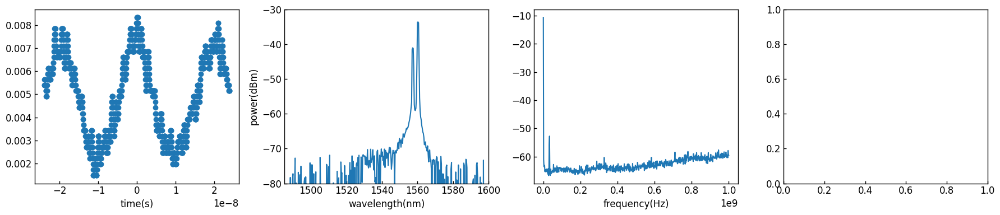

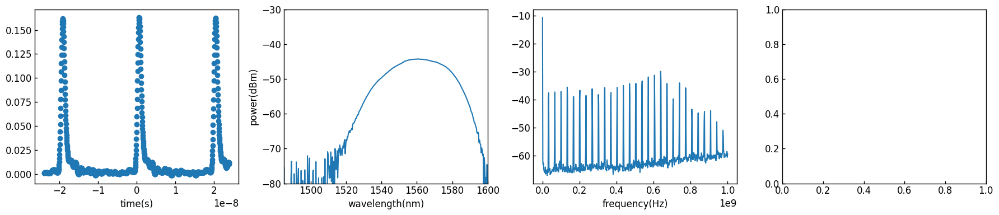

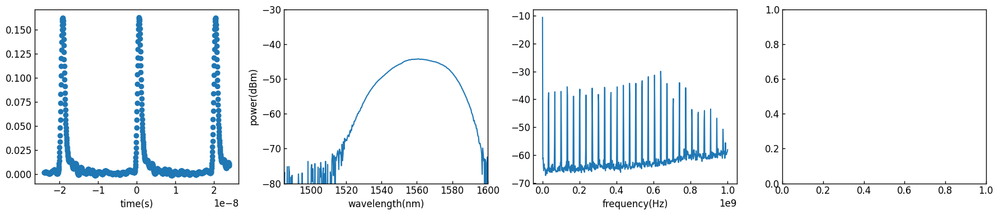

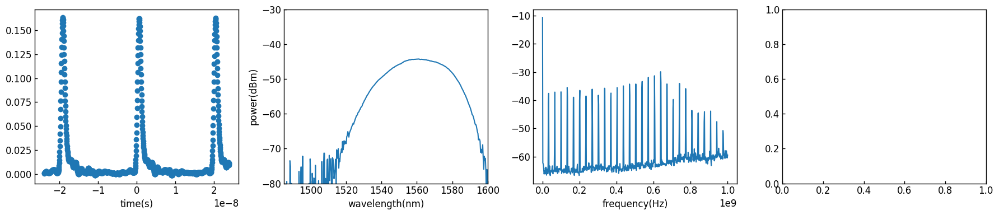

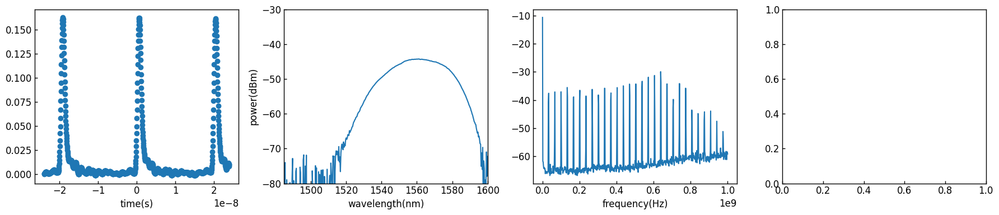

1it [01:19, 79.57s/it]

0.31 110


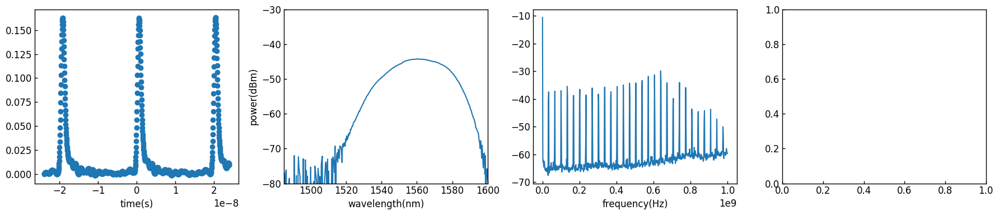

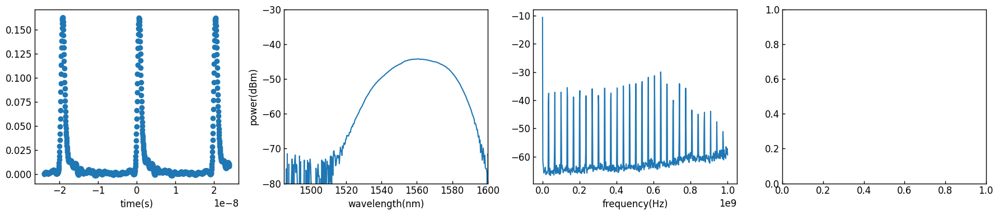

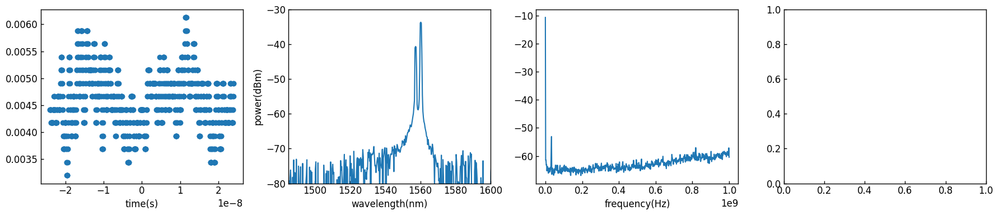

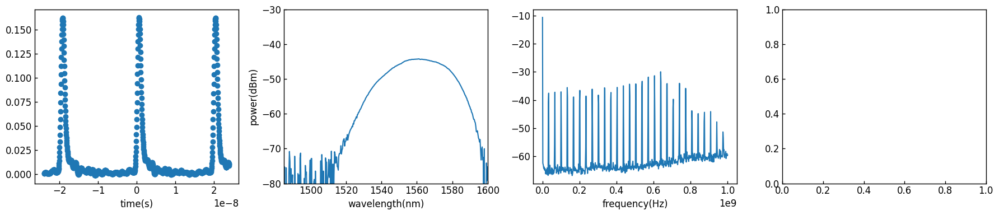

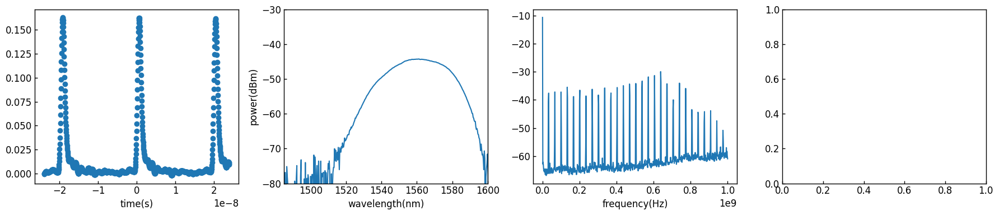

2it [02:40, 80.01s/it]

Wall time: 2min 40s


18

In [ ]:
%%time
Vpp = amp_df["input_amplitude"]
Freq = amp_df.index


data_folder = "force_vibration_vertical2__test_70Hz&110Hz"
os.makedirs(data_folder,exist_ok=True)


inst3.write("output:state ON") 
for Vpp_,freq_ in tqdm(zip(Vpp,Freq)):
    pulse_data = pd.DataFrame()
    spec_data = pd.DataFrame()
    rf_data = pd.DataFrame()
    daq_data = pd.DataFrame()
    print(Vpp_,freq_)
    for i in range(5):
        mode_locked_automation(LD_voltage)
        inst3.write("source:volt:immediate:unit VPP")
        inst3.write(f"source:volt:immediate:amplitude {Vpp_}")
    #     inst3.query("source:freq?")
        inst3.write(f"source:freq {freq_}")
        
        inst2.write("srt")# SSI single meas/SRT repeat
        inst1.write("sing")
        inst1.query("*opc?")
        data_header = inst1.query("chan:data:head?")
        rohde_data = inst1.query("chan:data?")
        rohde_data = [float(i) for i in rohde_data.split(",")]
        time_setting = [float(i) for i in data_header.split(",")]
        time_data = np.linspace(time_setting[0],time_setting[1],num=int(time_setting[2]))
        df_LD_auto = pd.DataFrame({f"time_{i}":time_data,f"voltage_{i}":rohde_data})
        pulse_data = pd.concat([pulse_data,df_LD_auto],axis=1)

        inst2.write("DMA?")
        data = [float(inst2.read()) for i in range(501)]
        wavelength = [float(i) for i in inst2.query("DCA?").split(",")]
        wl = np.linspace(wavelength[0],wavelength[1],int(wavelength[2]))
        df_spectrum = pd.DataFrame({f"wavelength(nm)_{i}":wl,f"power(dBm)_{i}":data})
        
        spec_data = pd.concat([spec_data,df_spectrum],axis=1)
    
        time.sleep(0.5)
        rf_power = [float(i) for i in inst4.query("trace:data? trace1").replace("#9000009014 ","").split(",")]
        rf_frequency = np.linspace(10000,1000000000,len(rf_power))
        rf_df = pd.DataFrame({f"freq_{i}":rf_frequency,f"power_{i}":rf_power})
        rf_data = pd.concat([rf_data,rf_df],axis=1)
        
#         DAQ
#         daq_d = []
#         daq_time = []
#         start = time.perf_counter()

#         for i in tqdm(range(100)):
#             with nidaqmx.Task() as photo_p:
#                 photo_p.ai_channels.add_ai_voltage_chan("Dev2/ai1")
#                 data_q = np.append(daq_d,photo_p.read())
#                 daq_time = np.append(daq_time,time.perf_counter()-start)
#                 time.sleep(0.001)
#                 daq = pd.DataFrame({f"time_{i}":daq_time,f"signal_data_{i}":daq_d})
#                 daq_data = pd.concat([daq_data,daq_d],axis=1)

        fig, ax = plt.subplots(1,4,figsize=(18,4))
        ax[0].scatter(df_LD_auto[f"time_{i}"],df_LD_auto[f"voltage_{i}"])
        ax[0].set_xlabel("time(s)")
        
        ax[1].plot(df_spectrum[f"wavelength(nm)_{i}"],df_spectrum[f"power(dBm)_{i}"],label=f"number = {i}")
        ax[1].set_xlabel("wavelength(nm)")
        ax[1].set_ylabel("power(dBm)")
        ax[1].set_xlim(1485,1600)
        ax[1].set_ylim(-80,-30)

        ax[2].plot(rf_df[f"freq_{i}"],rf_df[f"power_{i}"])
        ax[2].set_xlabel("frequency(Hz)")
#         ax[3].plot(daq[f"time_{i}"],daq[f"voltage_{i}"])
#         ax[3].set_xlabel("time")
        plt.tight_layout()
        plt.show()
    pulse_data.to_csv(os.path.join(data_folder,f"pulse_data_{freq_}_Hz.csv"))
    spec_data.to_csv(os.path.join(data_folder,f"spec_data_{freq_}_Hz.csv"))
    rf_data.to_csv(os.path.join(data_folder,f"rf_data_{freq_}_Hz.csv"))
#     daq_data.to_csv(os.path.join(data_folder,f"daq_data_{freq_}_Hz.csv"))
inst3.write("output:state OFF")